# Library

In [1]:
import time
import datetime
from datetime import datetime, timedelta

import re
import gc

import json

import warnings
warnings.simplefilter(action='ignore')

import pandas as pd
import numpy as np
import sys
import string

%matplotlib inline
import matplotlib.pyplot as plt

import random 
from random import sample

import collections
import statistics as s

rus_mon_dict = {'янв': '01', 'фев': '02', 'мар': '03',
                'апр': '04', 'мая': '05', 'июн': '06',
                'июл': '07', 'авг': '08', 'сен': '09',
                'окт': '10', 'ноя': '11', 'дек': '12'}

In [ ]:
import nltk
from nltk.tokenize import sent_tokenize, word_tokenize
from nltk.stem import PorterStemmer, SnowballStemmer

nltk.download('stopwords')
nltk.download('punkt')
nltk.download('words')
from nltk.corpus import stopwords, words

! pip install pymorphy2
import pymorphy2

! pip install pymorphy2[fast]
! pip install -U pymorphy2-dicts-ru

! pip install -U gensim
from gensim.models import Word2Vec

from sklearn.manifold import TSNE

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.
[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt.zip.
[nltk_data] Downloading package words to /root/nltk_data...
[nltk_data]   Unzipping corpora/words.zip.


Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 55 kB 3.1 MB/s 
     |████████████████████████████████| 8.2 MB 7.2 MB/s 
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 371 kB 9.5 MB/s 
  Created wheel for DAWG: filename=DAWG-0.8.0-cp37-cp37m-linux_x86_64.whl size=857327 sha256=01168aa317920da68123ffcecbeca27063bdb621dcd4f78b60a76910af09da40
  Stored in directory: /root/.cache/pip/wheels/85/51/a4/2de41ff197786537075027c27b479a38da92f50abc86634445
Successfully built DAWG
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 24.1 MB 53.2 MB/s 
  Attempting uninstall: gensim
    Found existing installation: gensim 3.6.0
    Unins

## Folders & Files

In [2]:
# pathes
art_project_path = '/content/drive/MyDrive/Art/Art_Project'
art_project_path_backups = '/content/drive/MyDrive/Art/Art_Project/parsing_backups'
art_project_path_tests = '/content/drive/MyDrive/Art/Art_Project/parsing_tests'

# files
page_s = '/page_parsing_status.csv'

artinvest_s = '/artinvest_pages_counter_stat.csv'
artinvest_d = '/artinvest_news_articles_data.csv'
artinvest_lt = '/artinvest_long_text.csv'
artinvest_w = '/artinvest_with_long_text.csv'

theartnewspaper_d = '/theartnewspaper_data_new.csv'
theartnewspaper_lt = '/theartnewspaper_long_text.csv'
theartnewspaper_w = '/theartnewspaper_with_long_text.csv'

artchive_s = '/artchive_pages_counter_stat.csv'
artchive_d = '/artchive_news_articles_data.csv'
artchive_lt = '/artchive_long_text.csv'
artchive_w = '/artchive_with_long_text.csv'

artuzel_s = '/artusel_pages_counter_stat.csv'
artuzel_d = '/artuzel_news_articles_data.csv'
artuzel_lt = '/artuzel_long_text.csv'
artuzel_w = '/artuzel_with_long_text.csv'

# Unused code

In [ ]:
# drop part of df
#artinvest_news_articles_data = artinvest_news_articles_data.drop(artinvest_news_articles_data[artinvest_news_articles_data['page_url']=='20220209_Hirst.html'].index)

In [ ]:
# delete all data from df
#artinvest_news_articles_data = artinvest_news_articles_data[0:0]
#theartnewspaper_data = theartnewspaper_data[0:0]

In [ ]:
#warnings.simplefilter(action='ignore', category=FutureWarning)
#warnings.simplefilter(action='ignore', category=SettingWithCopyWarning)

In [ ]:
'''
dfClaster = pd.read_excel('1.xlsx')

bad_words = "[A-Za-z0-9!#$%&'()*+,./:;<=>?@[\]^_{|}~\"\-]+"
morph = MorphAnalyzer()

def token_only(text):
    text = re.sub(bad_words,' ',text)
    tokens = [word.lower() for sent in sent_tokenize(text) for word in word_tokenize(sent)]
    filtered_tokens = []
    for token in tokens:
        token = token.strip()
        token = morph.normal_forms(token)[0]
        filtered_tokens.append(token)
    return filtered_tokens


dfclall = dfClaster['Текст']

stopwords = stopwords.words('russian')
stopwords.extend(['итог','руб','который','клиент'])

tfidf_vectorizer = TfidfVectorizer(smooth_idf=True, max_df=0.6, min_df=0.01, max_features=100000,
                                   stop_words=stopwords,
                                   use_idf=True, tokenizer=token_only, ngram_range=(1,3))
tfidf_matrix = tfidf_vectorizer.fit_transform(dfclall)

# Openings and savings
1. __open_parsing_dict()__ -> parsing_dict - Open dict with sites for parsing
2. __open_file_csv(file, folder)__ -> df - Open file.csv
3. __save_df_file(df, file, folder)__ -> - Save df to csv file
4. __open_long_text_url_list_temp()__ -> parsing_list - Open json artinvest_long_text_url_list_temp
5. __save_long_text_url_list_temp(parsing_list)__ -> - Save json artinvest_long_text_url_list_temp
6. __date_transfomation(cell)__ -> cell - Date transfomation

In [3]:
# 1. Open dict with sites for parsing
def open_parsing_dict():
  with open(art_project_path + '/sites_for_parsing.txt', 'rb') as infile:
    parsing_dict = json.load(infile)
  return parsing_dict

# 2. Open file.csv
def open_file_csv(file, folder): # folder: live, backup or test
  if folder=='live':
    df = pd.read_csv(art_project_path + file)
  elif folder=='backup':
    df = pd.read_csv(art_project_path_backups + file)
  elif folder=='test':
    df = pd.read_csv(art_project_path_tests + file)
  return df

# 3. Save df to csv file
def save_df_file(df, file, folder): # folder: live, backup or test
  if folder=='live':
    df.to_csv(art_project_path + file, index=False)
  elif folder=='backup':
    df.to_csv(art_project_path_backups + file, index=False)
  elif folder=='test':
    df.to_csv(art_project_path_tests + file, index=False)

# 4. Open json long_text_url_list_temp
def open_long_text_url_list_temp():
  with open(art_project_path + '/long_text_url_list_temp.txt', 'rb') as infile:
    parsing_list = json.load(infile)
  return parsing_list

# 5. Save json long_text_url_list_temp
def save_long_text_url_list_temp(parsing_list):
  with open(art_project_path + '/long_text_url_list_temp.txt', 'w') as outfile:
    json.dump(parsing_list, outfile)

In [4]:
# 6. Date transfomation
def date_transfomation(cell):
  try:
    cell = pd.to_datetime(datetime.strptime(cell, '%d.%m.%Y').strftime('%Y-%m-%d')).date()
  except ValueError:
    cell = pd.to_datetime(cell).date()
  return cell

# find_pattern

In [ ]:
def find_pattern(cell, pattern):
  for line in cell:
    try:
      if re.search(pattern, line)[0]==pattern:
        cell = 1
        break
    except:
      cell = 0

  return cell

df['pattern'] = df['structure'].dropna().apply(lambda x: find_pattern(x, 'Свежий номер:'))

index_list = df.loc[(df['page_title']=='Новости')&(df['pattern']==1)].index.tolist()
len(index_list)

#sample_df = df.iloc[index_list]

3

# Preprocessing

## next times

In [ ]:
# backuped files
artinvest_w = '/artinvest_with_long_text_2022-05-27.csv'
theartnewspaper_w = '/theartnewspaper_with_long_text_2022-05-27.csv'
artchive_w = '/artchive_with_long_text_2022-05-27.csv'
artuzel_w = '/artuzel_with_long_text_2022-05-27.csv'

In [ ]:
# Opening next times
start_t = time.time()

theartnewspaper_w_text = open_file_csv(theartnewspaper_w, 'backup')
artuzel_news_articles_w_text = open_file_csv(artuzel_w, 'backup')
artchive_news_articles_w_text = open_file_csv(artchive_w, 'backup')
artinvest_news_articles_w_text = open_file_csv(artinvest_w, 'backup')

# Dates transformation and sorting
df_list = [artinvest_news_articles_w_text,
           theartnewspaper_w_text,
           artchive_news_articles_w_text,
           artuzel_news_articles_w_text]

for df in df_list:
  # transformation
  try:
    #df['parsing_date'] = df['parsing_date'].dropna().apply(lambda x: date_transfomation(x)) # 6. Date transfomation
    df['parsing_date'] = df['parsing_date'].dropna().apply(date_transfomation) # 6. Date transfomation
  except: continue
  # sorting
  try:
    #df['date'] = df['date'].dropna().apply(lambda x: date_transfomation(x)) # 6. Date transfomation
    df['date'] = df['date'].dropna().apply(date_transfomation) # 6. Date transfomation
    #df.sort_values(by=['date'], inplace=True, ascending=False)
  except: continue

# topping up dict (manually yet)
combo_df_dict = {artinvest_lt: artinvest_news_articles_w_text,
                 theartnewspaper_lt: theartnewspaper_w_text,
                 artchive_lt: artchive_news_articles_w_text,
                 artuzel_lt: artuzel_news_articles_w_text
                 }

print('{} seconds have passed'.format(time.time() - start_t))

13.751769065856934 seconds have passed


In [ ]:
# OR !!!!!!!!!!!

In [6]:
def split_tokens(tokens):
  tokens = tokens.split(', ')
  tokens = [re.sub(r'\'|\[|\]', '', token) for token in tokens]
  return tokens

In [ ]:
df_tanp = open_file_csv('/tanp_titles_texts_token_2022-05-29.csv', 'backup')
df_artuzel = open_file_csv('/artuzel_titles_texts_token_2022-05-29.csv', 'backup')
df_artchive = open_file_csv('/artchive_titles_texts_token_2022-05-29.csv', 'backup')
df_artinvest = open_file_csv('/artinvest_titles_texts_token_2022-05-29.csv', 'backup')

frames = [df_tanp, df_artuzel, df_artchive, df_artinvest]
frame_names = ['theartnewspaper', 'artuzel', 'artchive', 'artinvestment']

for df in frames:
  df['title_tok_new'] = df['title_tok'].dropna().apply(split_tokens)
  df['long_text_tok_new'] = df['long_text_tok'].dropna().apply(split_tokens)
  df['title_tok_len_check'] = df.dropna().apply(lambda x: len(x['title_tok_new'])==x['title_tok_len'], axis=1)
  df['long_text_tok_len_check'] = df.dropna().apply(lambda x: len(x['long_text_tok_new'])==x['long_text_tok_len'], axis=1)

# docs_titles = 1233
# docs_texts = 1234

# docs_titles = 5047
# docs_texts = 5157

# docs_titles = 4044
# docs_texts = 4044

# docs_titles = 13311
# docs_texts = 13327

for df in frames:
  print('True title_tok_len_check count', df.query('title_tok_len_check==True')['title_tok_len_check'].count())
  print('False title_tok_len_check count', df.query('title_tok_len_check==False')['title_tok_len_check'].count())
  print('True long_text_tok_len_check count', df.query('long_text_tok_len_check==True')['long_text_tok_len_check'].count())
  print('False long_text_tok_len_check count', df.query('long_text_tok_len_check==False')['long_text_tok_len_check'].count())
  print('Unique page_title count', df['new_page_title'].nunique(), end='\n\n')

True title_tok_len_check count 1233
False title_tok_len_check count 1
True long_text_tok_len_check count 1234
False long_text_tok_len_check count 0
Unique page_title count 16

True title_tok_len_check count 5047
False title_tok_len_check count 110
True long_text_tok_len_check count 5157
False long_text_tok_len_check count 0
Unique page_title count 5

True title_tok_len_check count 4044
False title_tok_len_check count 0
True long_text_tok_len_check count 4044
False long_text_tok_len_check count 0
Unique page_title count 8

True title_tok_len_check count 13311
False title_tok_len_check count 16
True long_text_tok_len_check count 13327
False long_text_tok_len_check count 0
Unique page_title count 8



# page titles

In [ ]:
#frames = [df_tanp, df_artuzel, df_artchive, df_artinvest]
df_tanp.columns

Index(['date', 'link', 'title', 'short_text', 'page_url', 'page_title',
       'long_text_url', 'parsing_date', 'parsing_time', 'parsing_sec_speed',
       'long_text', 'structure', 'images', 'sourses', 'tags',
       'parsing_sec_speed_2', 'news_article_cat', 'long_text_new', 'tags_list',
       'tags_list_len', 'new_page_title', 'title_tok', 'long_text_tok',
       'title_tok_len', 'long_text_tok_len', 'title_tok_new',
       'long_text_tok_new', 'title_tok_len_check', 'long_text_tok_len_check'],
      dtype='object')

In [ ]:
for idx, df in enumerate(frames):
  print(frame_names[idx])
  print(df['page_title'].nunique())
  print(df['page_title'].unique(), end='\n\n')

theartnewspaper
49
['Реставрация' 'Интервью' 'Крупным планом' 'Выставки' 'Новости'
 'Париж Франция' 'Музей будущего' 'Роскошь' 'Москва Россия' 'Арт-рынок'
 'Екатеринбург Россия' 'Назначения' 'Фестивали' 'Спецпроект' 'Cartier'
 'Приглашения' 'Музей' 'Ярмарки' 'Кинофестиваль' 'Некролог' 'COVID-19'
 'Лос-Анджелес США' 'Промо' 'Audi Россия' 'Путешествие'
 'Московская область Россия' 'Мнения' 'Колонка' 'Книги' 'Рим Италия'
 'Антверпен Бельгия' 'Флоренция Италия' 'Календарь' 'NFT' 'Биеннале'
 'Нью-Йорк США' 'Нижний Новгород Россия' 'Великий Новгород Россия'
 'Художники' 'Архитектура' 'США' 'Самара Россия' 'Премии и награды'
 'Пермь Россия' 'Вашингтон США' 'Казань Россия'
 'Премия The Art Newspaper Russia' 'Венецианская биеннале'
 'Рейтинг музеев']

artuzel
8
['Новости' 'Выставки' 'Не столицы' 'Конкурсы и гранты' 'Лекции'
 'Интервью и дискуссии' 'Статьи' 'Фестивали']

artchive
13
['Аналитика' 'Все статьи' 'Персоналии' 'Новичкам' 'Художникам'
 'Коллекционерам' 'Экспертам' 'Все новости' 'Новост

## tanp step 1 - reduction of categoris

In [ ]:
print(type(df_tanp['tags_list'].tolist()[0]))
print(df_tanp['tags_list'].tolist()[0])

<class 'str'>
['реставрация', 'новости']


In [ ]:
df_tanp['tags_list_new'] = df_tanp['tags_list'].dropna().apply(lambda x: re.sub(r'\'|\[|\]', '', x)) # split_tokens

print(type(df_tanp['tags_list_new'].tolist()[0]))
print(df_tanp['tags_list_new'].tolist()[0])

<class 'str'>
реставрация, новости


In [ ]:
print(min(df_tanp['tags_list_len'].tolist()))
print(max(df_tanp['tags_list_len'].tolist()))

1
2


In [6]:
def combine_lists(list_of_text):
    combined_text = list(set(', '.join(list_of_text).split(', ')))
    return combined_text

In [ ]:
grouped_titles = pd.DataFrame(df_tanp.groupby(['page_title'])['tags_list_new'].apply(combine_lists))

for idx in grouped_titles.index:
  print(idx, grouped_titles.loc[idx]['tags_list_new'], end='\n\n')

Audi Россия ['промо', 'audi россия']

COVID-19 ['covid-19', 'архитектура', 'интервью', 'лондон великобритания', 'некролог']

Cartier ['выставки', 'cartier']

NFT ['арт-рынок', 'интервью', 'nft', 'галереи']

Антверпен Бельгия ['антверпен бельгия', 'новости', 'крупным планом']

Арт-рынок ['nft', 'лос-анджелес сша', 'арт-рынок', 'ярмарки', 'новости', 'берлин германия', 'нью-йорк сша', 'крупным планом', 'брюссель\\\\u2002бельгия', 'промо', 'covid-19', 'выставки', 'стамбул турция', 'мнения', 'москва россия', 'париж франция', 'колонка', 'сша', 'милан италия', 'интервью', 'лондон великобритания']

Архитектура ['книги', 'музей', 'премии и награды', 'архитектура']

Биеннале ['сан-паулу бразилия', 'крупным планом', 'биеннале']

Вашингтон США ['вашингтон сша', 'новости']

Великий Новгород Россия ['великий новгород россия']

Венецианская биеннале ['венецианская биеннале', 'интервью', 'новости']

Выставки ['самара россия', 'музей', 'nft', 'базель швейцария', 'екатеринбург россия', 'архитектура', 'ф

In [ ]:
tags_unique = []
for tag_list in df_tanp['tags_list_new'].tolist():
  tags_unique.extend(tag_list.split(', '))

tags_unique = list(set(tags_unique))
len(tags_unique)

79

In [ ]:
# +
['книги', 'реставрация', 'архитектура', 'арт-рынок', 'фестивали', 'роскошь', 'венецианская биеннале',
 'колонка', 'новости', 'крупным планом', 'ярмарки', 'некролог', 'биеннале', 'промо', 'рейтинг музеев', 'назначения', 'выставки',
 'художники', 'мнения', 'спецпроект', 'приглашения', 'музей', 'премии и награды', 'covid-19', 'премия the art newspaper russia', 
 'кинофестиваль', 'nft', 'путешествие', 'интервью', 'календарь', 'музей будущего']

# -
['пермь россия', 'лондон великобритания', 'стамбул турция', 'берлин германия',  'нижний новгород россия', 'москва россия',
 'вашингтон сша', 'сша', 'тула и тульская область россия', 'париж франция', 'ленинградская область россия', 'серпухов россия', 
 'вена австрия', 'никола-ленивец россия', 'чикаго сша', 'багдад ирак', 'баку азербайджан', 'венеция италия', 'базель швейцария', 
 'рим италия', 'иерусалим израиль', 'россия', 'малага испания', 'италия', 'великий новгород россия', 'санкт-петербург россия',
 'великобритания', 'сан-паулу бразилия', 'флоренция италия', 'самара россия', 'антверпен бельгия', 'московская область россия', 
 'казань россия', 'брюссель\\\\u2002бельгия', 'екатеринбург россия', 'лос-анджелес сша', 'нью-йорк сша', 'милан италия',
 'светская хроника', 'юбилей', 'авангард', 'скульптура', 'дизайн', 'галереи', 'audi россия', 'guerlain', 'cartier', 'mercedes-benz']

# +
['Реставрация', 'Интервью', 'Крупным планом', 'Выставки', 'Новости', 'Музей будущего', 'Роскошь', 'Арт-рынок', 'Назначения', 'Фестивали', 
 'Приглашения', 'Музей', 'Ярмарки', 'Кинофестиваль', 'Некролог', 'COVID-19', 'Промо', 'Путешествие', 'Мнения', 'Колонка', 'Книги',
 'Календарь', 'NFT', 'Биеннале', 'Художники', 'Архитектура', 'Премии и награды', 'Премия The Art Newspaper Russia',
 'Венецианская биеннале', 'Рейтинг музеев', 'Спецпроект']

# -
['Audi Россия', 'Cartier', 'Париж Франция', 'Москва Россия', 'Екатеринбург Россия', 'Лос-Анджелес США', 'Московская область Россия',
 'Рим Италия', 'Антверпен Бельгия', 'Флоренция Италия', 'Нью-Йорк США', 'Нижний Новгород Россия', 'Великий Новгород Россия',
 'США', 'Самара Россия', 'Пермь Россия', 'Вашингтон США', 'Казань Россия']


# Cartier ['выставки', 'cartier']
# Спецпроект ['mercedes-benz', 'спецпроект']
# Великий Новгород Россия ['великий новгород россия']
# Крупным планом ['крупным планом', 'выставки', 'арт-рынок', 'художники', 'мнения', 'архитектура', 'интервью']
# Колонка ['музей', 'мнения', 'колонка']
# Музей будущего ['музей будущего']
# Премия The Art Newspaper Russia ['мнения', 'премия the art newspaper russia']
# Приглашения ['промо', 'приглашения']
# Рейтинг музеев ['новости', 'музей', 'выставки', 'рейтинг музеев']

## NFT ['галереи', 'интервью', 'арт-рынок', 'nft']
## Арт-рынок ['nft', 'новости', 'интервью', 'выставки', 'арт-рынок', 'мнения', 'covid-19', 'ярмарки']
## Архитектура ['архитектура', 'книги', 'музей', 'премии и награды']
## Венецианская биеннале ['новости', 'венецианская биеннале', 'интервью']
## Выставки ['венецианская биеннале', 'дизайн', 'nft', 'новости', 'путешествие', 'архитектура', 'интервью', 'выставки', 'музей', 'премии и награды', 'фестивали', 'биеннале']
## Интервью ['музей', 'венецианская биеннале', 'арт-рынок', 'кинофестиваль', 'интервью']
## Календарь ['календарь']
## Кинофестиваль ['кинофестиваль', 'крупным планом', 'скульптура', 'светская хроника']
## Книги ['арт-рынок', 'художники', 'книги', 'архитектура']
## Мнения ['реставрация', 'выставки', 'мнения']
## Музей ['музей', 'крупным планом', 'новости', 'фестивали']
## Новости ['промо', 'венецианская биеннале', 'премия the art newspaper russia', 'рейтинг музеев', 'книги', 'кинофестиваль', 'nft', 'реставрация', 'колонка', 'новости', 'архитектура', 'интервью', 'назначения', 'выставки', 'арт-рынок', 'художники', 'мнения', 'музей', 'крупным планом', 'премии и награды', 'covid-19', 'фестивали', 'ярмарки', 'биеннале']
## Премии и награды ['новости', 'премии и награды', 'венецианская биеннале']
## Путешествие ['пермь россия', 'нижний новгород россия', 'казань россия', 'россия', 'стамбул турция', 'самара россия', 'путешествие']
## Промо ['guerlain', 'промо']
## Реставрация ['венецианская биеннале', 'книги', 'реставрация', 'новости', 'архитектура']
## Роскошь ['роскошь', 'mercedes-benz', 'audi россия', 'выставки', 'новости', 'приглашения', 'cartier']
## Фестивали ['фестивали', 'интервью']
## Художники ['художники', 'юбилей']
## Ярмарки ['москва россия', 'ярмарки']

In [ ]:
#/theartnewspaper_long_text.csv
tanp_page_titles = ['Крупным планом', 'Музей будущего', 'Назначения', 'Фестивали', 'Приглашения', 'Музей', 'Ярмарки', 'Кинофестиваль', 
                    'Некролог', 'COVID-19', 'Промо', 'Путешествие', 'Мнения', 'Колонка', 'Книги', 'Календарь', 'NFT', 'Биеннале', 
                    'Художники', 'Архитектура', 'Премии и награды', 'Премия The Art Newspaper Russia', 'Венецианская биеннале', 
                    'Рейтинг музеев', 'Спецпроект', 
                    'Реставрация', 'Интервью', 'Выставки', 'Новости', 'Роскошь', 'Арт-рынок']

page_titles = df_tanp['page_title'].tolist()
tags_lists = df_tanp['tags_list_new'].tolist()
print(len(page_titles))
print(len(tags_lists))

new_page_titles = []
for i, pt in enumerate(page_titles):
  if pt in tanp_page_titles:
    npt = pt
  else:
    for p in tanp_page_titles:
      if p.lower() in tags_lists[i]:
        npt = p
        break
      else:
        npt = pt

  new_page_titles.append(npt)
print(len(new_page_titles))

1234
1234
1234


In [ ]:
df_tanp['new_page_title'] = new_page_titles

print(df_tanp['new_page_title'].count())
print(df_tanp['new_page_title'].nunique())
print(len(tanp_page_titles))

1234
34
31


In [ ]:
rest_list = list(set(df_tanp['new_page_title'].unique().tolist()) - set(tanp_page_titles))

for idx in grouped_titles.index:
  if idx in rest_list:
    print(idx, grouped_titles.loc[idx]['tags_list_new'])

Cartier ['выставки', 'cartier']
Великий Новгород Россия ['великий новгород россия']
Лос-Анджелес США ['музей', 'лос-анджелес сша']


In [7]:
def find_in_tags(pt):
  for tag in grouped_titles.loc[pt]['tags_list_new']:
    if pt.lower() != tag:
      npt = tag.capitalize()
      break
    else:
      npt = pt

  return npt

In [ ]:
df_tanp['new_page_title'] = df_tanp.apply(lambda x: find_in_tags(x['page_title']) if x['new_page_title'] in rest_list else x['new_page_title'], axis=1)

print(df_tanp['new_page_title'].count())
print(df_tanp['new_page_title'].nunique())
print(len(tanp_page_titles))

1234
32
31


In [ ]:
rest_list = list(set(df_tanp['new_page_title'].unique().tolist()) - set(tanp_page_titles))

for idx in grouped_titles.index:
  if idx in rest_list:
    print(idx, grouped_titles.loc[idx]['tags_list_new'])

Великий Новгород Россия ['великий новгород россия']


In [ ]:
df_tanp[df_tanp['new_page_title']=='Великий Новгород Россия']

,date,link,title,short_text,page_url,page_title,long_text_url,parsing_date,parsing_time,parsing_sec_speed,...,new_page_title,title_tok,long_text_tok,title_tok_len,long_text_tok_len,title_tok_new,long_text_tok_new,title_tok_len_check,long_text_tok_len_check,tags_list_new
709,2017-10-11,/posts/4998/,Инвесторам станет легче на объектах культурног...,Министерство культуры России существенно упрощ...,https://www.theartnewspaper.ru/sections/veliki...,Великий Новгород Россия,https://www.theartnewspaper.ru/posts/4998/,2022-03-05,08:50:08.711360,0.020168,...,Великий Новгород Россия,"['инвестор', 'стать', 'лёгкий', 'объект', 'кул...","['инвестор', 'стать', 'лёгкий', 'объект', 'кул...",6,417,"[инвестор, стать, лёгкий, объект, культурный, ...","[инвестор, стать, лёгкий, объект, культурный, ...",True,True,великий новгород россия


In [ ]:
for line in df_tanp['long_text_tok_new'].tolist()[:1]:
  print(type(line), line)

<class 'list'> ['подземный', 'грот', 'английский', 'поэт', 'александр', 'поупа', 'вернуть', 'блеск', 'сумрак', 'свой', 'имение', 'твикэнхема', 'стоять', 'берег', 'темза', 'классик', 'британский', 'поэзия', 'первый', 'половина', 'век', 'устроить', 'рукотворный', 'пещера', 'восхищать', 'современник', 'дело', 'восстановление', 'взяться', 'специально', 'создать', 'фонд', 'день', 'день', 'подозревать', 'водитель', 'автотранспорт', 'проезжать', 'единственный', 'уцелеть', 'часть', 'самый', 'знаменитый', 'сад', 'георгианский', 'англия', 'подземный', 'тоннель-грот', 'который', 'когда-то', 'вести', 'стоять', 'берег', 'темза', 'дом', 'поэт', 'сатирик', 'садовый', 'архитектор', 'александр', 'поупа', 'роща', 'беседка', 'храм', 'гость', 'поупа', 'прибывать', 'твикенхэма', 'река', 'проходить', 'рукотворный', 'пещера', 'сверкать', 'редкий', 'минерал', 'ископаемый', 'окаменелость', 'затем', 'подниматься', 'небольшой', 'откос', 'сад', 'мочь', 'останавливаться', 'присаживаться', 'скамейка', 'процитироват

In [ ]:
df_tanp['long_text_tok_text'] = df_tanp['long_text_tok_new'].dropna().apply(lambda x: re.sub(r'\'|\[|\]|,', '', str(x)))

print(type(df_tanp['long_text_tok_text'].tolist()[0]))
print(df_tanp['long_text_tok_text'].tolist()[0])

<class 'str'>
подземный грот английский поэт александр поупа вернуть блеск сумрак свой имение твикэнхема стоять берег темза классик британский поэзия первый половина век устроить рукотворный пещера восхищать современник дело восстановление взяться специально создать фонд день день подозревать водитель автотранспорт проезжать единственный уцелеть часть самый знаменитый сад георгианский англия подземный тоннель-грот который когда-то вести стоять берег темза дом поэт сатирик садовый архитектор александр поупа роща беседка храм гость поупа прибывать твикенхэма река проходить рукотворный пещера сверкать редкий минерал ископаемый окаменелость затем подниматься небольшой откос сад мочь останавливаться присаживаться скамейка процитировать несколько строка классический поэзия полюбоваться кристально чистый вода ручей поуп говорить полный совершенство место хватать нимфа тоннель вести подвал местный школа двор по-прежнему считаться настолько важный фонд исторический англия включить список объект

In [8]:
def combine_text(list_of_text):
    combined_text = ' '.join(list_of_text)#.split(' ')
    return combined_text

In [ ]:
# Let's combine long_text_tok_new
categories = pd.DataFrame(df_tanp.groupby(['new_page_title'])['long_text_tok_text'].apply(combine_text))
categories

,long_text_tok_text
new_page_title,
COVID-19,умереть ричард фейген великий продавец старый ...
NFT,взять будущее ярмарка современный искусство об...
Арт-рынок,триптих фрэнсис бэкон соединять политика личны...
Архитектура,эклектик модерн издать труд завершать фундамен...
Биеннале,биеннале сан-паулу обещать дать воля эмоция ку...
Великий Новгород Россия,инвестор стать лёгкий объект культурный наслед...
Венецианская биеннале,чечилия алеманя работать художница куратор вен...
Выставки,тамара вехов искусство кочейшвили вне мода тре...
Интервью,борис орлов пограничный ситуация художник пере...


In [ ]:
print(df_tanp['new_page_title'].nunique())

indexes = ['Новости', 'Назначения', 'Колонка', 
           'COVID-19', 'Некролог', 
           'Арт-рынок', 'NFT', 'Великий Новгород Россия', # !!!!!!!
           'Выставки', 'Приглашения', 'Календарь', 'Фестивали', 'Кинофестиваль', 'Ярмарки', 
           'Музей', 'Музей будущего', 'Рейтинг музеев', 'Реставрация', 
           'Интервью', 'Мнения', 
           'Премии и награды', 'Премия The Art Newspaper Russia',
           'Биеннале', 'Венецианская биеннале', 
           'Книги', 'Художники', 'Архитектура', 
           'Крупным планом', 'Путешествие',
           'Роскошь', 
           'Промо', 'Спецпроект']

print(len(indexes))

32
32


In [23]:
from wordcloud import WordCloud
import matplotlib.pyplot as plt

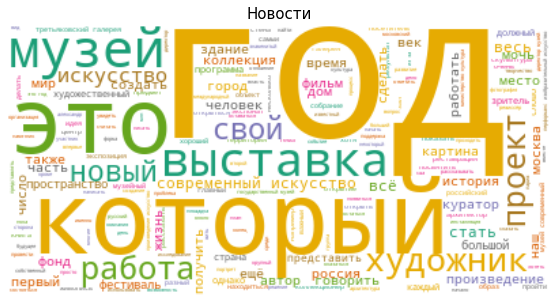

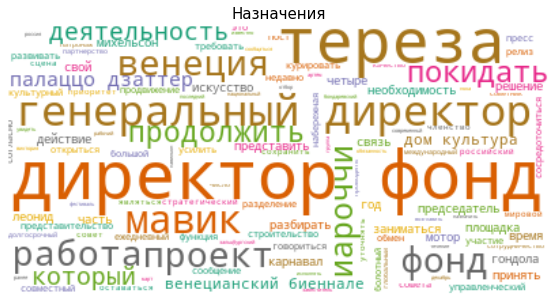

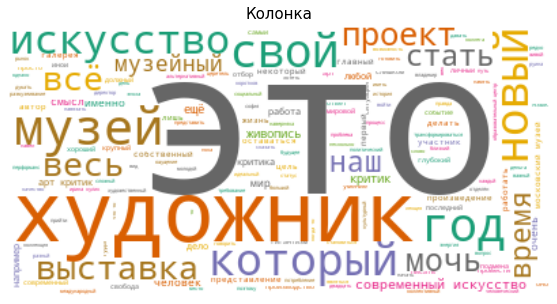

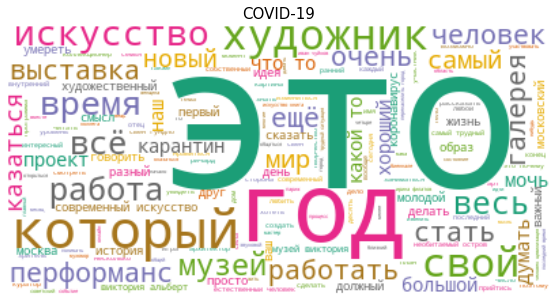

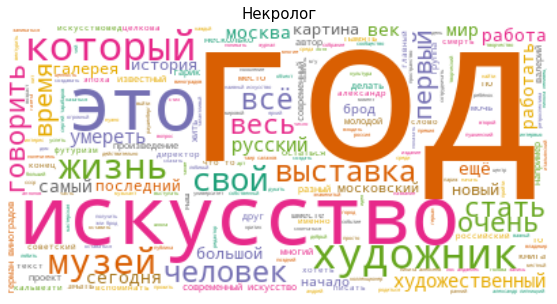

...

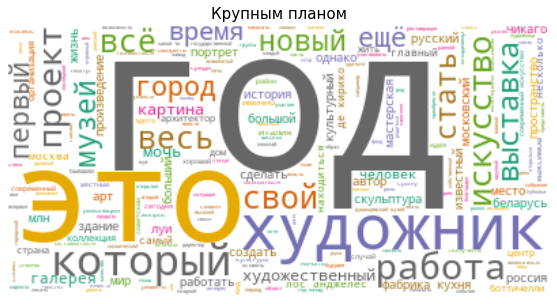

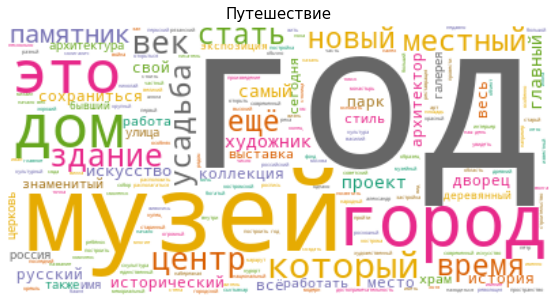

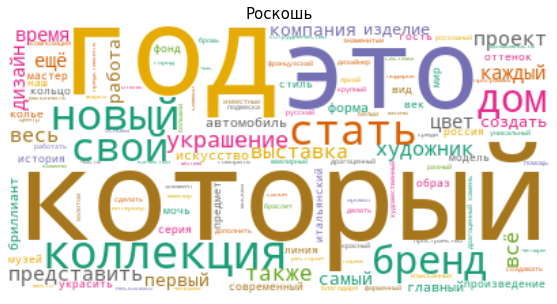

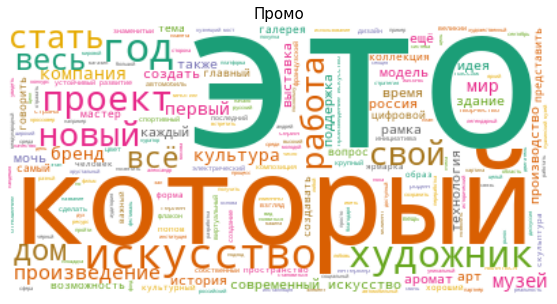

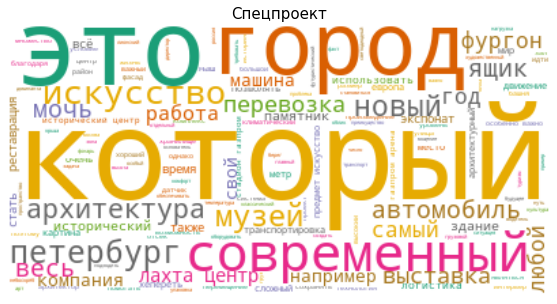

In [ ]:
# Let's make some word clouds
wc = WordCloud(background_color="white", colormap="Dark2",
               max_font_size=150, random_state=42)


plt.rcParams['figure.figsize'] = [15, 5]

# Create subplots for each genre
for index, category in enumerate(indexes):
  wc.generate(categories.long_text_tok_text[category])
    
  plt.imshow(wc, interpolation="bilinear")
  plt.axis("off")
  plt.title(indexes[index], fontsize = 15)
  plt.show()

In [ ]:
df_tanp.groupby(['new_page_title'])['long_text_tok_text'].count().sort_values(ascending=False)

new_page_title
Новости                            430
Выставки                           233
Роскошь                             99
Арт-рынок                           83
Реставрация                         71
Книги                               46
Интервью                            40
Музей                               34
Приглашения                         24
Рейтинг музеев                      21
Путешествие                         19
Крупным планом                      18
Некролог                            15
Мнения                              12
Промо                               11
COVID-19                            11
Календарь                           10
Премии и награды                     8
Архитектура                          8
Кинофестиваль                        7
Музей будущего                       6
NFT                                  6
Колонка                              5
Венецианская биеннале                3
Фестивали                            3
Художники 

In [ ]:
df_tanp['new_page_title'].nunique()

32

In [ ]:
idx_list = ['Календарь', 'Венецианская биеннале', 'Музей будущего', 'Рейтинг музеев', 'Путешествие',
            'Премия The Art Newspaper Russia']

for idx in idx_list:
  print(idx, grouped_titles.loc[idx]['tags_list_new'])

Календарь ['календарь', 'нижний новгород россия', 'флоренция италия', 'милан италия', 'москва россия']
Венецианская биеннале ['венецианская биеннале', 'интервью', 'новости']
Музей будущего ['музей будущего']
Рейтинг музеев ['музей', 'новости', 'выставки', 'рейтинг музеев']
Путешествие ['самара россия', 'пермь россия', 'россия', 'казань россия', 'путешествие', 'нижний новгород россия', 'стамбул турция']
Премия The Art Newspaper Russia ['мнения', 'премия the art newspaper russia']


In [ ]:
rest_dict = {'Календарь': 'Выставки',
             'Венецианская биеннале': 'Биеннале',
             'Музей будущего': 'Музей',
             'Рейтинг музеев': 'Музей',
             'Путешествие': 'Музей',
             'Премия The Art Newspaper Russia': 'Премии и награды'
             }

tanp_page_titles_new = ['Новости', 'Назначения', 'Колонка', 'COVID-19', 'Некролог', 'Арт-рынок', 'NFT', 'Выставки', 'Приглашения', 
                        'Фестивали', 'Кинофестиваль', 'Ярмарки', 'Музей', 'Реставрация', 'Интервью', 'Мнения', 'Премии и награды',
                        'Биеннале', 'Книги', 'Художники', 'Архитектура', 'Крупным планом', 'Роскошь', 'Промо', 'Спецпроект',
                        'Великий Новгород Россия']

print(len(tanp_page_titles_new))

26


In [ ]:
df_tanp['new_page_title'] = df_tanp['new_page_title'].dropna().apply(lambda x: x if x in tanp_page_titles_new else rest_dict[x])

print(df_tanp['new_page_title'].nunique())


indexes = ['Новости', 'Назначения', 'Колонка', 
           'COVID-19', 'Некролог', 
           'Арт-рынок', 'NFT', 
           'Выставки', 'Приглашения', 'Фестивали', 'Кинофестиваль', 'Ярмарки', 
           'Музей', 'Реставрация', 
           'Интервью', 'Мнения', 
           'Премии и награды', 
           'Биеннале', 
           'Книги', 'Художники', 'Архитектура', 
           'Крупным планом', 
           'Роскошь', 
           'Промо', 'Спецпроект',
           'Великий Новгород Россия']

print(len(indexes))

26
26


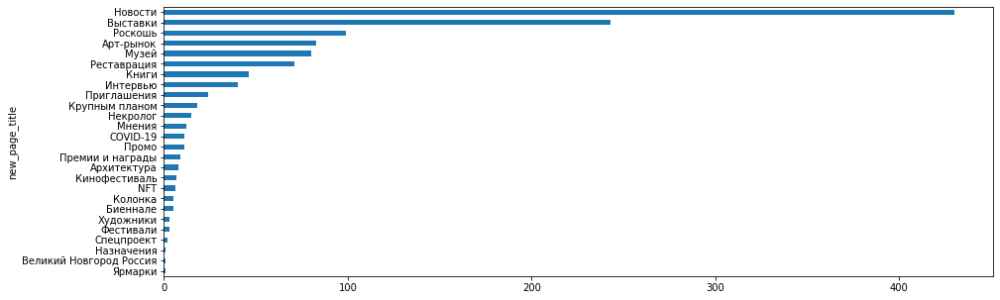

In [ ]:
df_tanp.groupby(['new_page_title'])['long_text_tok_text'].count().sort_values(ascending=True).plot(kind='barh')

In [ ]:
int(round(s.mean(df_tanp.groupby(['new_page_title'])['long_text_tok_text'].count()), 0))

47

## tanp step 2 - cat-s' word scoring & more cat-s reduction

### step 2.1 - extra_words

In [9]:
from sklearn.feature_extraction.text import CountVectorizer, TfidfVectorizer


# Create a Vectorizer Object
c_vec = CountVectorizer()
''' *, input="content", encoding="utf-8", decode_error="strict", strip_accents=None, lowercase=True, preprocessor=None, 
tokenizer=None, stop_words=None, token_pattern=r"(?u)\b\w\w+\b", ngram_range=(1, 1), analyzer="word", max_df=1, min_df=1, 
max_features=None, vocabulary=None, binary=False, dtype=np.int64 
'''

tfidf_vec = TfidfVectorizer()
''' *, input="content", encoding="utf-8", decode_error="strict", strip_accents=None, lowercase=True, preprocessor=None, 
tokenizer=None, analyzer="word", stop_words=None, token_pattern=r"(?u)\b\w\w+\b", ngram_range=(1, 1), max_df=1, min_df=1, 
max_features=None, vocabulary=None, binary=False, dtype=np.float64, norm="l2", use_idf=True, smooth_idf=True, sublinear_tf=False 
'''


def by_value(item):
  return item[1]

In [ ]:
categories = pd.DataFrame(df_tanp.groupby(['new_page_title'])['long_text_tok_text'].apply(combine_text))

In [ ]:
tfidf_vec.fit(categories['long_text_tok_text'])
print("Vocabulary: ", len(tfidf_vec.vocabulary_))

df_tfidf_vec = tfidf_vec.transform(categories['long_text_tok_text'])

df_dtm_tfidf_vec = pd.DataFrame(df_tfidf_vec.toarray(), columns=tfidf_vec.get_feature_names())
df_dtm_tfidf_vec.index = categories.index
df_dtm_tfidf_vec

Vocabulary:  37808


,air,amuzработа,ar,archaeology,asterrvnегор,auctions,audi,azмузей,aрт,cg,...,ёдзь,ёкоям,ёлка,ёлочка,ёлочный,ёмкий,ёмко,ёмкость,ёситомый,ёхэя
new_page_title,,,,,,,,,,,,,,,,,,,,,
COVID-19,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
NFT,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
Арт-рынок,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.001712,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.001519,0.001712,0.000000
Архитектура,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
Биеннале,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
Великий Новгород Россия,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
Выставки,0.000000,0.000854,0.000854,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000497,0.000758,0.000000,0.000000,0.000758,0.000000,0.000000,0.000000
Интервью,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.001114,0.000000,0.001697,0.002852,0.001697,0.000000,0.000000,0.000000
Кинофестиваль,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.013306,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000


In [ ]:
dictionary = df_dtm_tfidf_vec.to_dict(orient='index')
len(dictionary)

26

In [ ]:
for cut in indexes:
  print('10 More common words in category', cut)
  for k, v in sorted(dictionary[cut].items(), key=by_value, reverse=True)[:10]:
    print(k, '->', round(v, 5))
  print('')

  print('Average of unique word frequency:', round(s.mean([v for v in dictionary[cut].values()]), 5))
  print('Median of unique word frequency:', round(s.median([v for v in dictionary[cut].values()]), 5))
  print('Quantiles of unique word frequency:', [round(q, 5) for q in np.percentile([v for v in dictionary[cut].values()], [25, 50, 75])])
  print('')

10 More common words in category Новости
музей -> 0.37583
год -> 0.35541
искусство -> 0.24345
который -> 0.23133
это -> 0.21748
выставка -> 0.18006
художник -> 0.15218
работа -> 0.13249
проект -> 0.13139
свой -> 0.11458

Average of unique word frequency: 0.00109
Median of unique word frequency: 0.00035
Quantiles of unique word frequency: [0.0, 0.00035, 0.00079]

10 More common words in category Назначения
мавик -> 0.36586
тереза -> 0.35459
фонд -> 0.30922
генеральный -> 0.23959
дзаттер -> 0.21952
иароччи -> 0.21952
директор -> 0.21668
гондола -> 0.14634
мотор -> 0.14634
палаццо -> 0.13663

Average of unique word frequency: 0.00021
Median of unique word frequency: 0.0
Quantiles of unique word frequency: [0.0, 0.0, 0.0]

10 More common words in category Колонка
это -> 0.30196
музей -> 0.18481
искусство -> 0.17808
критик -> 0.15277
художник -> 0.14463
свой -> 0.12053
год -> 0.11937
который -> 0.11614
новый -> 0.11614
выставка -> 0.10842

Average of unique word frequency: 0.00077
Median of

In [ ]:
ten_words_dict = {}

for cut in indexes:
  ten_words_dict.setdefault(cut, [k for k, v in sorted(dictionary[cut].items(), key=by_value, reverse=True)[:10]])

len(ten_words_dict)

26

In [ ]:
for k, v in ten_words_dict.items():
  print(k, '->', v)

Новости -> ['музей', 'год', 'искусство', 'который', 'это', 'выставка', 'художник', 'работа', 'проект', 'свой']
Назначения -> ['мавик', 'тереза', 'фонд', 'генеральный', 'дзаттер', 'иароччи', 'директор', 'гондола', 'мотор', 'палаццо']
Колонка -> ['это', 'музей', 'искусство', 'критик', 'художник', 'свой', 'год', 'который', 'новый', 'выставка']
COVID-19 -> ['это', 'искусство', 'год', 'который', 'время', 'художник', 'свой', 'свен', 'то', 'музей']
Некролог -> ['год', 'искусство', 'это', 'художник', 'который', 'жизнь', 'брод', 'музей', 'свой', 'кальвезти']
Арт-рынок -> ['год', 'искусство', 'художник', 'который', 'ярмарка', 'работа', 'это', 'галерея', 'произведение', 'торг']
NFT -> ['искусство', 'nft', 'продажа', 'это', 'цифровой', 'год', 'рынок', 'блокчейн', 'художник', 'который']
Выставки -> ['выставка', 'музей', 'год', 'который', 'художник', 'это', 'искусство', 'работа', 'проект', 'свой']
Приглашения -> ['работа', 'который', 'выставка', 'искусство', 'галерея', 'год', 'художник', 'аукцион', 

In [ ]:
ten_words_counter = collections.Counter() # {word: its frequency}

for line in ten_words_dict.values():
  for word in line:
    ten_words_counter[word] += 1
  
len(ten_words_counter)

106

In [ ]:
for k, v in sorted(ten_words_counter.items(), key=by_value, reverse=True)[:25]:
  print(k, '->', v)

это -> 23
год -> 22
который -> 22
искусство -> 20
художник -> 15
музей -> 12
работа -> 10
выставка -> 8
проект -> 7
свой -> 7
новый -> 5
весь -> 4
галерея -> 3
произведение -> 3
город -> 3
всё -> 3
то -> 2
ярмарка -> 2
книга -> 2
мавик -> 1
тереза -> 1
фонд -> 1
генеральный -> 1
дзаттер -> 1
иароччи -> 1


In [ ]:
extra_words_1 = [k for k, v in sorted(ten_words_counter.items(), key=by_value, reverse=True)[:4]]
extra_words_1.extend(['весь', 'всё', 'то']) # 'новый', 'стать'
extra_words_1

['это', 'год', 'который', 'искусство', 'весь', 'всё', 'то']

In [ ]:
extra_words = extra_words_1.copy()

In [5]:
def reduce_text(text):

  for word in extra_words:
    text = re.sub(word, '', text)
    text = re.sub(r'\s\s', ' ', text)

  return text


def reduced_text(text):

  text = text.split(' ')
  for word in text:
    if word in extra_words:
      text.remove(word)
  text = ' '.join(text)
  
  return text

In [ ]:
#df_tanp['long_text_tok_cut'] = df_tanp['long_text_tok_text'].dropna().apply(reduce_text)
df_tanp['long_text_tok_cut'] = df_tanp['long_text_tok_text'].dropna().apply(reduced_text) # longer but don't cut parts of words

categories = pd.DataFrame(df_tanp.groupby(['new_page_title'])['long_text_tok_cut'].apply(combine_text))

In [ ]:
indexes_1 = ['Новости', 'Выставки', 'Роскошь', 'Арт-рынок', 'Музей', 'Реставрация', 'Книги', 'Интервью']

indexes_2 = ['Приглашения', 'Крупным планом', 'Некролог', 'Мнения', 'Промо', 'COVID-19', 'Премии и награды', 'Архитектура',
             'Кинофестиваль', 'NFT', 'Колонка', 'Биеннале', 'Фестивали', 'Художники', 'Спецпроект', 'Назначения', 'Ярмарки',
             'Великий Новгород Россия']

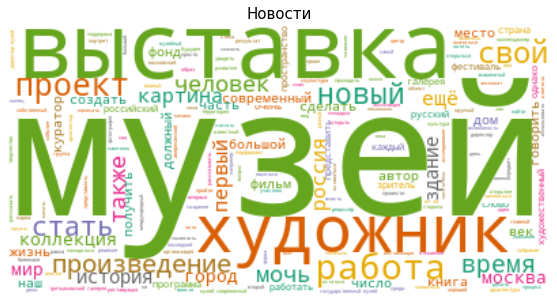

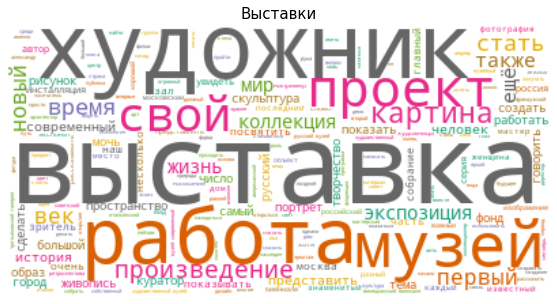

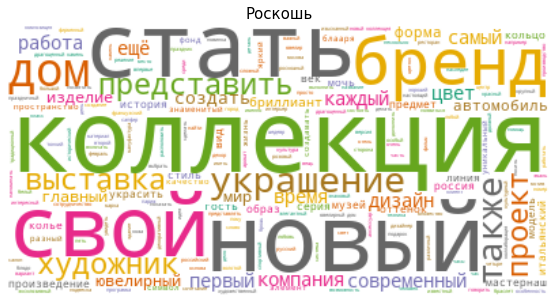

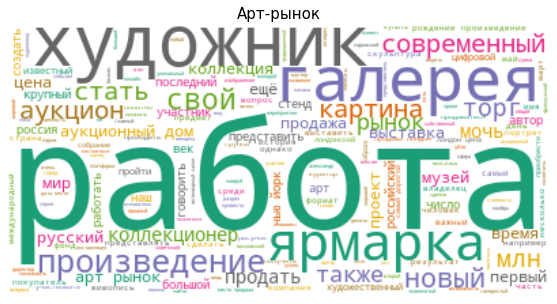

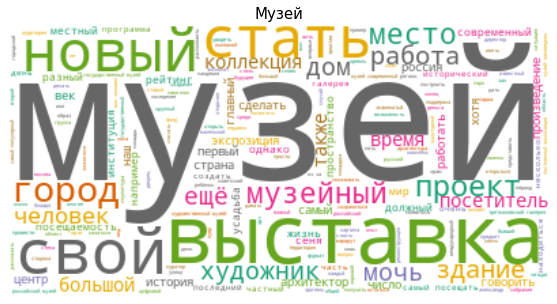

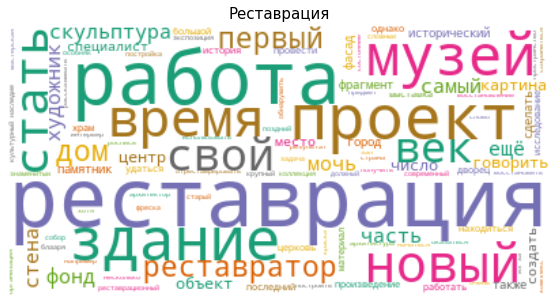

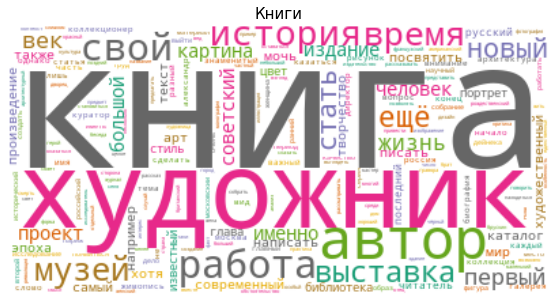

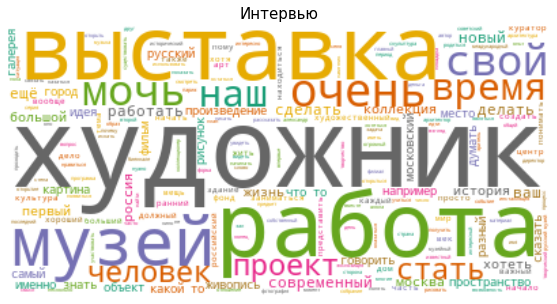

In [ ]:
# Let's make some word clouds
#wc = WordCloud(background_color="white", colormap="Dark2",
#               max_font_size=150, random_state=42)

plt.rcParams['figure.figsize'] = [15, 5]

# Create subplots for each genre
for index, category in enumerate(indexes_1):
  wc.generate(categories.long_text_tok_cut[category])
    
  plt.imshow(wc, interpolation="bilinear")
  plt.axis("off")
  plt.title(indexes_1[index], fontsize = 15)
  plt.show()

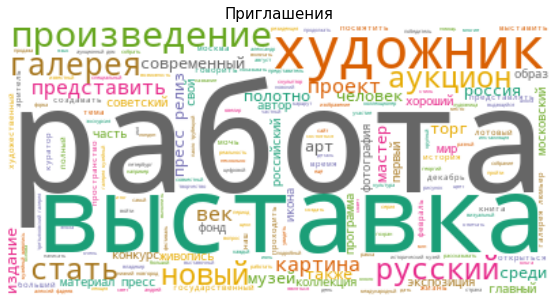

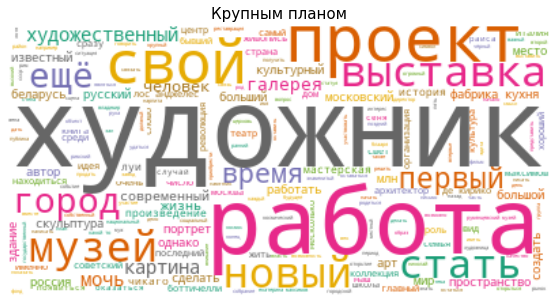

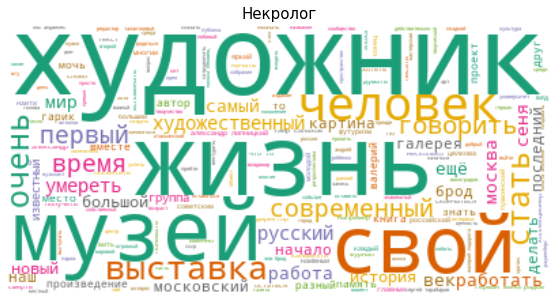

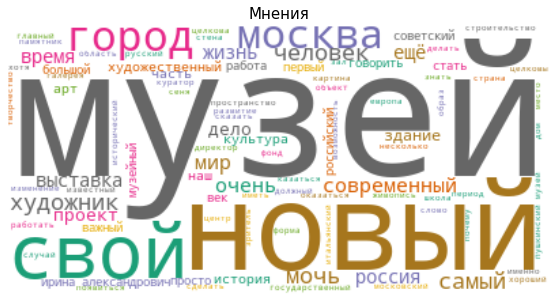

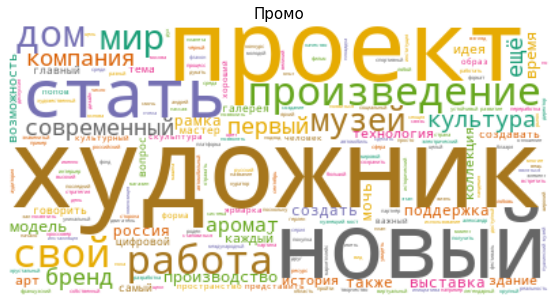

...

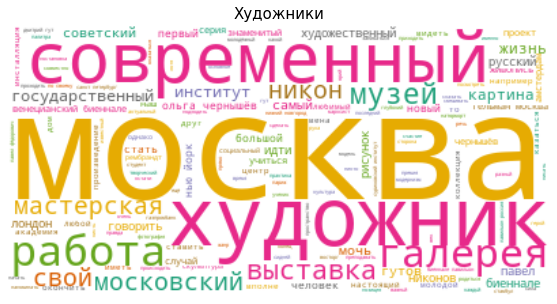

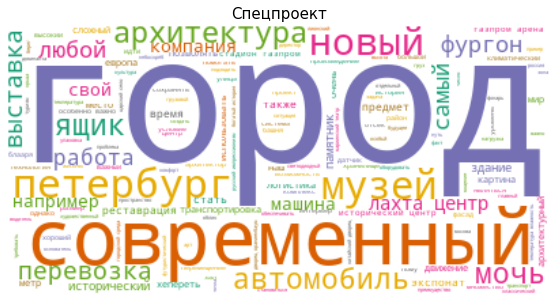

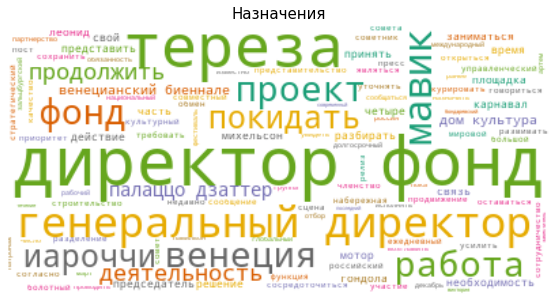

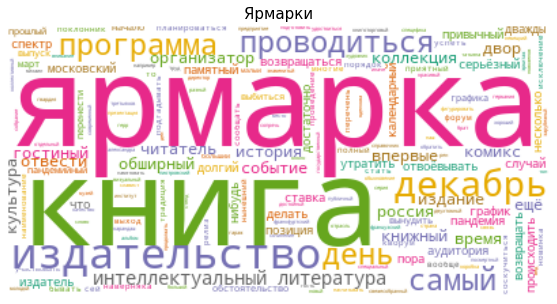

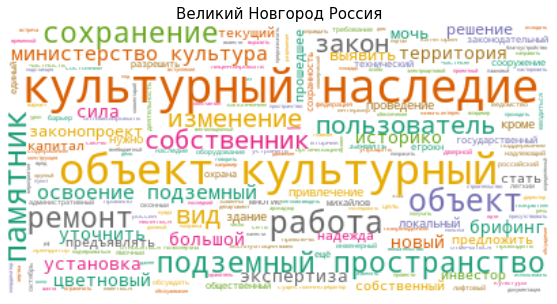

In [ ]:
plt.rcParams['figure.figsize'] = [15, 5]

# Create subplots for each genre
for index, category in enumerate(indexes_2):
  wc.generate(categories.long_text_tok_cut[category])
    
  plt.imshow(wc, interpolation="bilinear")
  plt.axis("off")
  plt.title(indexes_2[index], fontsize = 15)
  plt.show()

### step 2.2 - tags

In [ ]:
grouped_titles = pd.DataFrame(df_tanp.groupby(['new_page_title'])['tags_list_new'].apply(combine_lists))

idx_list = ['Биеннале', 'Приглашения', 'Назначения', 'COVID-19', 'Некролог', 'Промо', 'Крупным планом', 'NFT', 'Колонка']

for idx in idx_list:
  print(idx, grouped_titles.loc[idx]['tags_list_new'])

# Биеннале ['биеннале', 'крупным планом', 'интервью', 'сан-паулу бразилия', 'венецианская биеннале', 'новости']
# Назначения ['назначения', 'новости'] -> 'Музей'
# COVID-19 ['лондон великобритания', 'некролог', 'интервью', 'covid-19', 'архитектура']
# Некролог ['некролог', 'новости'] -> 'Художники'
# Колонка ['колонка', 'мнения', 'музей'] -> 'Музей'
# NFT ['галереи', 'интервью', 'nft', 'арт-рынок']
# Крупным планом ['мнения', 'интервью', 'архитектура', 'чикаго сша', 'крупным планом', 'лос-анджелес сша', 'выставки', 'художники', 'арт-рынок']
# -> 'Художники'

Биеннале ['сан-паулу бразилия', 'новости', 'венецианская биеннале', 'крупным планом', 'интервью', 'биеннале']
Приглашения ['промо', 'приглашения', 'москва россия']
Назначения ['назначения', 'новости']
COVID-19 ['covid-19', 'архитектура', 'интервью', 'лондон великобритания', 'некролог']
Некролог ['новости', 'некролог']
Промо ['промо', 'guerlain', 'audi россия']
Крупным планом ['чикаго сша', 'лос-анджелес сша', 'архитектура', 'арт-рынок', 'крупным планом', 'выставки', 'мнения', 'художники', 'антверпен бельгия', 'интервью']
NFT ['арт-рынок', 'интервью', 'nft', 'галереи']
Колонка ['мнения', 'музей', 'колонка']


In [ ]:
rest_dict = {#'Биеннале': 'Выставки',
             'Приглашения': 'Выставки',
             #'Назначения': 'Музей',
             #'COVID-19': 'Новости',
             #'Некролог': 'Художники',
             'Промо': 'Художники',
             #'Крупным планом': 'Художники',
             #'NFT': 'Арт-рынок',
             #'Колонка': 'Мнения',
             }

tanp_page_titles_new = ['Новости', 'Арт-рынок', 'Выставки', 'Фестивали', 'Кинофестиваль', 'Ярмарки', 'Музей', 'Реставрация', 
                        'Интервью', 'Мнения', 'Премии и награды', 'Книги', 'Художники', 'Архитектура', 'Роскошь', 'Спецпроект',
                        'Великий Новгород Россия', 
                        'Биеннале', 'Назначения', 'Некролог', 'Крупным планом', 'NFT', 'Колонка', 'COVID-19']

print(len(tanp_page_titles_new))

df_tanp['new_page_title'] = df_tanp['new_page_title'].dropna().apply(lambda x: x if x in tanp_page_titles_new else rest_dict[x])
print(df_tanp['new_page_title'].nunique())

24
24


In [ ]:
tanp_page_titles = ['Новости', 'Арт-рынок', 'Выставки', 'Фестивали', 'Кинофестиваль', 'Ярмарки', 'Музей', 'Реставрация', 
                    'Интервью', 'Мнения', 'Премии и награды', 'Книги', 'Художники', 'Архитектура', 'Роскошь', 'Спецпроект']

print(len(tanp_page_titles_new))

rest_list = list(set(df_tanp['new_page_title'].unique().tolist()) - set(tanp_page_titles))
print(len(rest_list))
rest_list

24
8


['NFT',
 'Назначения',
 'Некролог',
 'COVID-19',
 'Великий Новгород Россия',
 'Биеннале',
 'Колонка',
 'Крупным планом']

In [ ]:
page_titles = df_tanp['new_page_title'].tolist()
tags_lists = df_tanp['tags_list_new'].tolist()
print(len(page_titles))
print(len(tags_lists))

new_page_titles = []
for i, pt in enumerate(page_titles):
  if pt in tanp_page_titles:
    npt = pt
  else:
    for p in tanp_page_titles:
      if p.lower() in tags_lists[i]:
        npt = p
        break
      else:
        npt = pt

  new_page_titles.append(npt)
print(len(new_page_titles))

1234
1234
1234


In [ ]:
df_tanp['new_page_title'] = new_page_titles

print(df_tanp['new_page_title'].count())
print(df_tanp['new_page_title'].nunique())
print(len(tanp_page_titles))

1234
23
16


In [ ]:
rest_list = list(set(df_tanp['new_page_title'].unique().tolist()) - set(tanp_page_titles))

for el in rest_list:
  print(el, list(set( df_tanp[df_tanp['new_page_title']==el]['tags_list_new'].tolist())))

NFT ['nft, галереи']
Некролог ['некролог']
COVID-19 ['covid-19, лондон великобритания', 'covid-19, некролог']
Великий Новгород Россия ['великий новгород россия']
Биеннале ['венецианская биеннале', 'биеннале, сан-паулу бразилия', 'биеннале, крупным планом']
Колонка ['колонка']
Крупным планом ['антверпен бельгия, крупным планом', 'крупным планом, лос-анджелес сша', 'крупным планом', 'крупным планом, чикаго сша']


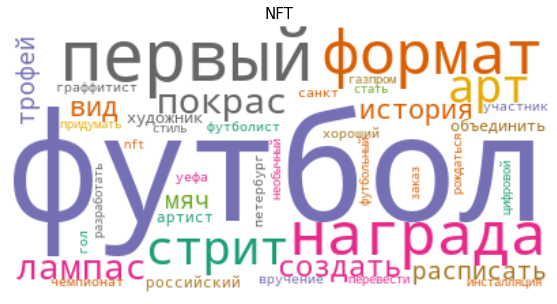

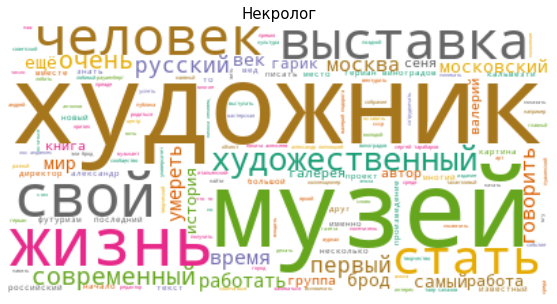

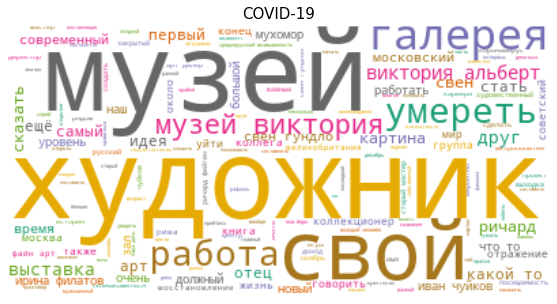

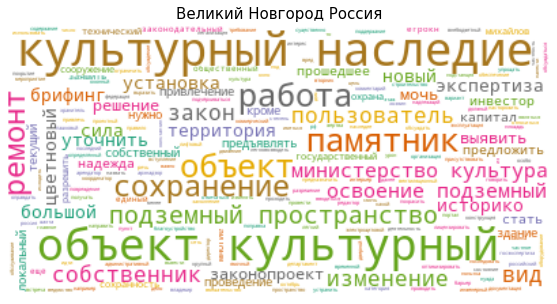

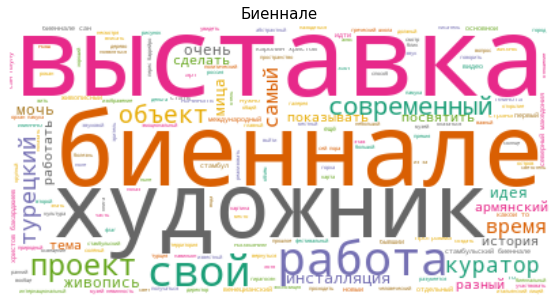

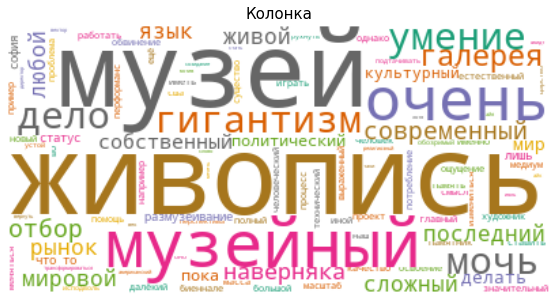

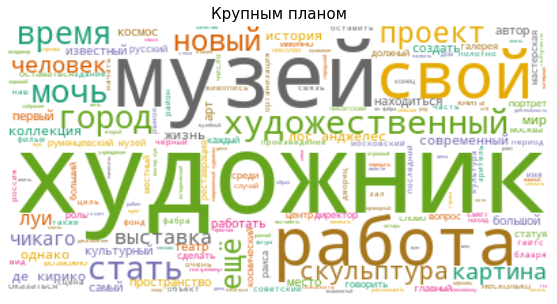

In [ ]:
categories = pd.DataFrame(df_tanp.groupby(['new_page_title'])['long_text_tok_cut'].apply(combine_text))

plt.rcParams['figure.figsize'] = [15, 5]

# Create subplots for each genre
for index, category in enumerate(rest_list):
  wc.generate(categories.long_text_tok_cut[category])
    
  plt.imshow(wc, interpolation="bilinear")
  plt.axis("off")
  plt.title(rest_list[index], fontsize = 15)
  plt.show()

In [ ]:
rest_dict = {'Биеннале': 'Выставки',
             'COVID-19': 'Новости',
             'Некролог': 'Художники',
             'Крупным планом': 'Художники',
             'NFT': 'Арт-рынок',
             'Колонка': 'Музей', # 'Мнение'
             }

tanp_page_titles_new = ['Новости', 'Арт-рынок', 'Выставки', 'Фестивали', 'Кинофестиваль', 'Ярмарки', 'Музей', 'Реставрация', 
                        'Интервью', 'Мнения', 'Премии и награды', 'Книги', 'Художники', 'Архитектура', 'Роскошь', 'Спецпроект',
                        'Великий Новгород Россия']

print(len(tanp_page_titles_new))

df_tanp['new_page_title'] = df_tanp['new_page_title'].dropna().apply(lambda x: x if x in tanp_page_titles_new else rest_dict[x])
print(df_tanp['new_page_title'].nunique())

17
17


In [ ]:
# 'Новости', 'Интервью'

tanp_page_titles = ['Арт-рынок', 'Выставки', 'Фестивали', 'Кинофестиваль', 'Ярмарки', 'Музей', 'Реставрация', 
                    'Мнения', 'Премии и награды', 'Книги', 'Художники', 'Архитектура', 'Роскошь', 'Спецпроект']

print(len(tanp_page_titles_new))

rest_list = list(set(df_tanp['new_page_title'].unique().tolist()) - set(tanp_page_titles))
print(len(rest_list))
rest_list

17
3


['Новости', 'Интервью', 'Великий Новгород Россия']

In [ ]:
page_titles = df_tanp['new_page_title'].tolist()
tags_lists = df_tanp['tags_list_new'].tolist()
print(len(page_titles))
print(len(tags_lists))

new_page_titles = []
for i, pt in enumerate(page_titles):
  if pt in tanp_page_titles:
    npt = pt
  else:
    for p in tanp_page_titles:
      if p.lower() in tags_lists[i]:
        npt = p
        break
      else:
        npt = pt

  new_page_titles.append(npt)
print(len(new_page_titles))

1234
1234
1234


In [ ]:
df_tanp['new_page_title'] = new_page_titles

print(df_tanp['new_page_title'].count())
print(df_tanp['new_page_title'].nunique())
print(len(tanp_page_titles))

1234
17
14


In [ ]:
rest_list = list(set(df_tanp['new_page_title'].unique().tolist()) - set(tanp_page_titles))

for el in rest_list:
  print(el, list(set( df_tanp[df_tanp['new_page_title']==el]['tags_list_new'].tolist())))

Новости ['covid-19, лондон великобритания', 'новости, антверпен бельгия', 'новости, промо', 'новости, лондон великобритания', 'новости, багдад ирак', 'новости, стамбул турция', 'новости', 'новости, самара россия', 'новости, великий новгород россия', 'новости, чикаго сша', 'новости, ленинградская область россия', 'рим италия, новости', 'новости, баку азербайджан', 'сша, новости', 'пермь россия, новости', 'новости, вашингтон сша', 'новости, сша', 'новости, санкт-петербург россия', 'екатеринбург россия, новости', 'новости, московская область россия', 'новости, рейтинг музеев', 'новости, малага испания', 'новости, москва россия', 'covid-19, некролог', 'новости, биеннале', 'новости, париж франция', 'новости, nft', 'флоренция италия, новости', 'новости, лос-анджелес сша', 'новости, крупным планом', 'новости, тула и тульская область россия', 'новости, екатеринбург россия', 'новости, некролог', 'новости, нью-йорк сша', 'назначения, новости', 'московская область россия, новости', 'венецианская 

In [ ]:
print(int(round(s.mean(df_tanp.groupby(['new_page_title'])['long_text_tok_text'].count()), 0)), end='\n\n')

df_tanp.groupby(['new_page_title'])['long_text_tok_text'].count().sort_values(ascending=False)

73



new_page_title
Новости                    349
Выставки                   274
Музей                      111
Роскошь                     99
Арт-рынок                   95
Реставрация                 72
Книги                       47
Художники                   46
Интервью                    44
Кинофестиваль               22
Премии и награды            22
Архитектура                 19
Мнения                      16
Фестивали                   12
Ярмарки                      3
Спецпроект                   2
Великий Новгород Россия      1
Name: long_text_tok_text, dtype: int64

In [ ]:
categories = pd.DataFrame(df_tanp.groupby(['new_page_title'])['long_text_tok_cut'].apply(combine_text))

indexes_1 = ['Новости', 'Интервью', 'Выставки', 'Роскошь', 'Арт-рынок', 'Музей', 'Реставрация', 'Книги', 'Художники']

indexes_2 = ['Мнения', 'Премии и награды',
             'Архитектура', 'Спецпроект', 
             'Кинофестиваль', 'Фестивали', 'Ярмарки',
             'Великий Новгород Россия']

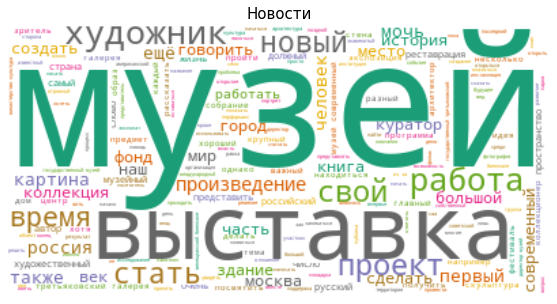

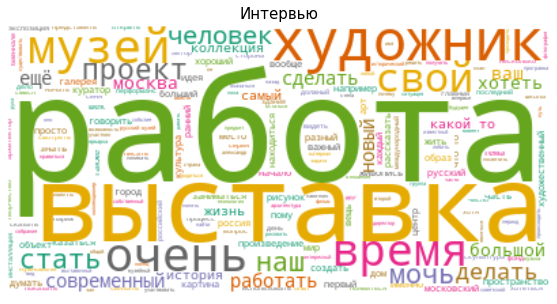

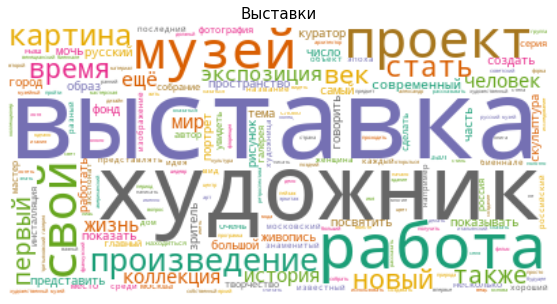

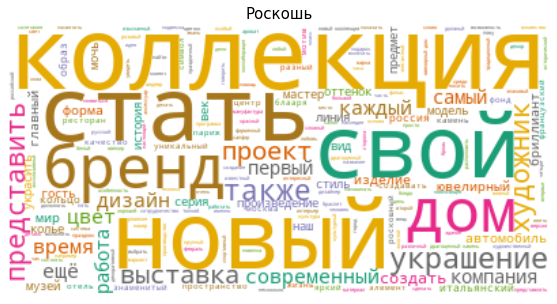

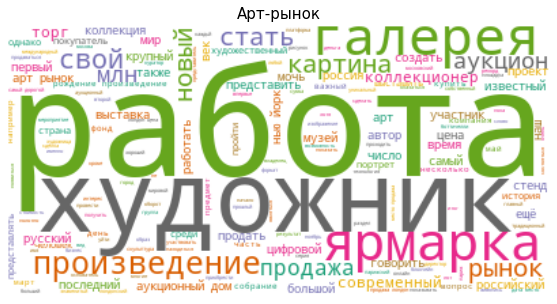

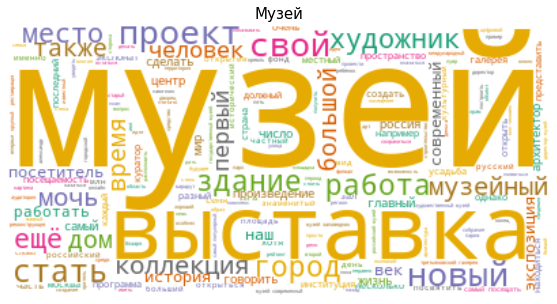

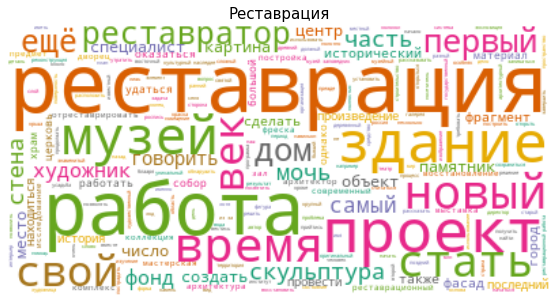

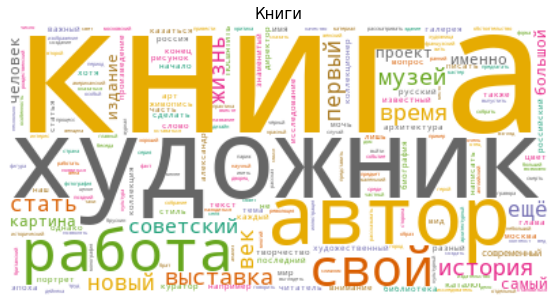

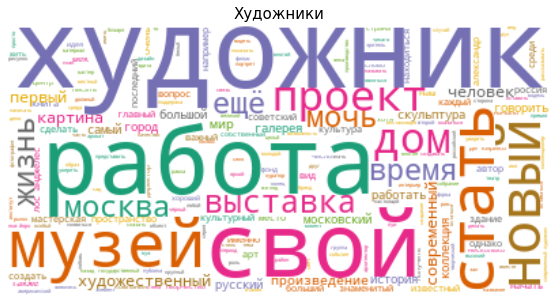

In [ ]:
# Let's make some word clouds
#wc = WordCloud(background_color="white", colormap="Dark2",
#               max_font_size=150, random_state=0) # 42

plt.rcParams['figure.figsize'] = [15, 5]

# Create subplots for each genre
for index, category in enumerate(indexes_1):
  wc.generate(categories.long_text_tok_cut[category])
    
  plt.imshow(wc, interpolation="bilinear")
  plt.axis("off")
  plt.title(indexes_1[index], fontsize = 15)
  plt.show()

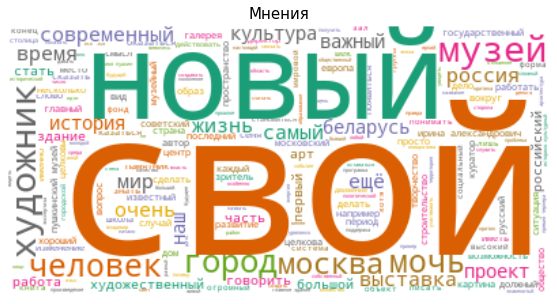

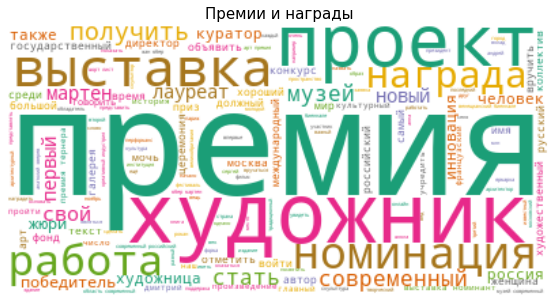

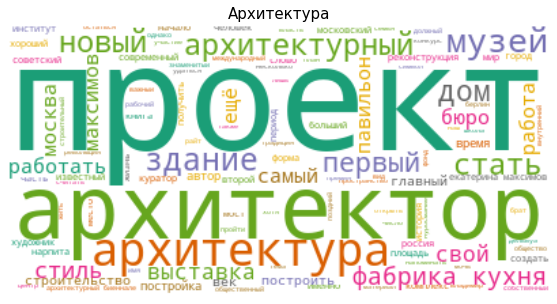

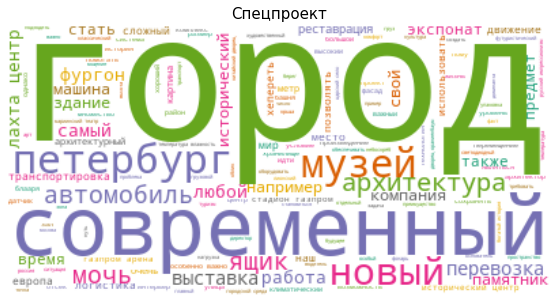

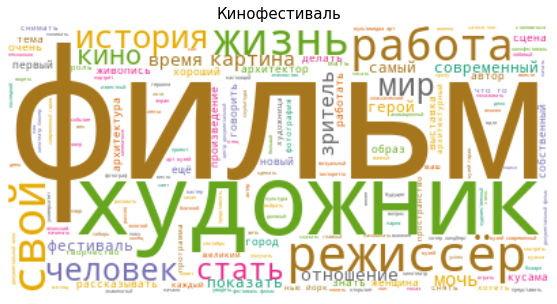

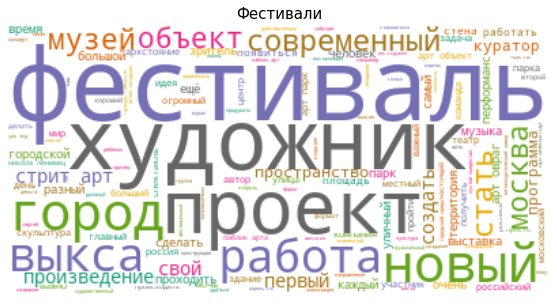

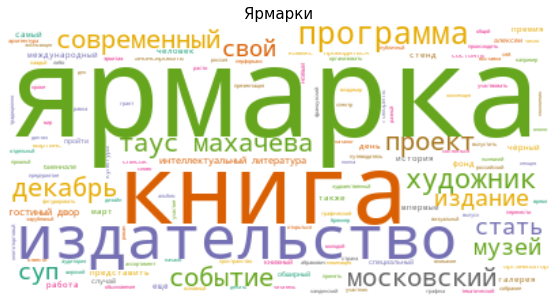

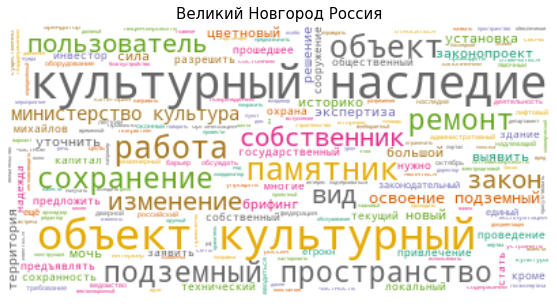

In [ ]:
plt.rcParams['figure.figsize'] = [15, 5]

# Create subplots for each genre
for index, category in enumerate(indexes_2):
  wc.generate(categories.long_text_tok_cut[category])
    
  plt.imshow(wc, interpolation="bilinear")
  plt.axis("off")
  plt.title(indexes_2[index], fontsize = 15)
  plt.show()

In [ ]:
df_tanp['interview'] = df_tanp.apply(lambda x: 1 if 'интервью' in x['tags_list_new'] else 0, axis=1)

print('Interview tag count', df_tanp.query('interview==1')['interview'].count())
print('Interview without tag count', df_tanp.loc[(df_tanp['interview']==0) & (df_tanp['new_page_title']=='Интервью')]['interview'].count())
print('Non-Interview with tag count', df_tanp.loc[(df_tanp['interview']==1) & (df_tanp['new_page_title']!='Интервью')]['interview'].count())
print('')
print('Non-Interview with tag', end='\n\n')
df_tanp.loc[(df_tanp['interview']==1) & (df_tanp['new_page_title']!='Интервью')].groupby(df_tanp['new_page_title'])['interview'].count().sort_values(ascending=False)

Interview tag count 60
Interview without tag count 0
Non-Interview with tag count 16

Non-Interview with tag



new_page_title
Новости          6
Выставки         4
Арт-рынок        2
Кинофестиваль    2
Музей            1
Фестивали        1
Name: interview, dtype: int64

In [ ]:
df_tanp['news'] = df_tanp.apply(lambda x: 1 if 'новости' in x['tags_list_new'] else 0, axis=1)

print('News tag count', df_tanp.query('news==1')['news'].count())
print('News without tag count', df_tanp.loc[(df_tanp['news']==0) & (df_tanp['new_page_title']=='Новости')]['news'].count())
print('Non-News with tag count', df_tanp.loc[(df_tanp['news']==1) & (df_tanp['new_page_title']!='Новости')]['news'].count())
print('')
print('Non-News with tag', end='\n\n')
df_tanp.loc[(df_tanp['news']==1) & (df_tanp['new_page_title']!='Новости')].groupby(df_tanp['new_page_title'])['news'].count().sort_values(ascending=False)

News tag count 481
News without tag count 5
Non-News with tag count 137

Non-News with tag



new_page_title
Музей               38
Арт-рынок           15
Реставрация         15
Премии и награды    14
Выставки            13
Кинофестиваль       13
Архитектура          9
Фестивали            9
Художники            6
Ярмарки              2
Книги                1
Мнения               1
Роскошь              1
Name: news, dtype: int64

In [32]:
categories = pd.DataFrame(df_tanp.groupby(['new_page_title'])['long_text_tok_cut'].apply(combine_text))

tfidf_vec.fit(categories['long_text_tok_cut'])
print("Vocabulary: ", len(tfidf_vec.vocabulary_))

df_tfidf_vec = tfidf_vec.transform(categories['long_text_tok_cut'])

df_dtm_tfidf_vec = pd.DataFrame(df_tfidf_vec.toarray(), columns=tfidf_vec.get_feature_names())
df_dtm_tfidf_vec.index = categories.index

dictionary = df_dtm_tfidf_vec.to_dict(orient='index')
print(len(dictionary))

indexes = ['Новости', 'Арт-рынок', 'Выставки', 'Фестивали', 'Кинофестиваль', 'Ярмарки', 'Музей', 'Реставрация', 
           'Интервью', 'Мнения', 'Премии и награды', 'Книги', 'Художники', 'Архитектура', 'Роскошь', 'Спецпроект',
           'Великий Новгород Россия']

print(len(indexes))

Vocabulary:  23508
17
17


In [35]:
for cut in indexes:
  print('10 More common words in category', cut)
  for k, v in sorted(dictionary[cut].items(), key=by_value, reverse=True)[:20]:
    print(k, '->', round(v, 5))
  print('')

  print('Count of unique word:', len([v for v in dictionary[cut].values()]))
  print('Average of unique word frequency:', round(s.mean([v for v in dictionary[cut].values()]), 5))
  print('Median of unique word frequency:', round(s.median([v for v in dictionary[cut].values()]), 5))
  print('Quantiles of unique word frequency:', [round(q, 5) for q in np.percentile([v for v in dictionary[cut].values()], [25, 50, 75])])
  print('')

# ['это', 'год', 'который', 'искусство', 'весь', 'всё', 'то']

10 More common words in category Новости
музей -> 0.48779
выставка -> 0.23026
художник -> 0.18
работа -> 0.16621
проект -> 0.15331
свой -> 0.13929
современный -> 0.12487
новый -> 0.12273
время -> 0.11123
стать -> 0.10946
биеннале -> 0.09846
произведение -> 0.09557
москва -> 0.09475
государственный -> 0.09435
галерея -> 0.0939
русский -> 0.09331
центр -> 0.08571
картина -> 0.08453
директор -> 0.08274
культура -> 0.08163

Count of unique word: 23508
Average of unique word frequency: 0.00177
Median of unique word frequency: 0.00051
Quantiles of unique word frequency: [0.0, 0.00051, 0.00154]

10 More common words in category Арт-рынок
художник -> 0.25879
работа -> 0.23221
ярмарка -> 0.22559
произведение -> 0.20976
рынок -> 0.19481
галерея -> 0.18398
торг -> 0.18194
млн -> 0.17513
аукционный -> 0.16508
аукцион -> 0.16507
арт -> 0.16292
продажа -> 0.16238
современный -> 0.12856
продать -> 0.12451
цена -> 0.11811
картина -> 0.11342
новый -> 0.11113
свой -> 0.10861
стать -> 0.10431
русский -> 

### step 2.3 - titles

In [ ]:
grouped_titles = pd.DataFrame(df_tanp.groupby(['new_page_title'])['tags_list_new'].apply(combine_lists))

for idx in indexes_2:
  print(idx, grouped_titles.loc[idx]['tags_list_new'])

Мнения ['россия', 'новости', 'сша', 'крупным планом', 'колонка', 'выставки', 'реставрация', 'мнения']
Премии и награды ['новости', 'премии и награды', 'венецианская биеннале', 'нижний новгород россия', 'мнения', 'премия the art newspaper russia']
Архитектура ['музей', 'covid-19', 'архитектура', 'книги', 'новости', 'премии и награды', 'крупным планом']
Спецпроект ['спецпроект', 'mercedes-benz']
Кинофестиваль ['кинофестиваль', 'новости', 'скульптура', 'крупным планом', 'интервью', 'светская хроника']
Фестивали ['фестивали', 'интервью', 'новости']
Ярмарки ['ярмарки', 'новости', 'москва россия']
Великий Новгород Россия ['великий новгород россия']


In [ ]:
for cut in indexes_2:
  print(cut, end='\n\n')
  for line in df_tanp.loc[df_tanp['new_page_title']==cut]['title'].tolist():
    print(line)
  print('', end='\n\n')

Мнения

Переломный момент: как Москва превращается в новый город
Дэвид Хокни рассуждает о том, почему лучше рисовать, а не фотографировать
Побелевшие стены: зачем Пушкинский музей переделал постоянную экспозицию
Где мы свернули не туда?
Шалость удалась: анархисты вдохновили конспирологов
Стандарты счастья — от Москвы до Урюпинска
Стеклянный занавес
Спектакль «Семь дней в совриске» стоит выеденного банана
В ногу с этикой
Трудно представить себе Пушкинский музей без Ирины Антоновой
Зачем фальсифицировать прошлое
Беларусь: взгляд антрополога
Означает ли коллективная награда конец Премии Тернера?
Чужой гений. Андрей Ерофеев об Олеге Целкове
Историко-культурная экспертиза: барьер или защита?
Неугасающий огонь: образование как форма поддержания диалога


Премии и награды

Премию «Инновация» проведут всем миром
Катарине Фрич и Сесилии Викунье дадут «золотых львов» за вклад в искусство
Объявлены победители Russian Creative Awards
Премией Тёрнера награждена группа активистов из Северной Ирланди

### step 2.4 - top words

In [ ]:
tfidf_vec.fit(categories['long_text_tok_cut'])
print("Vocabulary: ", len(tfidf_vec.vocabulary_))

df_tfidf_vec = tfidf_vec.transform(categories['long_text_tok_cut'])

df_dtm_tfidf_vec = pd.DataFrame(df_tfidf_vec.toarray(), columns=tfidf_vec.get_feature_names())
df_dtm_tfidf_vec.index = categories.index


dictionary = df_dtm_tfidf_vec.to_dict(orient='index')
print(len(dictionary))

Vocabulary:  37683
17


In [ ]:
ten_words_dict = {}
for cut in indexes:
  ten_words_dict.setdefault(cut, {k: v for k, v in sorted(dictionary[cut].items(), key=by_value, reverse=True)[:10]})
  
print(len(ten_words_dict))

17


In [ ]:
for key, value in ten_words_dict.items():
  print(key, '->', [k for k in value.keys()])
  print(key, '->', [round(v,5) for v in value.values()])
  print('')

Новости -> ['музей', 'выставка', 'художник', 'работа', 'проект', 'свой', 'современный', 'новый', 'время', 'стать']
Новости -> [0.488, 0.23036, 0.18007, 0.16628, 0.15338, 0.13934, 0.12492, 0.12296, 0.11128, 0.1095]

Арт-рынок -> ['художник', 'работа', 'ярмарка', 'произведение', 'рынок', 'галерея', 'рг', 'млн', 'аукционный', 'аукцион']
Арт-рынок -> [0.25868, 0.23212, 0.2255, 0.20967, 0.19473, 0.1839, 0.18187, 0.17506, 0.16501, 0.165]

Выставки -> ['выставка', 'музей', 'художник', 'работа', 'проект', 'свой', 'произведение', 'новый', 'картина', 'современный']
Выставки -> [0.44191, 0.33785, 0.2705, 0.20444, 0.14353, 0.12614, 0.12141, 0.11776, 0.11052, 0.10516]

Фестивали -> ['фестиваль', 'выкса', 'арт', 'художник', 'город', 'проект', 'новый', 'объект', 'работа', 'архсяние']
Фестивали -> [0.40169, 0.25982, 0.23437, 0.22524, 0.18023, 0.16436, 0.14396, 0.13088, 0.12668, 0.11757]

Кинофестиваль -> ['фильм', 'режиссёр', 'художник', 'свой', 'линдберг', 'жизнь', 'работа', 'исрия', 'кино', 'кон']
К

Новости


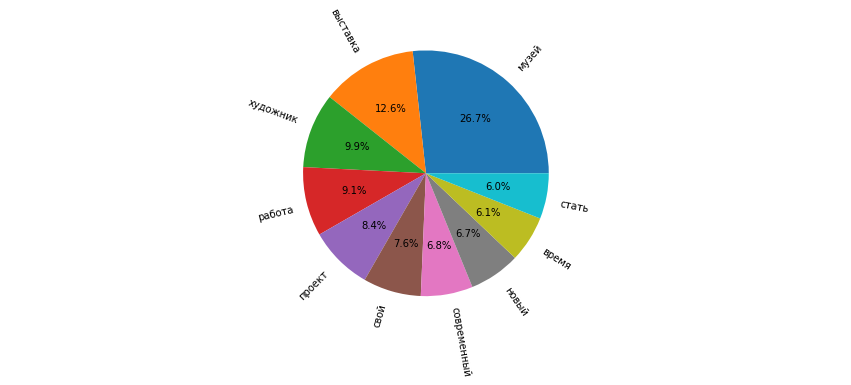


Арт-рынок


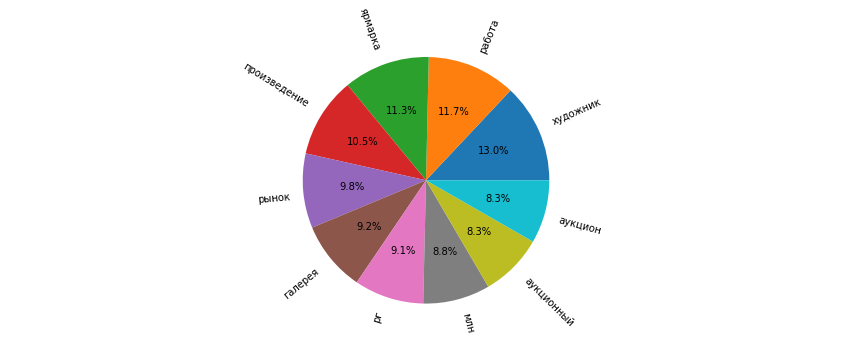


Выставки


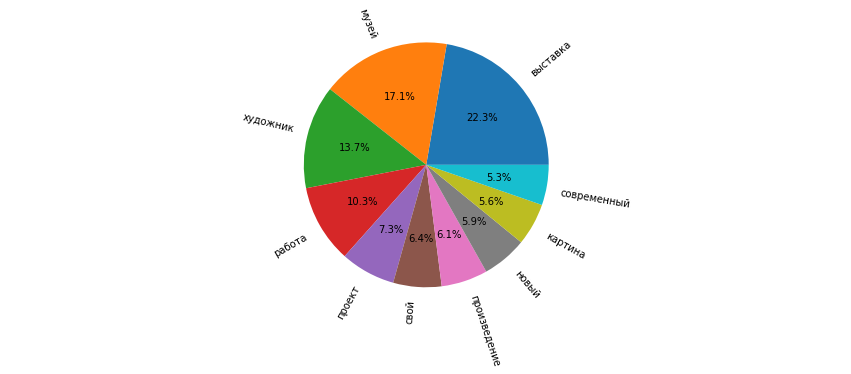


Фестивали


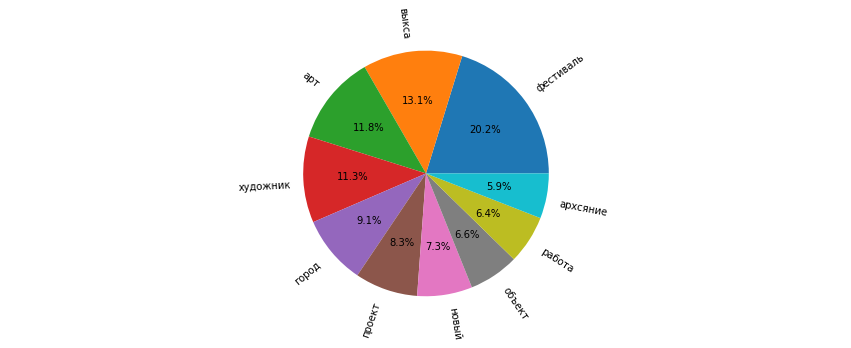


Кинофестиваль


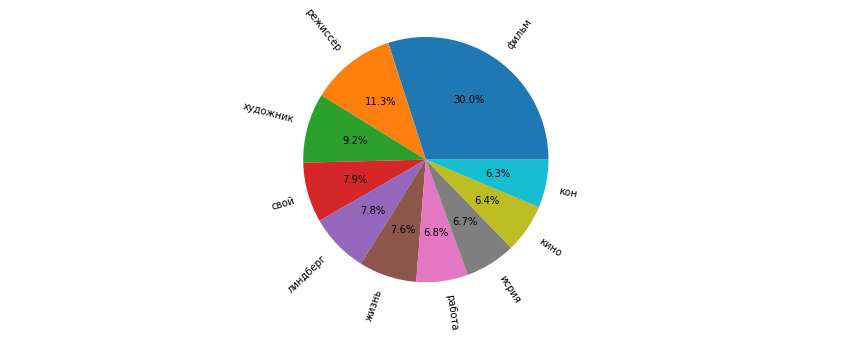


Ярмарки


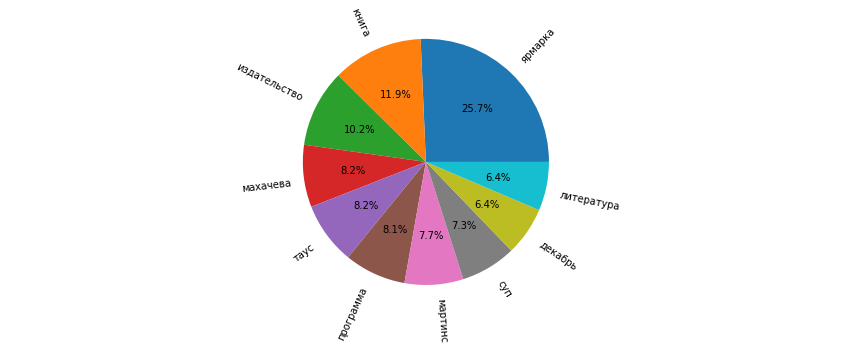


Музей


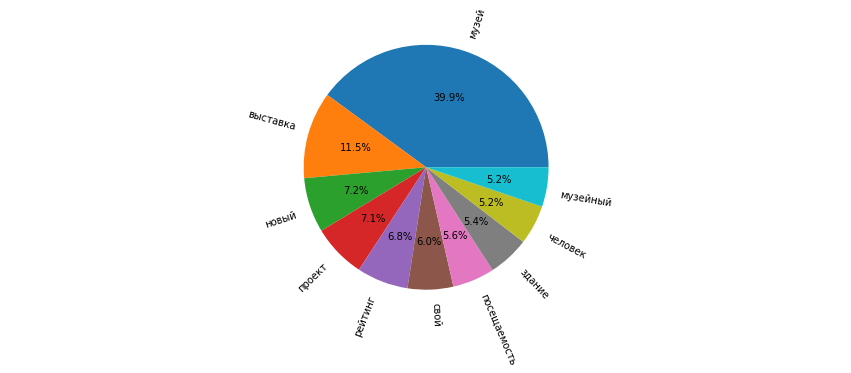


Реставрация


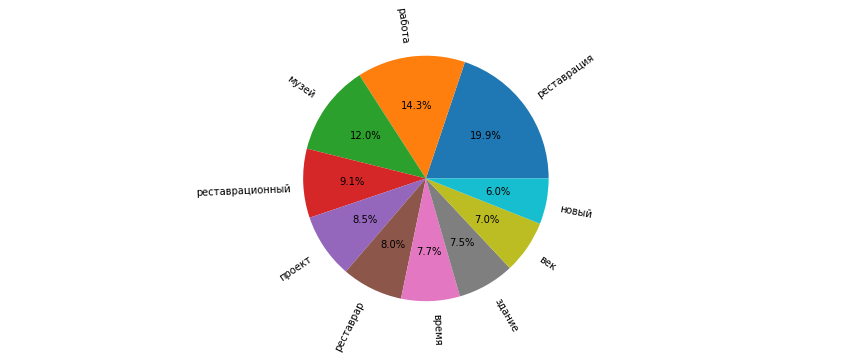


Интервью


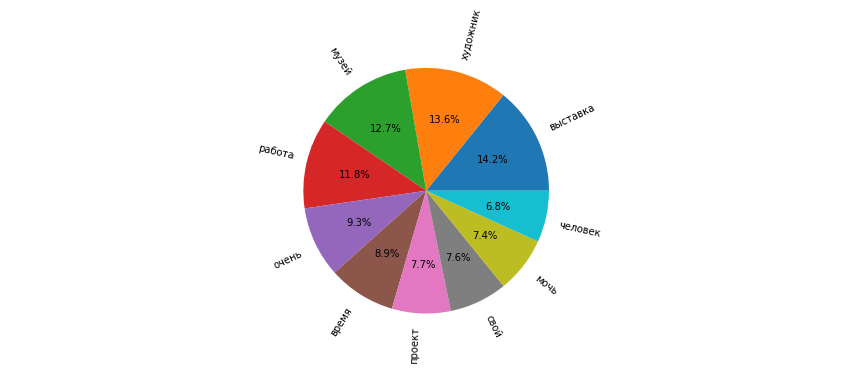


Мнения


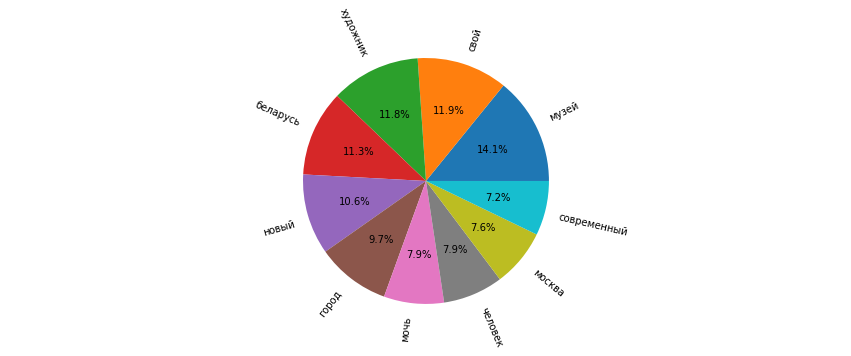


Премии и награды


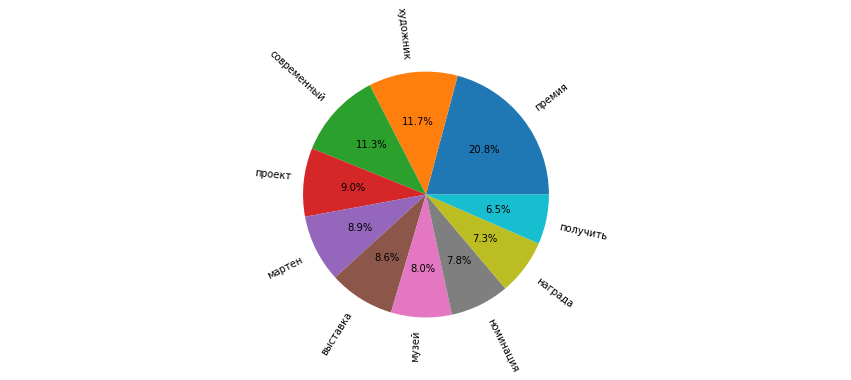


Книги


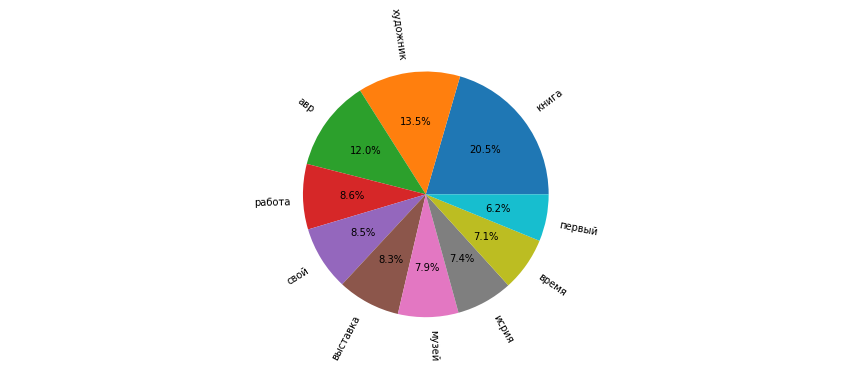


Художники


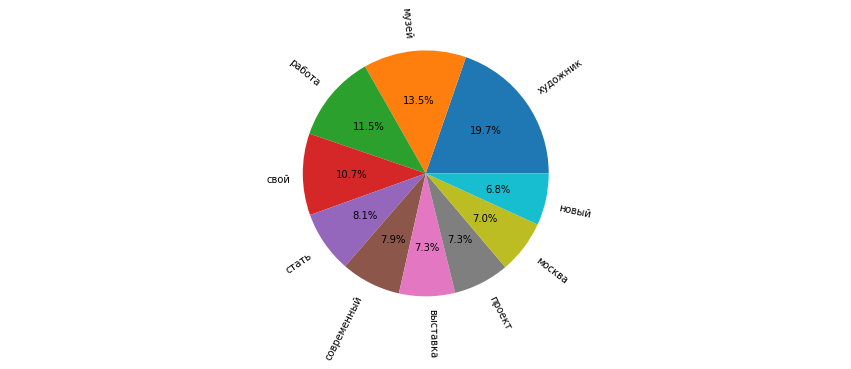


Архитектура


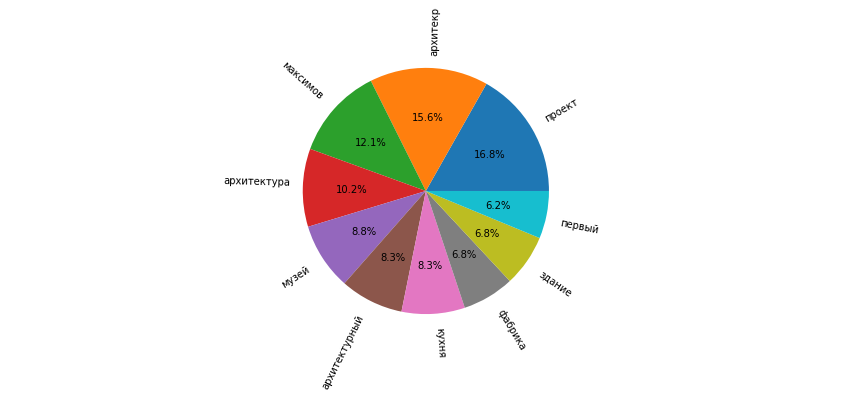


Роскошь


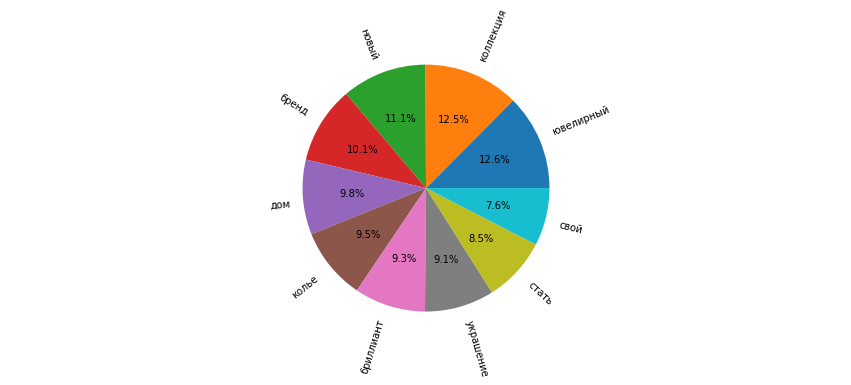


Спецпроект


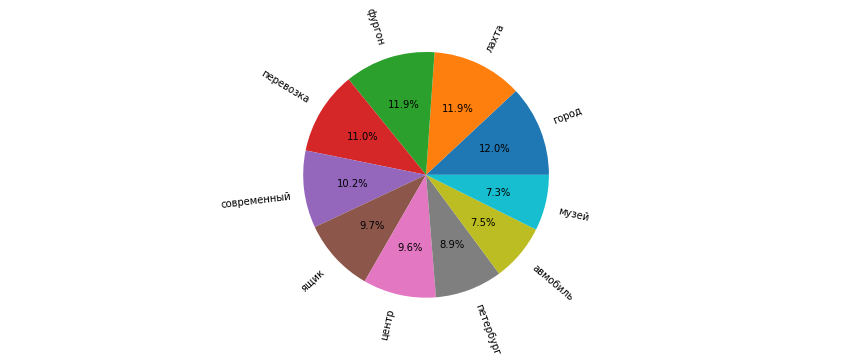


Великий Новгород Россия


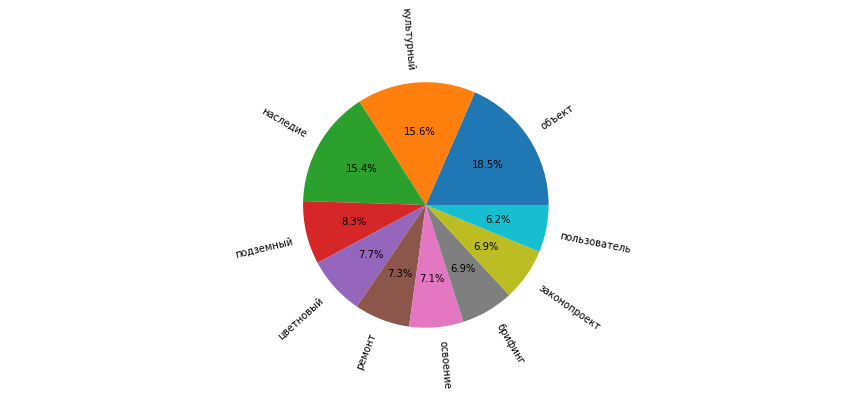

In [ ]:
for key, value in ten_words_dict.items():
  print(key)
  
  words = [k for k in value.keys()]
  rate = [round(v,5) for v in value.values()]

  fig, ax = plt.subplots()
  ax.pie(rate, labels=words, autopct='%1.1f%%', rotatelabels=True)
  ax.axis("equal")
  plt.show()
  print('')

In [ ]:
ten_words_counter = collections.Counter() # {word: its frequency}

for line in ten_words_dict.values():
  for word in line:
    ten_words_counter[word] += 1
  
print(len(ten_words_counter), end='\n\n')

90



In [ ]:
for k, v in sorted(ten_words_counter.items(), key=by_value, reverse=True)[:10]:
  print(k, '->', v)

музей -> 11
художник -> 10
работа -> 9
проект -> 9
свой -> 9
новый -> 8
выставка -> 7
современный -> 6
время -> 4
стать -> 3


In [ ]:
common_list = [k for k, v in sorted(ten_words_counter.items(), key=by_value, reverse=True) if v > 5]
common_list

['музей',
 'художник',
 'работа',
 'проект',
 'свой',
 'новый',
 'выставка',
 'современный']

In [ ]:
for word in common_list:
  print(word, end='\n\n')
  for k, v in ten_words_dict.items():
    if word in v.keys():
      print(k, '->', round(v[word], 5))
  print('', end='\n\n')

музей

Новости -> 0.488
Выставки -> 0.33785
Музей -> 0.68807
Реставрация -> 0.19699
Интервью -> 0.23947
Мнения -> 0.21013
Премии и награды -> 0.15539
Книги -> 0.12751
Художники -> 0.22277
Архитектура -> 0.16555
Спецпроект -> 0.12301


художник

Новости -> 0.18007
Арт-рынок -> 0.25868
Выставки -> 0.2705
Фестивали -> 0.22524
Кинофестиваль -> 0.1671
Интервью -> 0.25485
Мнения -> 0.17465
Премии и награды -> 0.22807
Книги -> 0.21643
Художники -> 0.32447


работа

Новости -> 0.16628
Арт-рынок -> 0.23212
Выставки -> 0.20444
Фестивали -> 0.12668
Кинофестиваль -> 0.12431
Реставрация -> 0.23419
Интервью -> 0.22237
Книги -> 0.13807
Художники -> 0.19011


проект

Новости -> 0.15338
Выставки -> 0.14353
Фестивали -> 0.16436
Музей -> 0.12207
Реставрация -> 0.13994
Интервью -> 0.145
Премии и награды -> 0.17544
Художники -> 0.12107
Архитектура -> 0.31606


свой

Новости -> 0.13934
Выставки -> 0.12614
Кинофестиваль -> 0.14439
Музей -> 0.10374
Интервью -> 0.14354
Мнения -> 0.17738
Книги -> 0.1359
Художни

In [ ]:
extra_words = common_list.copy()

NameError: ignored

In [ ]:
df_tanp_copy = df_tanp[['new_page_title', 'long_text_tok_cut']].copy()
df_tanp_copy['long_text_tok_cut'] = df_tanp_copy['long_text_tok_cut'].dropna().apply(reduce_text)

categories = pd.DataFrame(df_tanp_copy.groupby(['new_page_title'])['long_text_tok_cut'].apply(combine_text))


indexes_1 = ['Новости', 'Интервью', 'Выставки', 'Роскошь', 'Арт-рынок', 'Музей', 'Реставрация', 'Книги', 'Художники']

indexes_2 = ['Мнения', 'Премии и награды',
             'Архитектура', 'Спецпроект', 
             'Кинофестиваль', 'Фестивали', 'Ярмарки',
             'Великий Новгород Россия']

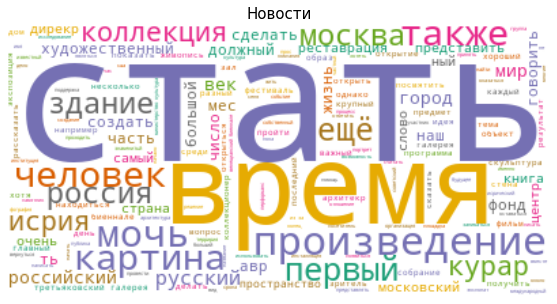

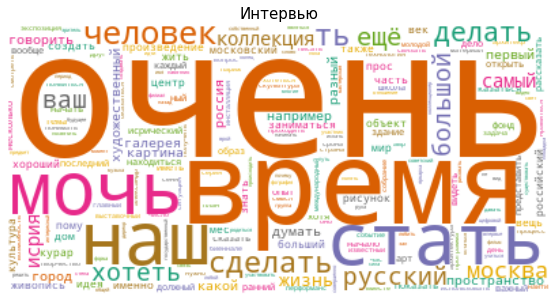

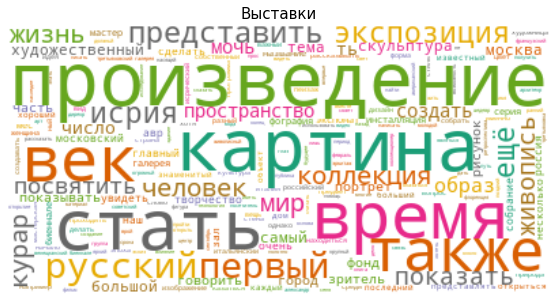

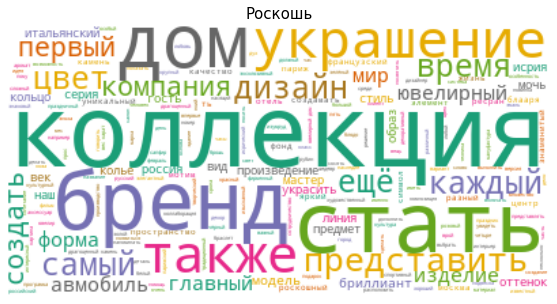

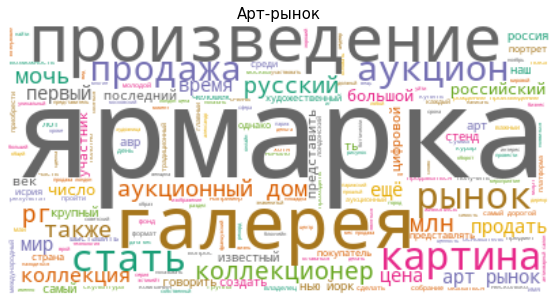

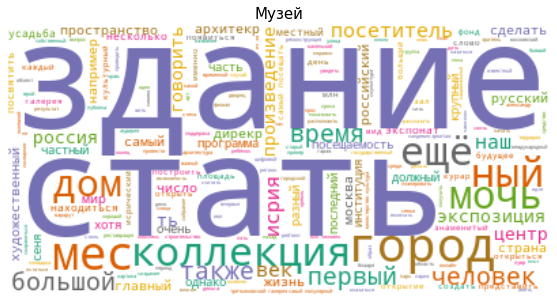

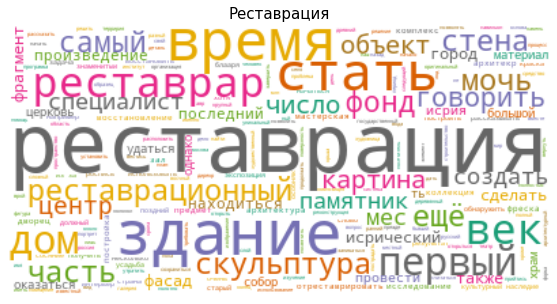

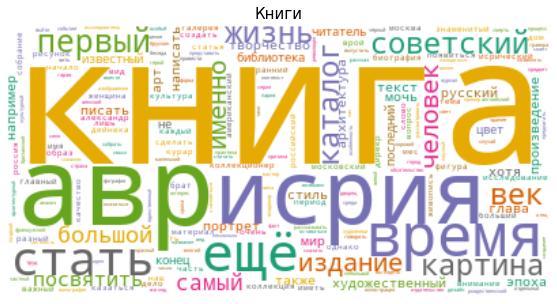

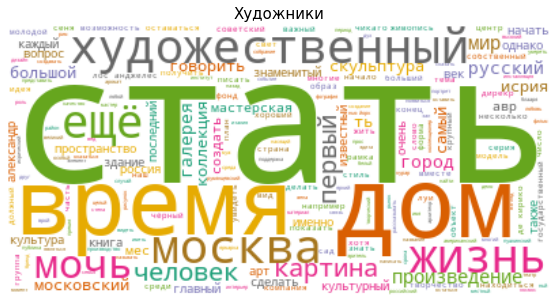

In [ ]:
# Let's make some word clouds
#wc = WordCloud(background_color="white", colormap="Dark2",
#               max_font_size=150, random_state=42)

plt.rcParams['figure.figsize'] = [15, 5]

# Create subplots for each genre
for index, category in enumerate(indexes_1):
  wc.generate(categories.long_text_tok_cut[category])
    
  plt.imshow(wc, interpolation="bilinear")
  plt.axis("off")
  plt.title(indexes_1[index], fontsize = 15)
  plt.show()

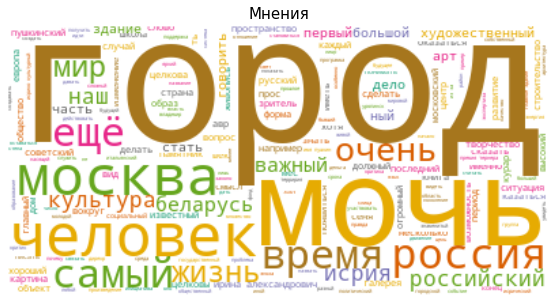

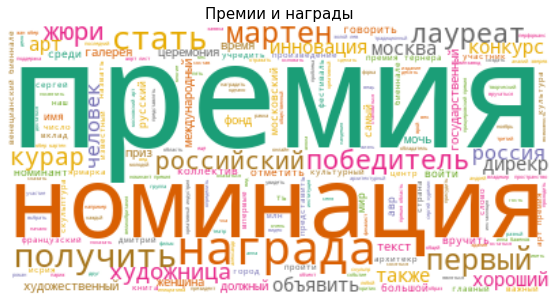

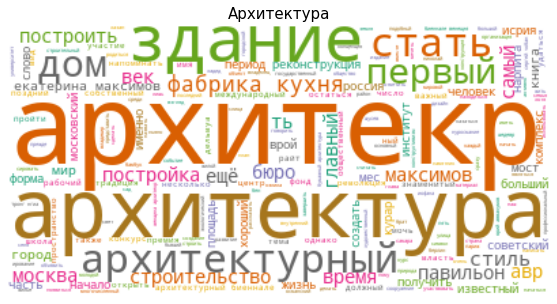

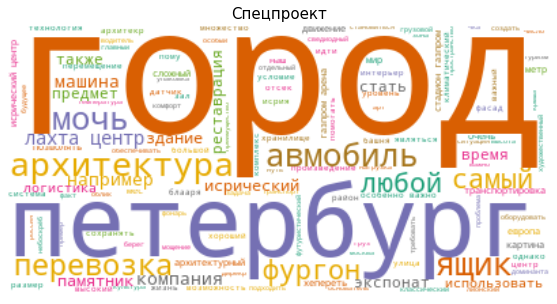

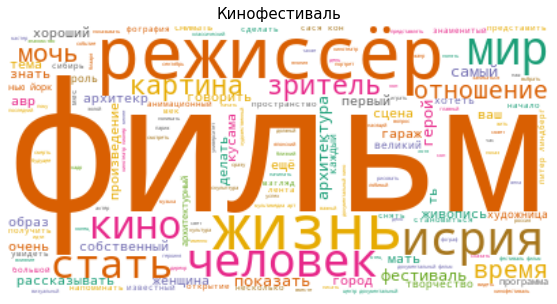

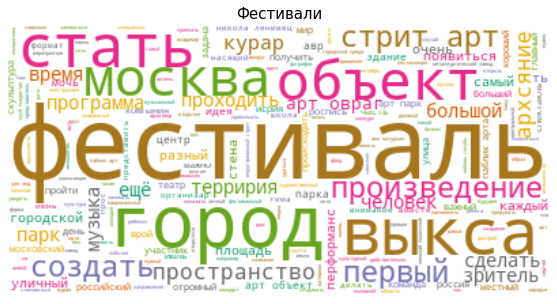

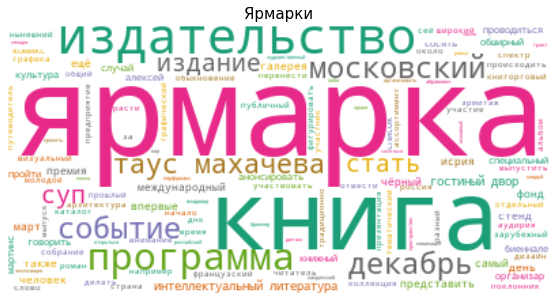

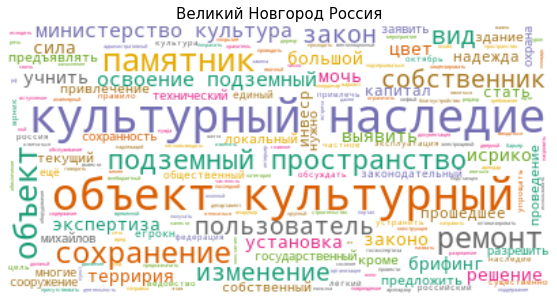

In [ ]:
plt.rcParams['figure.figsize'] = [15, 5]

# Create subplots for each genre
for index, category in enumerate(indexes_2):
  wc.generate(categories.long_text_tok_cut[category])
    
  plt.imshow(wc, interpolation="bilinear")
  plt.axis("off")
  plt.title(indexes_2[index], fontsize = 15)
  plt.show()

## tanp step 3 - all doc-s' word scoring

### one_doc_word_list reduction

In [ ]:
#categories = pd.DataFrame(df_tanp.groupby(['new_page_title'])['long_text_tok_cut'].apply(combine_text))

# Create a Vectorizer Object
c_vec.fit(df_tanp['long_text_tok_cut'])

# Printing the identified Unique words along with their indices
print("Vocabulary: ", len(c_vec.vocabulary_))

# We are going to create a document-term matrix using CountVectorizer
df_c_vec = c_vec.transform(df_tanp['long_text_tok_cut'])

df_dtm_c_vec = pd.DataFrame(df_c_vec.toarray(), columns=c_vec.get_feature_names())
df_dtm_c_vec.index = df_tanp.index
df_dtm_c_vec.head()

Vocabulary:  37808


,air,amuzработа,ar,archaeology,asterrvnегор,auctions,audi,azмузей,aрт,cg,...,ёдзь,ёкоям,ёлка,ёлочка,ёлочный,ёмкий,ёмко,ёмкость,ёситомый,ёхэя
0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,1,0,0,0
2,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [ ]:
all_doc_word_list = [col for col in df_dtm_c_vec.columns if df_dtm_c_vec[col].sum()>=len(df_dtm_c_vec.index)] # Documents count
print('Count of words presenting in each document:', len(all_doc_word_list))

Count of words presenting in each document: 24


In [ ]:
one_doc_word_list = [col for col in df_dtm_c_vec.columns if df_dtm_c_vec[col].sum()<=1]
print('Count of words presenting in one document:', len(one_doc_word_list))

Count of words presenting in one document: 15323


In [ ]:
file_name = theartnewspaper_w.replace('.csv', '') + '_' + str(datetime.now().date()) + '.csv'

while len(one_doc_word_list)>0:

  extra_words = one_doc_word_list.copy()
  df_tanp['long_text_tok_cut'] = df_tanp['long_text_tok_cut'].dropna().apply(reduced_text) # don't cut parts of words
  save_df_file(df_tanp, file_name, 'backup')

  # Checking
  c_vec.fit(df_tanp['long_text_tok_cut'])
  df_c_vec = c_vec.transform(df_tanp['long_text_tok_cut'])

  df_dtm_c_vec = pd.DataFrame(df_c_vec.toarray(), columns=c_vec.get_feature_names())
  df_dtm_c_vec.index = df_tanp.index

  one_doc_word_list = [col for col in df_dtm_c_vec.columns if df_dtm_c_vec[col].sum()<=1]
  print('Count of words presenting in one document:', len(one_doc_word_list))

print(file_name)

Count of words presenting in one document: 1023
Count of words presenting in one document: 1023
Count of words presenting in one document: 1023


KeyboardInterrupt: ignored

In [ ]:
#file_name = theartnewspaper_w.replace('.csv', '') + '_' + str(datetime.now().date()) + '.csv'
#file_name = theartnewspaper_w.replace('.csv', '') + '_' + str(datetime.now().date()) + '_2.csv'
#file_name = theartnewspaper_w.replace('.csv', '') + '_' + str(datetime.now().date()) + '_3.csv'
file_name = theartnewspaper_w.replace('.csv', '') + '_' + str(datetime.now().date()) + '_4.csv'
save_df_file(df_tanp, file_name, 'backup')
print(file_name)

/theartnewspaper_with_long_text_2022-07-01_4.csv


In [ ]:
# Checking
c_vec.fit(df_tanp['long_text_tok_cut'])
df_c_vec = c_vec.transform(df_tanp['long_text_tok_cut'])

df_dtm_c_vec = pd.DataFrame(df_c_vec.toarray(), columns=c_vec.get_feature_names())
df_dtm_c_vec.index = df_tanp.index

one_doc_word_list = [col for col in df_dtm_c_vec.columns if df_dtm_c_vec[col].sum()<=1]
print('Count of words presenting in one document:', len(one_doc_word_list))

Count of words presenting in one document: 1023


In [31]:
file_name = '/theartnewspaper_with_long_text_2022-07-01.csv' # _4
df_tanp = open_file_csv(file_name, 'backup')

df_tanp['title_tok_text'] = df_tanp['title_tok_new'].dropna().apply(lambda x: re.sub(r'\'|\[|\]|,', '', str(x)))

extra_words = ['это', 'год', 'который', 'искусство', 'весь', 'всё', 'то']
df_tanp['long_text_tok_cut'] = df_tanp['long_text_tok_cut'].dropna().apply(reduced_text) # don't cut parts of words
df_tanp['title_tok_cut'] = df_tanp['title_tok_text'].dropna().apply(reduced_text) # don't cut parts of words

In [29]:
cat_and_texts = pd.DataFrame(df_tanp.groupby(['new_page_title'])['long_text_tok_cut'].apply(combine_text))
cat_and_titles = pd.DataFrame(df_tanp.groupby(['new_page_title'])['title_tok_cut'].apply(combine_text))

indexes_1 = ['Новости', 'Интервью', 'Выставки', 'Роскошь', 'Арт-рынок', 'Музей', 'Реставрация', 'Книги', 'Художники']

indexes_2 = ['Мнения', 'Премии и награды',
             'Архитектура', 'Спецпроект', 
             'Кинофестиваль', 'Фестивали', 'Ярмарки',
             'Великий Новгород Россия']

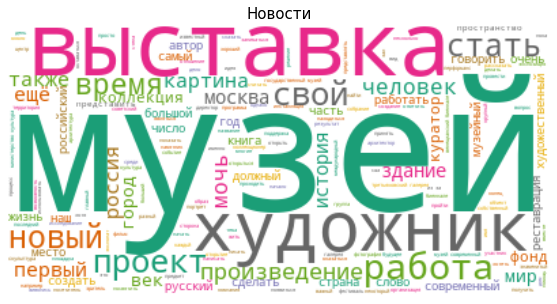

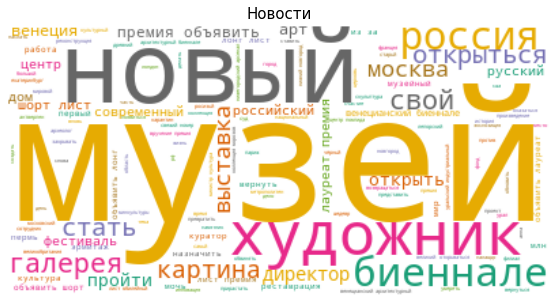

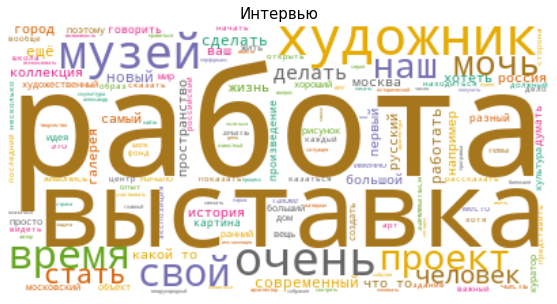

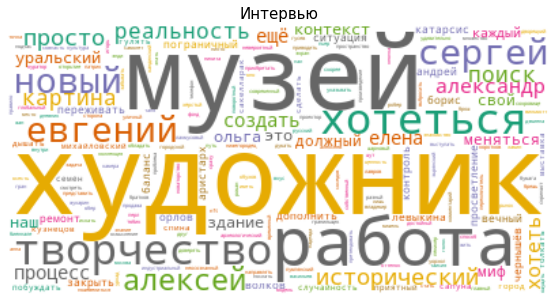

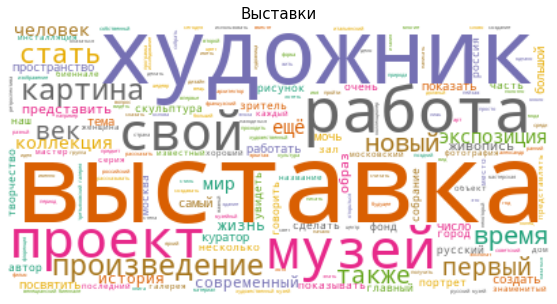

...

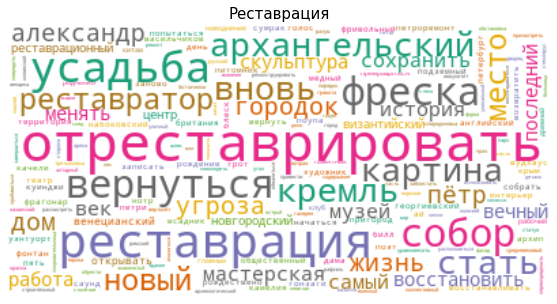

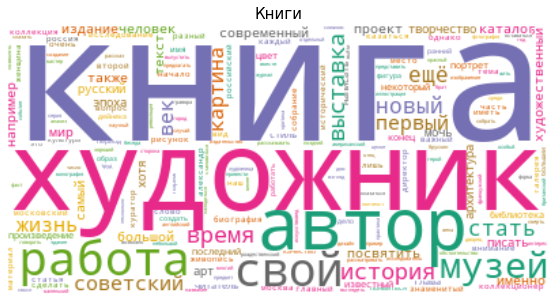

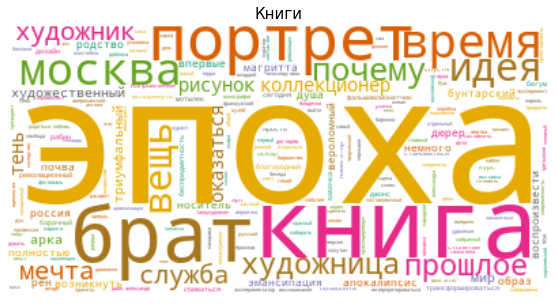

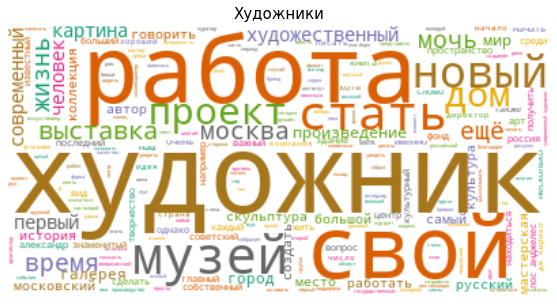

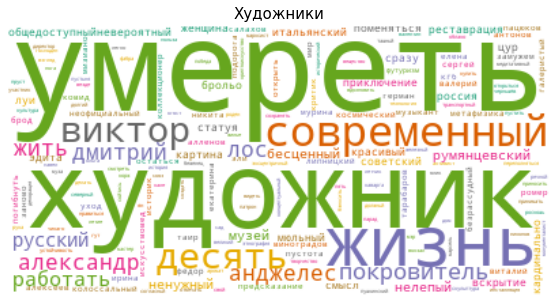

In [30]:
# Let's make some word clouds
wc = WordCloud(background_color="white", colormap="Dark2",
               max_font_size=150, random_state=0) # 42

plt.rcParams['figure.figsize'] = [15, 5]

# Create subplots for each genre
for index, category in enumerate(indexes_1):
  wc.generate(cat_and_texts.long_text_tok_cut[category])
    
  plt.imshow(wc, interpolation="bilinear")
  plt.axis("off")
  plt.title(indexes_1[index], fontsize = 15)
  plt.show()

  wc.generate(cat_and_titles.title_tok_cut[category])
    
  plt.imshow(wc, interpolation="bilinear")
  plt.axis("off")
  plt.title(indexes_1[index], fontsize = 15)
  plt.show()

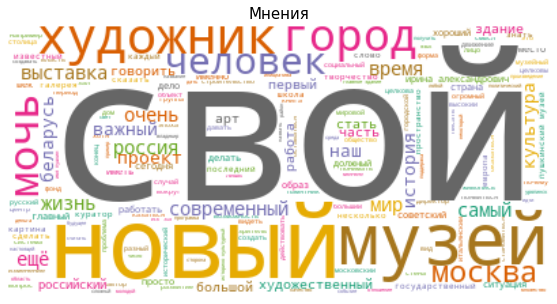

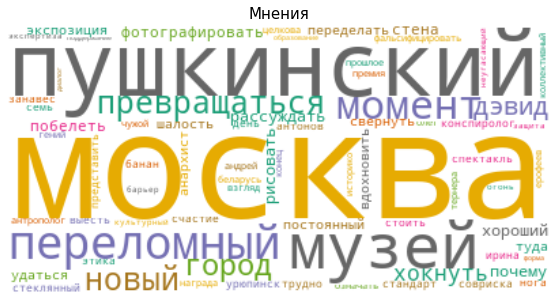

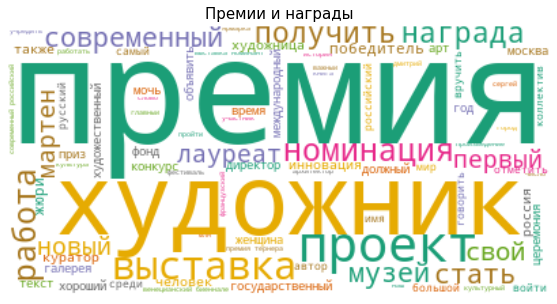

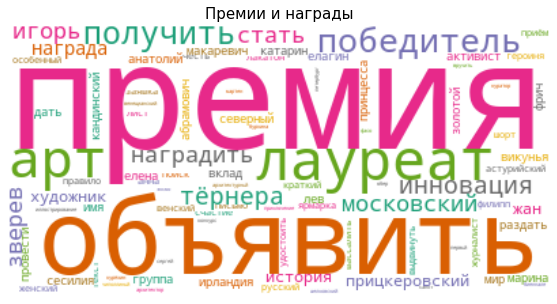

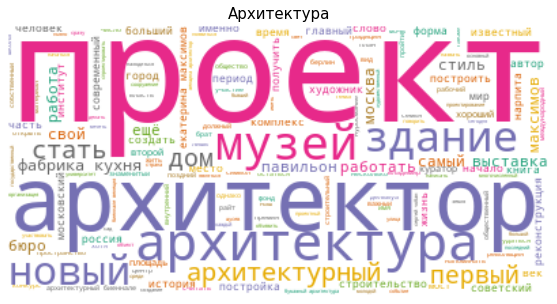

...

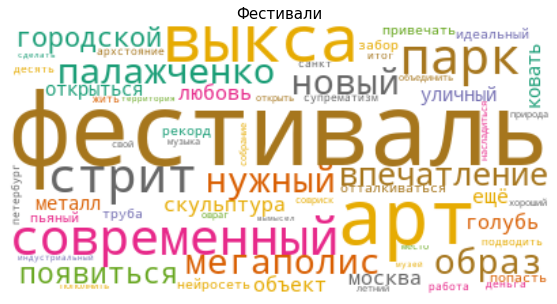

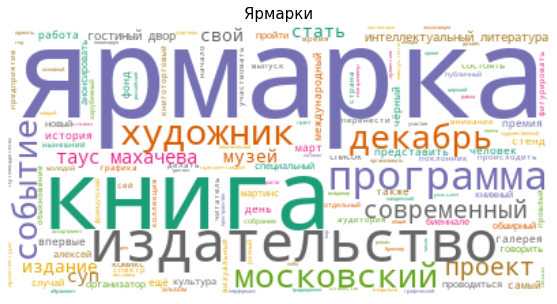

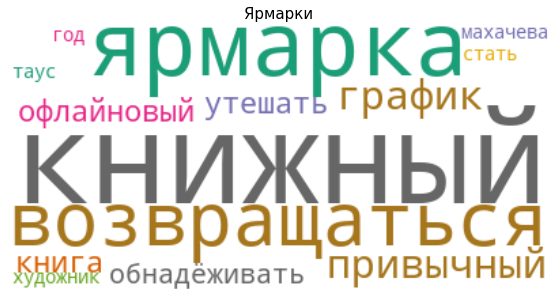

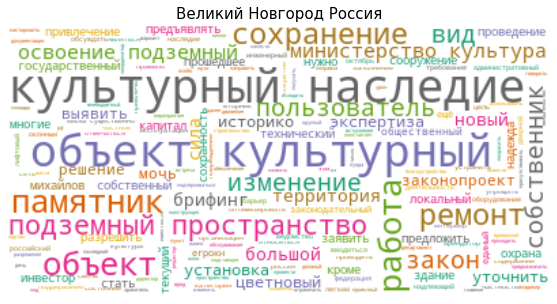

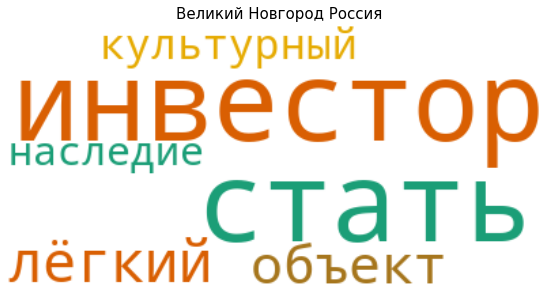

In [31]:
plt.rcParams['figure.figsize'] = [15, 5]

# Create subplots for each genre
for index, category in enumerate(indexes_2):
  wc.generate(cat_and_texts.long_text_tok_cut[category])
    
  plt.imshow(wc, interpolation="bilinear")
  plt.axis("off")
  plt.title(indexes_2[index], fontsize = 15)
  plt.show()

  wc.generate(cat_and_titles.title_tok_cut[category])

  plt.imshow(wc, interpolation="bilinear")
  plt.axis("off")
  plt.title(indexes_2[index], fontsize = 15)
  plt.show()

### ten_words_dict overview

In [10]:
from sklearn.feature_extraction.text import CountVectorizer, TfidfVectorizer


# Create a Vectorizer Object
tfidf_vec = TfidfVectorizer()
''' *, input="content", encoding="utf-8", decode_error="strict", strip_accents=None, lowercase=True, preprocessor=None, 
tokenizer=None, analyzer="word", stop_words=None, token_pattern=r"(?u)\b\w\w+\b", ngram_range=(1, 1), max_df=1, min_df=1, 
max_features=None, vocabulary=None, binary=False, dtype=np.float64, norm="l2", use_idf=True, smooth_idf=True, sublinear_tf=False
 '''


def by_value(item):
  return item[1]

In [12]:
# Create a Vectorizer Object
tfidf_vec.fit(df_tanp['long_text_tok_cut'])

# Printing the identified Unique words along with their indices
print("Vocabulary: ", len(tfidf_vec.vocabulary_))

# We are going to create a document-term matrix using CountVectorizer
df_tfidf_vec = tfidf_vec.transform(df_tanp['long_text_tok_cut'])

Vocabulary:  23508


In [13]:
df_dtm_tfidf_vec = pd.DataFrame(df_tfidf_vec.toarray(), columns=tfidf_vec.get_feature_names())
df_dtm_tfidf_vec['new_page_title'] = df_tanp['new_page_title'].tolist()
df_dtm_tfidf_vec.index = df_tanp.index
print(len(df_tanp.index), end='\n\n')
print(len(df_dtm_tfidf_vec.index), end='\n\n')
print(df_dtm_tfidf_vec['new_page_title'].nunique(), end='\n\n')
df_dtm_tfidf_vec.head()

1234

1234

17



,air,ar,archaeology,auctions,audi,azмузей,aрт,cg,cosmoscow,cube,...,ящерица,ящик,яэль,ёлка,ёлочка,ёлочный,ёмкий,ёмко,ёмкость,new_page_title
0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,Реставрация
1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.031028,0.0,Интервью
2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,Интервью
3,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,Интервью
4,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,Интервью


In [36]:
df_dtm_tfidf_vec.groupby(['new_page_title']).sum()

,air,ar,archaeology,auctions,audi,azмузей,aрт,cg,cosmoscow,cube,...,ящер,ящерица,ящик,яэль,ёлка,ёлочка,ёлочный,ёмкий,ёмко,ёмкость
new_page_title,,,,,,,,,,,,,,,,,,,,,
Арт-рынок,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.065287,0.065408,0.000000,...,0.000000,0.049640,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.036453
Архитектура,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
Великий Новгород Россия,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
Выставки,0.000000,0.109811,0.000000,0.059446,0.000000,0.000000,0.000000,0.000000,0.000000,0.059446,...,0.000000,0.123662,0.129950,0.000000,0.101065,0.045079,0.000000,0.000000,0.034333,0.000000
Интервью,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.023900,0.030259,0.034872,0.000000,0.041124,0.076619,0.031028,0.000000
Кинофестиваль,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.034468,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
Книги,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.067747,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
Мнения,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
Музей,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.116138,0.000000,0.133496,0.000000,0.104157,0.000000,0.000000,0.034535,0.000000,0.000000


In [ ]:
dictionary = df_dtm_tfidf_vec.groupby(['new_page_title']).sum().to_dict(orient='index')
print(len(dictionary), end='\n\n')

ten_words_dict = {}
indexes = list(dictionary.keys())
for cut in indexes:
  ten_words_dict.setdefault(cut, {k: v for k, v in sorted(dictionary[cut].items(), key=by_value, reverse=True)[:10]})
print(len(ten_words_dict), end='\n\n')

17

17

Арт-рынок


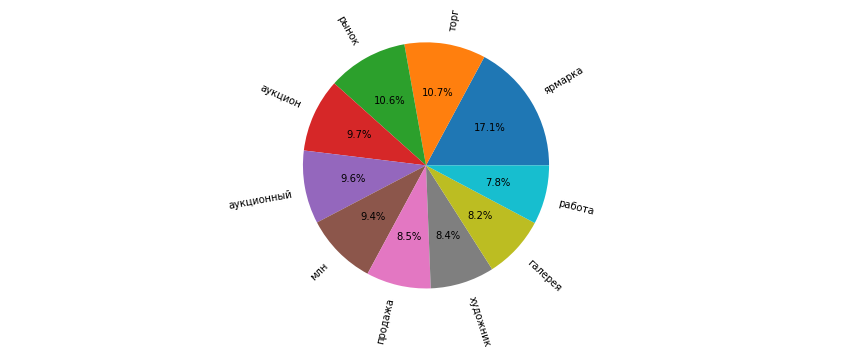


Архитектура


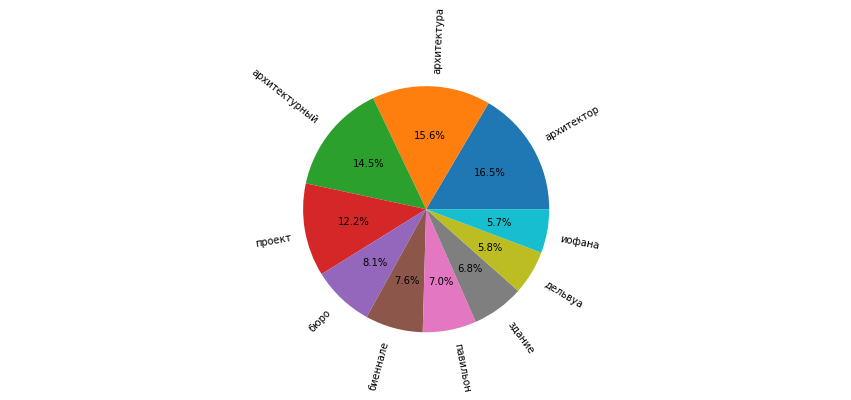


Великий Новгород Россия


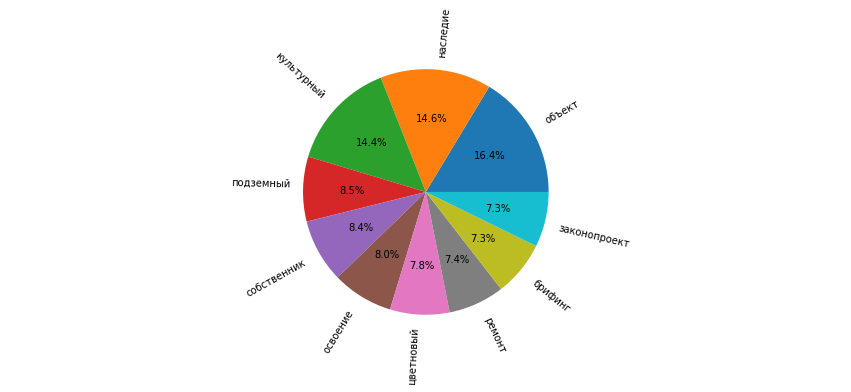


Выставки


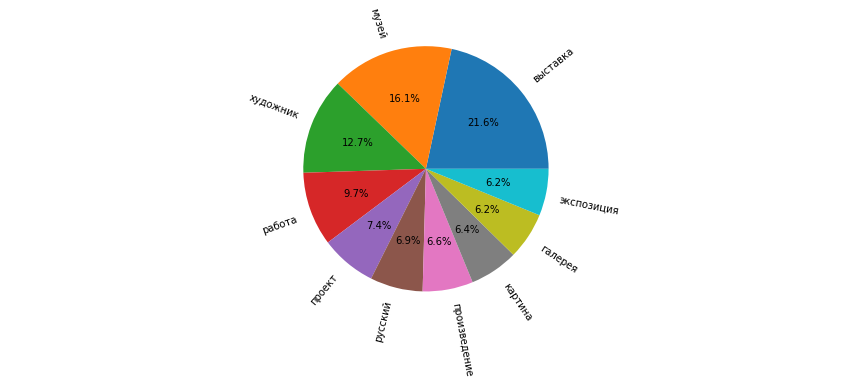


Интервью


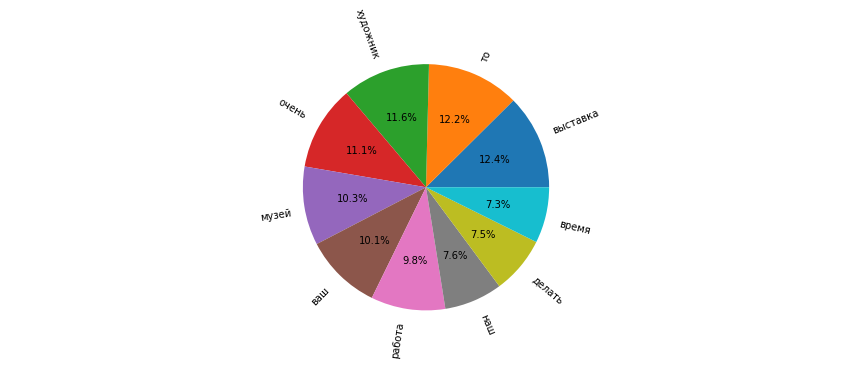


Кинофестиваль


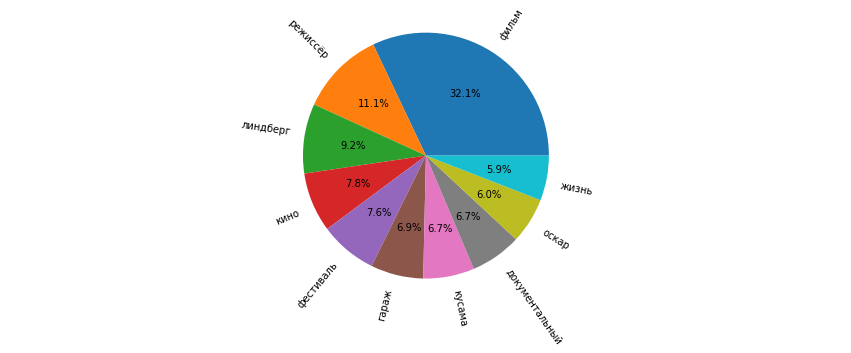


Книги


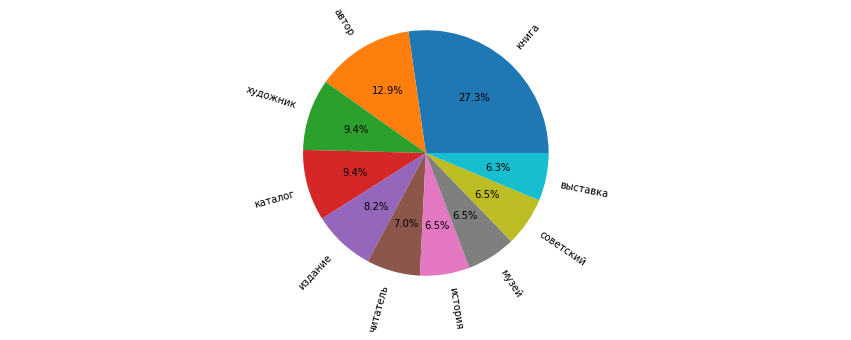


Мнения


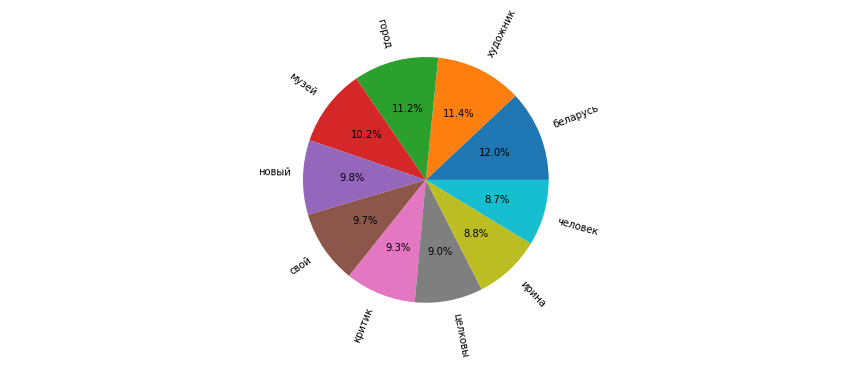


Музей


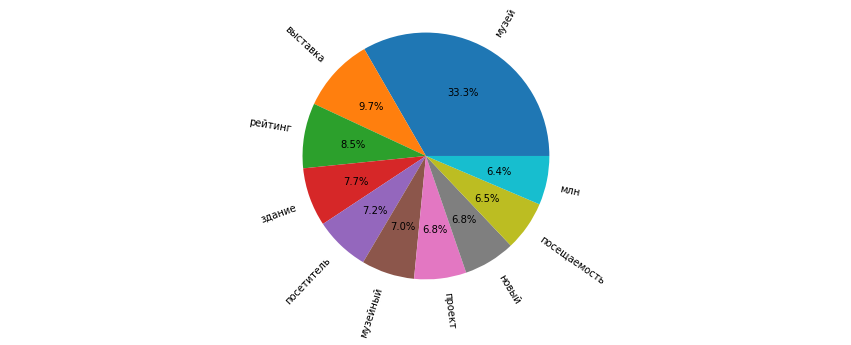


Новости


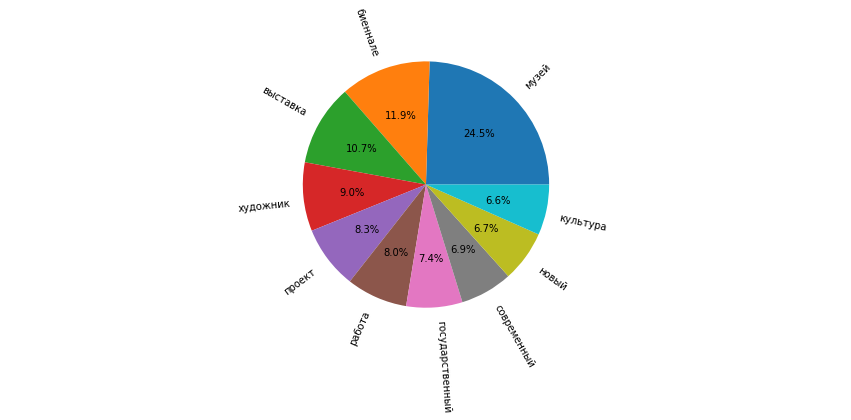


Премии и награды


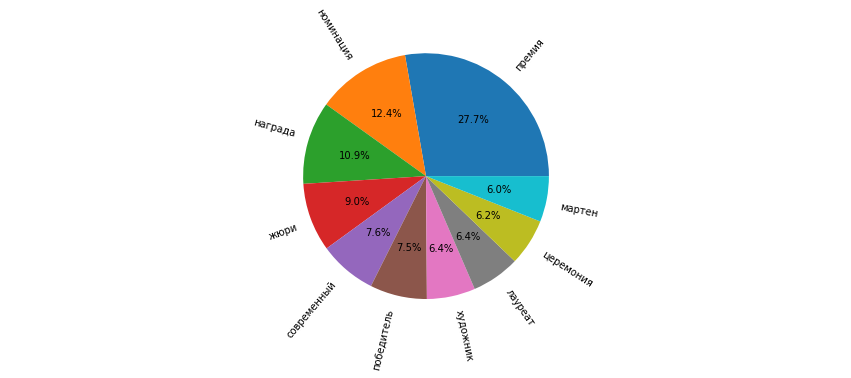


Реставрация


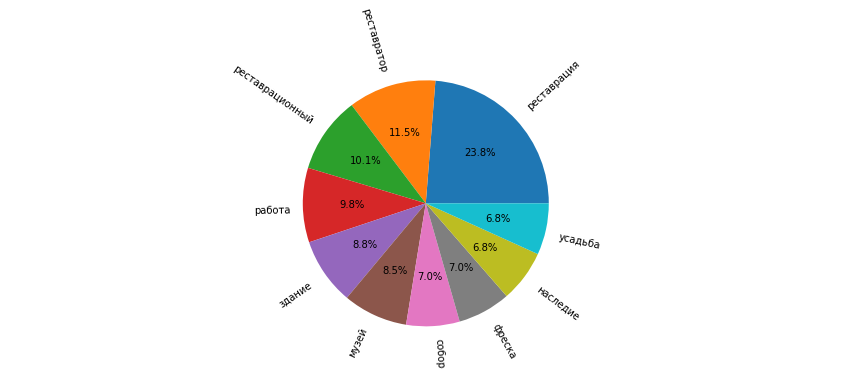


Роскошь


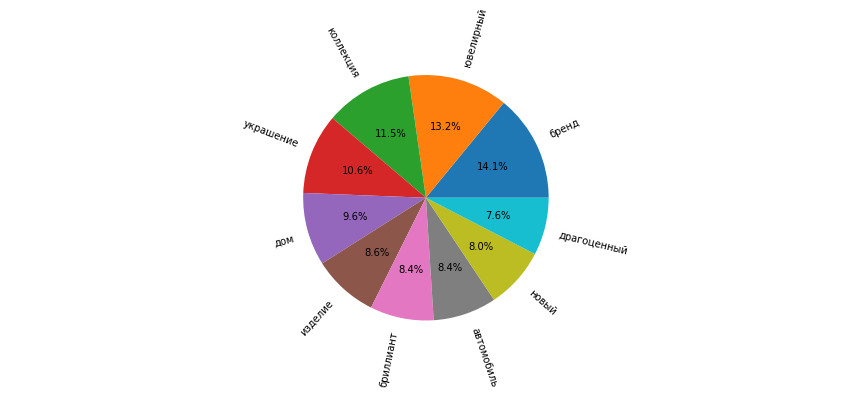


Спецпроект


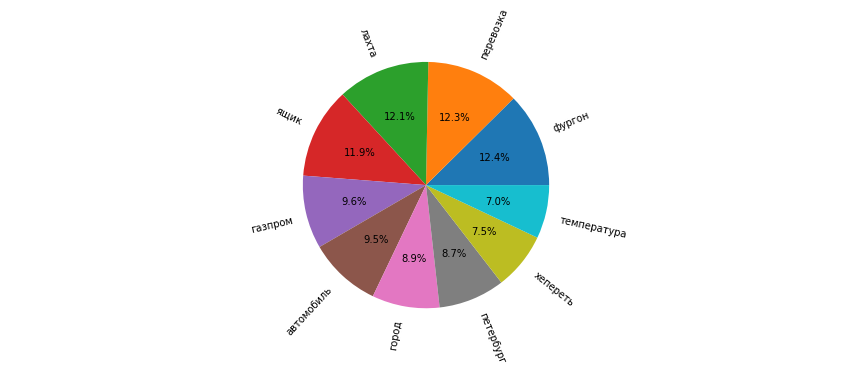


Фестивали


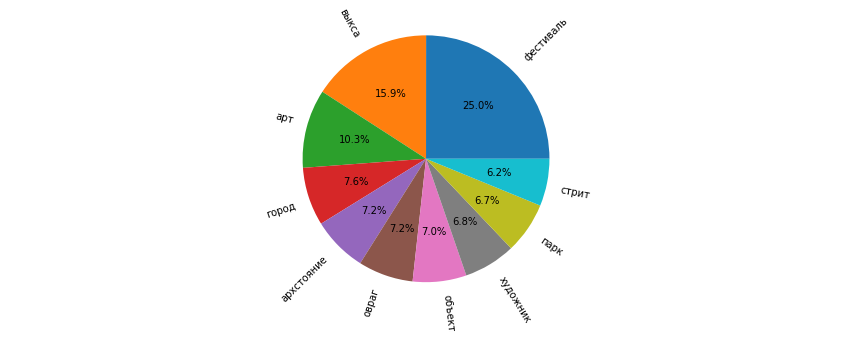


Художники


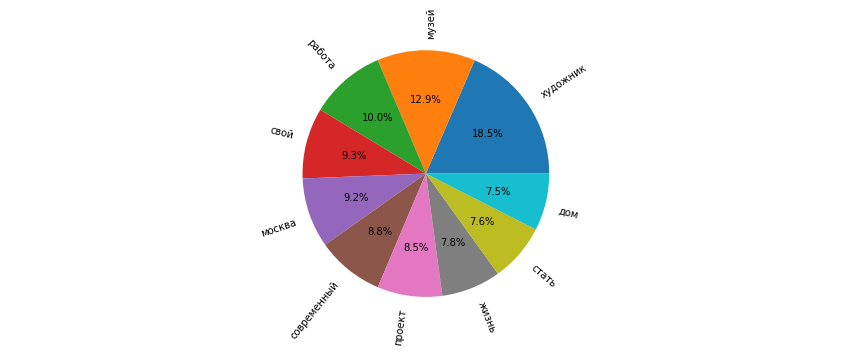


Ярмарки


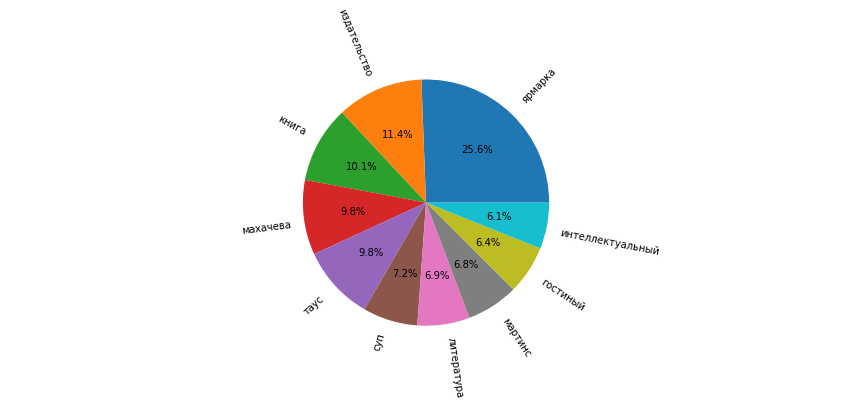

In [44]:
for key, value in ten_words_dict.items():
  print(key)
  
  words = [k for k in value.keys()]
  rate = [round(v,5) for v in value.values()]

  fig, ax = plt.subplots()
  ax.pie(rate, labels=words, autopct='%1.1f%%', rotatelabels=True)
  ax.axis("equal")
  plt.show()
  print('')

### MiniBatchKMeans: number of clusters

In [14]:
df_dtm_tfidf_vec_ = df_dtm_tfidf_vec.drop('new_page_title', axis=1)
df_dtm_tfidf_vec_.head()

,air,ar,archaeology,auctions,audi,azмузей,aрт,cg,cosmoscow,cube,...,ящер,ящерица,ящик,яэль,ёлка,ёлочка,ёлочный,ёмкий,ёмко,ёмкость
0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0
1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.031028,0.0
2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0
3,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0
4,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0


In [15]:
from sklearn.cluster import MiniBatchKMeans

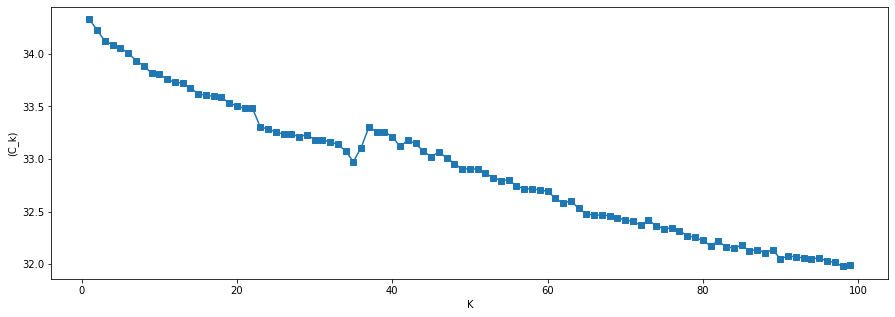

In [48]:
'''
метод «локтя»
Для того чтобы определить какое «K» нам нужно взять, нужно взглянуть на график и найти ту точку, 
после которой инерция начнёт почти линейно уменьшаться.
'''

inertia = []
# В параметры range устанавливается начальное количество кластеров, конечное и шаг для перебора
for k in range(1,100,1):
    mbk = MiniBatchKMeans(n_clusters=k, init='random', random_state=1).fit(df_dtm_tfidf_vec_)
    #n_clusters=8, *, init='k-means++', max_iter=100, batch_size=1024, verbose=0, compute_labels=True, random_state=None,
    #tol=0.0, max_no_improvement=10, init_size=None, n_init=3, reassignment_ratio=0.01
    inertia.append(np.sqrt(mbk.inertia_))
plt.plot(range(1,100,1), inertia, marker='s')
plt.xlabel('K')
plt.ylabel('(C_k)')
plt.show()

# 40 ?????????

In [16]:
cut_cat_list = ['Выставки', 'Роскошь', 'Арт-рынок', 'Музей', 'Реставрация', 'Книги', 'Художники', 'Премии и награды',
                'Архитектура', 'Спецпроект', 'Кинофестиваль', 'Фестивали', 'Ярмарки', 
                'Великий Новгород Россия'] # 'Новости', 'Интервью', 'Мнения', 

df_dtm_tfidf_vec_ = df_dtm_tfidf_vec.loc[df_dtm_tfidf_vec['new_page_title'].isin(cut_cat_list)].drop('new_page_title', axis=1)
df_dtm_tfidf_vec_.shape

(825, 23508)

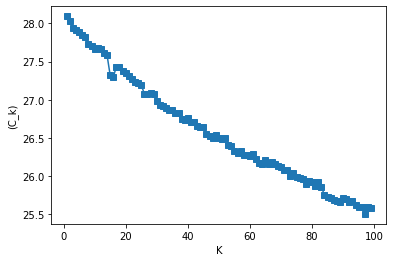

In [17]:
inertia = []
# В параметры range устанавливается начальное количество кластеров, конечное и шаг для перебора
for k in range(1,100,1):
    mbk = MiniBatchKMeans(n_clusters=k, init='random', random_state=1).fit(df_dtm_tfidf_vec_)
    #n_clusters=8, *, init='k-means++', max_iter=100, batch_size=1024, verbose=0, compute_labels=True, random_state=None,
    #tol=0.0, max_no_improvement=10, init_size=None, n_init=3, reassignment_ratio=0.01
    inertia.append(np.sqrt(mbk.inertia_))
plt.plot(range(1,100,1), inertia, marker='s')
plt.xlabel('K')
plt.ylabel('(C_k)')
plt.show()

# 20 ??????????

### main words overview

In [61]:
# get the column name of max values in every row
df_dtm_tfidf_vec_['main_word'] = df_dtm_tfidf_vec_.idxmax(axis=1)
df_dtm_tfidf_vec_['main_word'].nunique()

911

In [69]:
df_dtm_tfidf_vec['main_word'] = df_dtm_tfidf_vec_['main_word'].tolist()

categories = pd.DataFrame(df_dtm_tfidf_vec.groupby(['new_page_title'])['main_word'].apply(combine_lists))

#categories
for cat in categories.index:
  print(cat, ':', len(categories.loc[cat]['main_word']))
  print(categories.loc[cat]['main_word'], end='\n\n')

Арт-рынок : 62
['масса', 'нарышкин', 'женщина', 'автограф', 'стартап', 'полугодие', 'ярмарка', 'куинджи', 'вандализм', 'табар', 'дроп', 'делестр', 'амман', 'магритта', 'мандзонь', 'фрейд', 'антикварный', 'цифровой', 'рисунок', 'рынок', 'млн', 'африканский', 'премия', 'лис', 'эстиметь', 'ректор', 'русский', 'кук', 'торг', 'макдугалл', 'турецкий', 'токен', 'nft', 'мэрилин', 'риджентс', 'маршессо', 'стенд', 'метрополитен', 'лампас', 'сделка', 'триптих', 'восточный', 'аукционный', 'блокчейн', 'кало', 'дженнингс', 'лос', 'футбол', 'токенизация', 'аукцион', 'кисть', 'салон', 'эрмитаж', 'боттичелли', 'вульф', 'клиент', 'бэнксить', 'галерея', 'натюрморт', 'лимонов', 'овчаренко', 'цена']

Архитектура : 19
['филармония', 'чобан', 'андо', 'дельвуа', 'павильон', 'райт', 'саркис', 'архитектор', 'аввакумов', 'телеграф', 'пунина', 'генуя', 'биеннале', 'вингордый', 'максимов', 'макнамар', 'нуросмание', 'иофана', 'нгиа']

Великий Новгород Россия : 1
['объект']

Выставки : 242
['икона', 'защититься', 'в

In [70]:
# Create a Vectorizer Object
c_vec = CountVectorizer()
'''
 *, input="content", encoding="utf-8", decode_error="strict", strip_accents=None, lowercase=True, preprocessor=None, 
tokenizer=None, stop_words=None, token_pattern=r"(?u)\b\w\w+\b", ngram_range=(1, 1), analyzer="word", max_df=1, min_df=1, 
max_features=None, vocabulary=None, binary=False, dtype=np.int64 
'''

# Create a Vectorizer Object
c_vec.fit(df_tanp['long_text_tok_cut'])

# Printing the identified Unique words along with their indices
print("Vocabulary: ", len(c_vec.vocabulary_))

# We are going to create a document-term matrix using CountVectorizer
df_c_vec = c_vec.transform(df_tanp['long_text_tok_cut'])

df_dtm_c_vec = pd.DataFrame(df_c_vec.toarray(), columns=c_vec.get_feature_names())
df_dtm_c_vec.index = df_tanp.index
df_dtm_c_vec.head()

Vocabulary:  23508


,air,ar,archaeology,auctions,audi,azмузей,aрт,cg,cosmoscow,cube,...,ящер,ящерица,ящик,яэль,ёлка,ёлочка,ёлочный,ёмкий,ёмко,ёмкость
0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,1,0
2,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [71]:
# get the column name of max values in every row
df_dtm_c_vec['main_word'] = df_dtm_c_vec.idxmax(axis=1)
df_dtm_c_vec['main_word'].nunique()

532

In [72]:
df_dtm_c_vec['new_page_title'] = df_tanp['new_page_title'].tolist()

categories_cv = pd.DataFrame(df_dtm_c_vec.groupby(['new_page_title'])['main_word'].apply(combine_lists))

for cat in categories_cv.index:
  print(cat, ':', len(categories_cv.loc[cat]['main_word']))
  print(categories_cv.loc[cat]['main_word'], end='\n\n')

Арт-рынок : 45
['масса', 'женщина', 'автограф', 'стартап', 'ярмарка', 'делестр', 'работа', 'магритта', 'день', 'художник', 'произведение', 'рынок', 'млн', 'платформа', 'свой', 'современный', 'музей', 'премия', 'лис', 'новый', 'ректор', 'русский', 'торг', 'мэрилин', 'триптих', 'восточный', 'аукционный', 'коллекция', 'фабержа', 'кало', 'награда', 'продажа', 'арт', 'салон', 'эрмитаж', 'боттичелли', 'коллекционер', 'бэнксить', 'клиент', 'галерея', 'выставка', 'картина', 'фонд', 'дом', 'рисунок']

Архитектура : 18
['османский', 'музей', 'максимов', 'архитектор', 'архитектурный', 'аввакумов', 'иофана', 'биеннале', 'архитектура', 'павильон', 'дом', 'проект', 'дельвуа', 'сергей', 'нгиа', 'мост', 'здание', 'макнамар']

Великий Новгород Россия : 1
['объект']

Выставки : 171
['советский', 'икона', 'помпида', 'возрождение', 'васильев', 'давид', 'природа', 'издание', 'работа', 'виртуальный', 'нерон', 'виго', 'художник', 'пакулин', 'виола', 'монета', 'буржуа', 'восстание', 'пейзаж', 'сергей', 'эпиче

### five_words_dict overview

In [77]:
five_words_dict = {}
indexes = list(dictionary.keys())
for cut in indexes:
  five_words_dict.setdefault(cut, {k: v for k, v in sorted(dictionary[cut].items(), key=by_value, reverse=True)[:5]})
print(len(five_words_dict), end='\n\n')

17



Арт-рынок


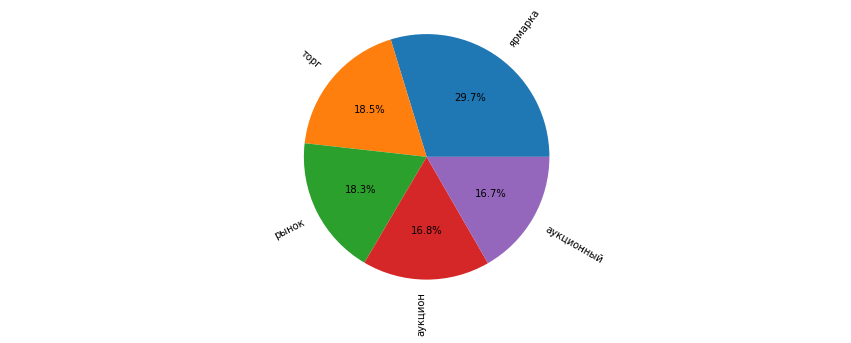

Items count 95
Word ярмарка appears zero times 52
Word торг appears zero times 42
Word рынок appears zero times 27
Word аукцион appears zero times 34
Word аукционный appears zero times 45
Word new_page_title appears zero times 0

Архитектура


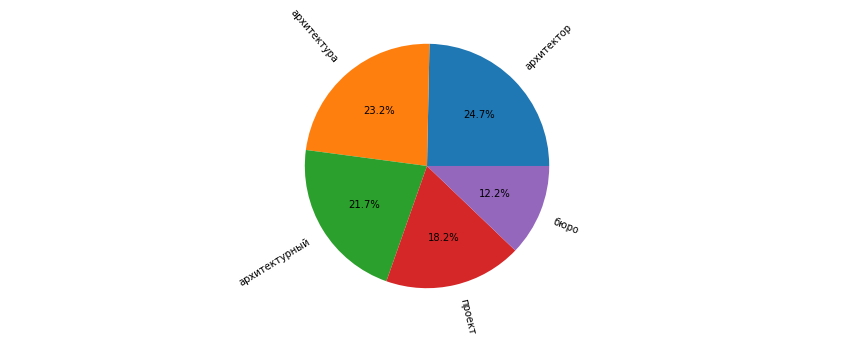

Items count 19
Word архитектор appears zero times 2
Word архитектура appears zero times 5
Word архитектурный appears zero times 2
Word проект appears zero times 1
Word бюро appears zero times 11
Word new_page_title appears zero times 0

Великий Новгород Россия


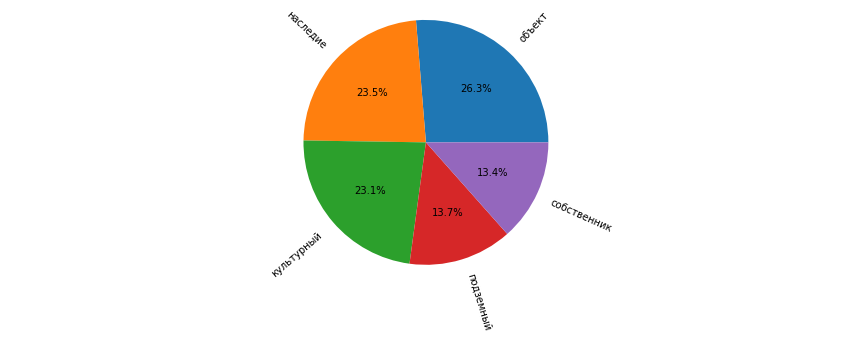

Items count 1
Word объект appears zero times 0
Word наследие appears zero times 0
Word культурный appears zero times 0
Word подземный appears zero times 0
Word собственник appears zero times 0
Word new_page_title appears zero times 0

Выставки


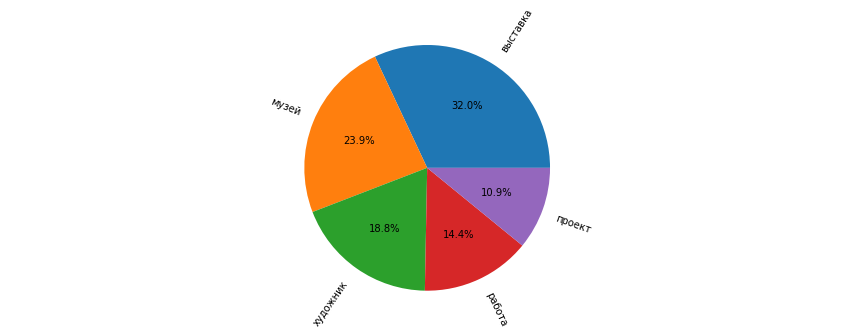

Items count 274
Word выставка appears zero times 14
Word музей appears zero times 63
Word художник appears zero times 54
Word работа appears zero times 51
Word проект appears zero times 107
Word new_page_title appears zero times 0

Интервью


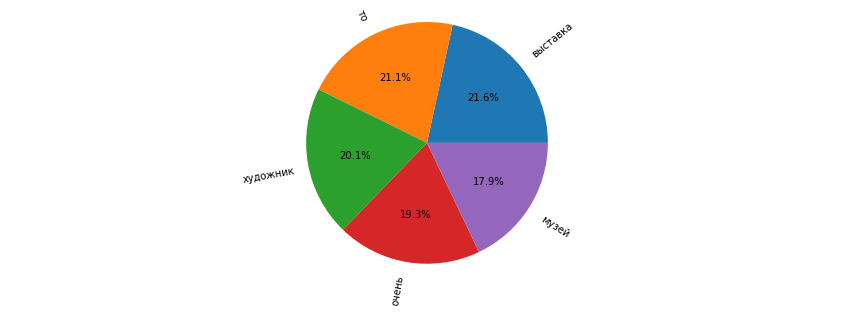

Items count 44
Word выставка appears zero times 3
Word то appears zero times 2
Word художник appears zero times 4
Word очень appears zero times 4
Word музей appears zero times 9
Word new_page_title appears zero times 0

Кинофестиваль


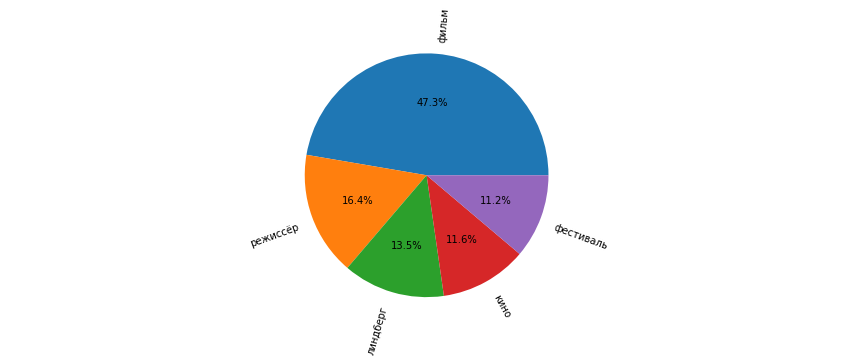

Items count 22
Word фильм appears zero times 0
Word режиссёр appears zero times 5
Word линдберг appears zero times 17
Word кино appears zero times 5
Word фестиваль appears zero times 4
Word new_page_title appears zero times 0

Книги


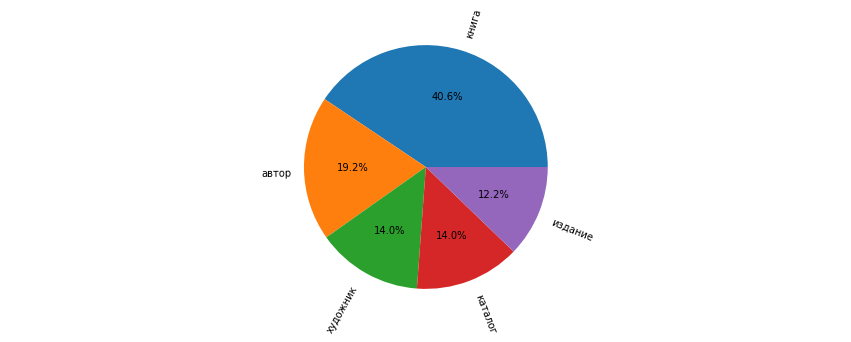

Items count 47
Word книга appears zero times 1
Word автор appears zero times 11
Word художник appears zero times 14
Word каталог appears zero times 33
Word издание appears zero times 24
Word new_page_title appears zero times 0

Мнения


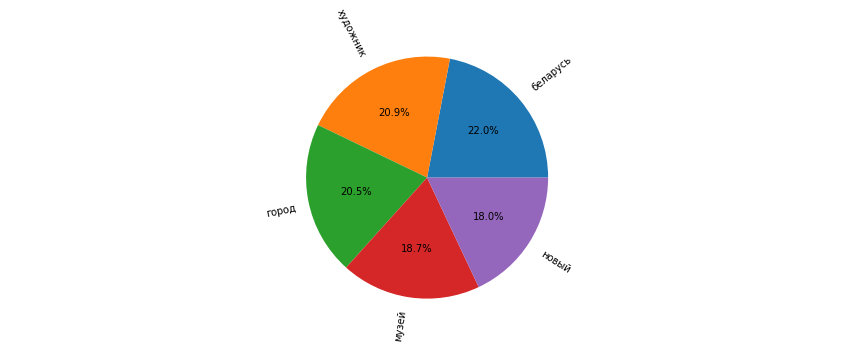

Items count 16
Word беларусь appears zero times 15
Word художник appears zero times 4
Word город appears zero times 10
Word музей appears zero times 6
Word новый appears zero times 6
Word new_page_title appears zero times 0

Музей


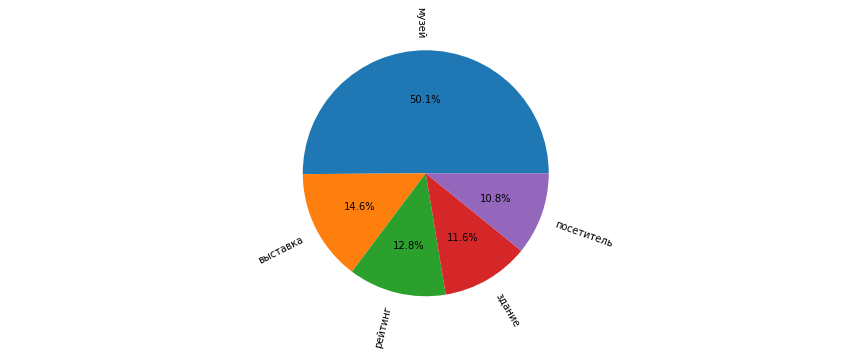

Items count 111
Word музей appears zero times 3
Word выставка appears zero times 25
Word рейтинг appears zero times 91
Word здание appears zero times 39
Word посетитель appears zero times 55
Word new_page_title appears zero times 0

Новости


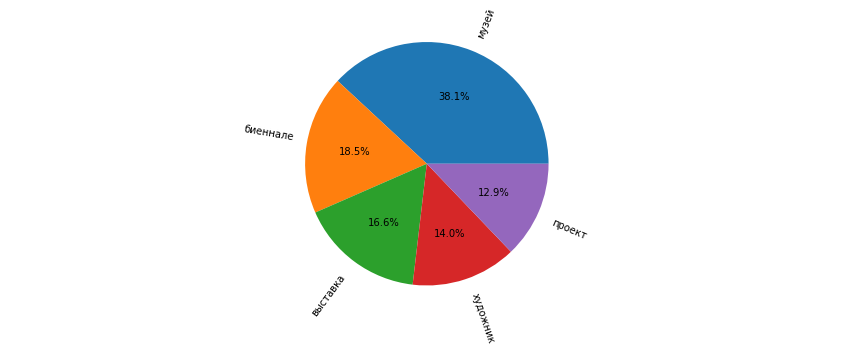

Items count 349
Word музей appears zero times 83
Word биеннале appears zero times 266
Word выставка appears zero times 140
Word художник appears zero times 140
Word проект appears zero times 136
Word new_page_title appears zero times 0

Премии и награды


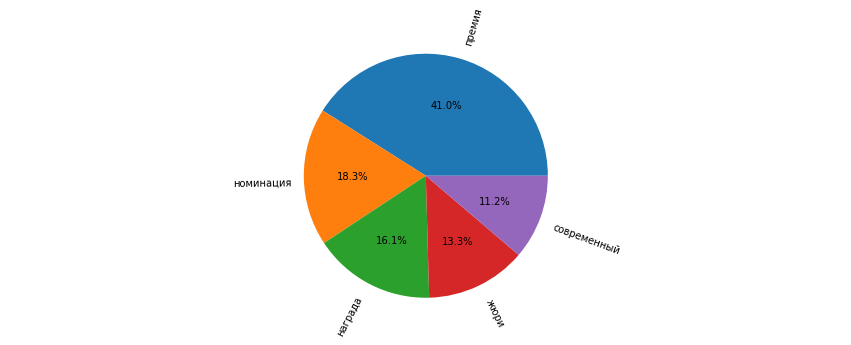

Items count 22
Word премия appears zero times 2
Word номинация appears zero times 8
Word награда appears zero times 5
Word жюри appears zero times 8
Word современный appears zero times 2
Word new_page_title appears zero times 0

Реставрация


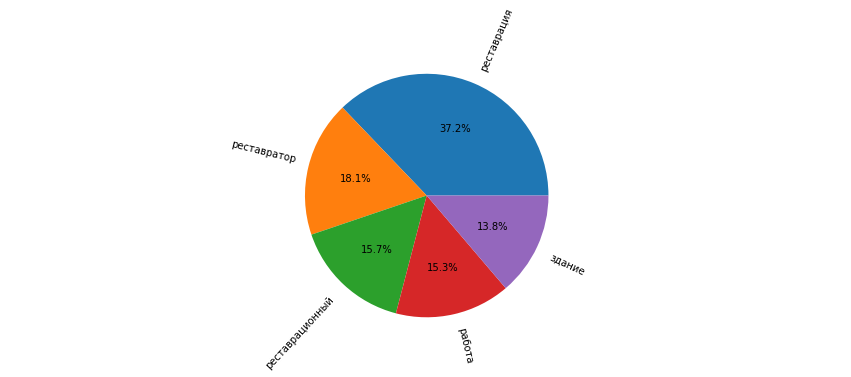

Items count 72
Word реставрация appears zero times 11
Word реставратор appears zero times 34
Word реставрационный appears zero times 37
Word работа appears zero times 7
Word здание appears zero times 37
Word new_page_title appears zero times 0

Роскошь


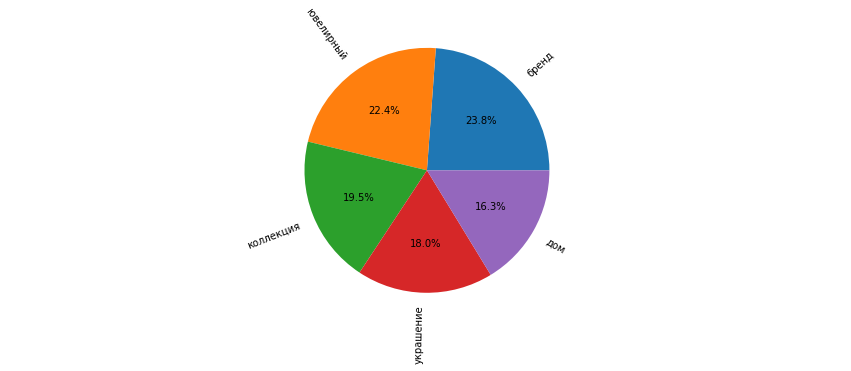

Items count 99
Word бренд appears zero times 40
Word ювелирный appears zero times 61
Word коллекция appears zero times 36
Word украшение appears zero times 66
Word дом appears zero times 40
Word new_page_title appears zero times 0

Спецпроект


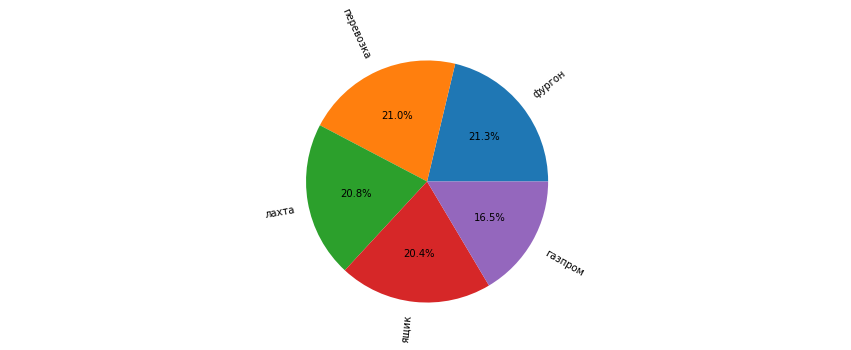

Items count 2
Word фургон appears zero times 1
Word перевозка appears zero times 1
Word лахта appears zero times 1
Word ящик appears zero times 1
Word газпром appears zero times 1
Word new_page_title appears zero times 0

Фестивали


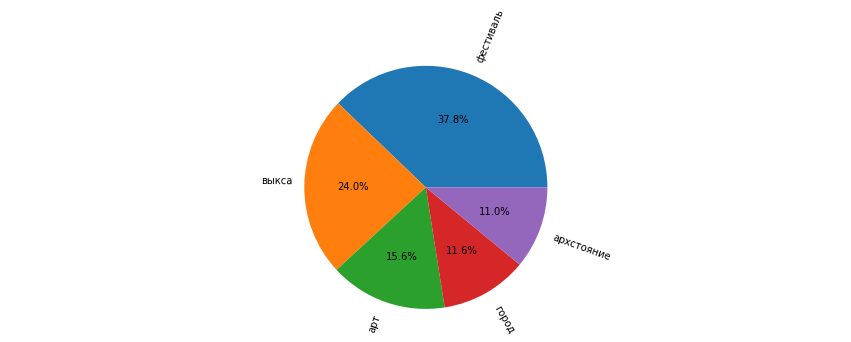

Items count 12
Word фестиваль appears zero times 0
Word выкса appears zero times 7
Word арт appears zero times 1
Word город appears zero times 4
Word архстояние appears zero times 9
Word new_page_title appears zero times 0

Художники


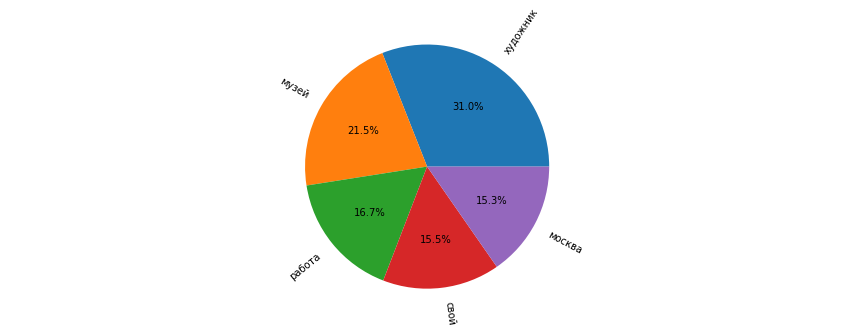

Items count 46
Word художник appears zero times 5
Word музей appears zero times 18
Word работа appears zero times 11
Word свой appears zero times 4
Word москва appears zero times 23
Word new_page_title appears zero times 0

Ярмарки


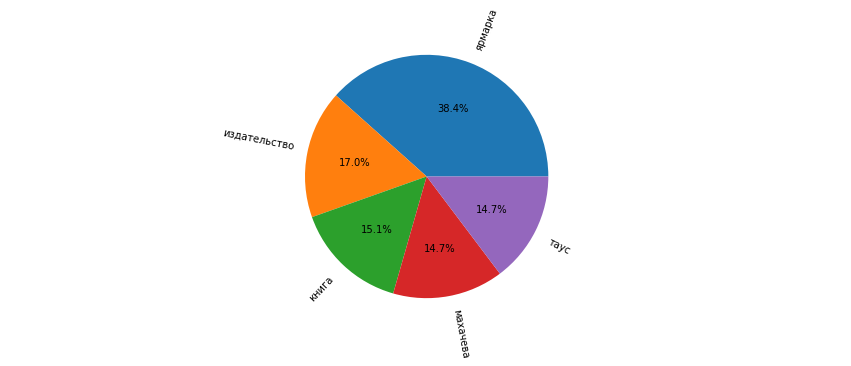

Items count 3
Word ярмарка appears zero times 0
Word издательство appears zero times 1
Word книга appears zero times 1
Word махачева appears zero times 2
Word таус appears zero times 2
Word new_page_title appears zero times 0



In [101]:
for key, value in five_words_dict.items():
  print(key)
  
  words = [k for k in value.keys()]
  rate = [round(v,5) for v in value.values()]
  fig, ax = plt.subplots()
  ax.pie(rate, labels=words, autopct='%1.1f%%', rotatelabels=True)
  ax.axis("equal")
  plt.show()

  words.extend(['new_page_title'])
  df_w = df_dtm_c_vec[df_dtm_c_vec['new_page_title']==key][words]
  print('Items count', df_w['new_page_title'].count())
  for w in words:
    print('Word', w, 'appears zero times', df_w[df_w[w]==0][w].count())
  
  print('')
  #words.extend(['new_page_title'])
  #df_w = df_dtm_c_vec[df_dtm_c_vec['new_page_title']==key][words]
  #print('Items count', df_dtm_c_vec.loc[df_dtm_c_vec['new_page_title']==key].value_counts())
  #df_w[words].hist()

### MiniBatchKMeans: predictions

#### all categories

In [102]:
df_dtm_tfidf_vec_2 = df_dtm_tfidf_vec_.drop('main_word', axis=1)
len(df_dtm_tfidf_vec_2.columns)
# 23508

23508

In [103]:
mbk  = MiniBatchKMeans(n_clusters=40, init='random').fit(df_dtm_tfidf_vec_2)

#n_clusters=8, *, init='k-means++', max_iter=100, batch_size=1024, verbose=0, compute_labels=True, random_state=None,
#tol=0.0, max_no_improvement=10, init_size=None, n_init=3, reassignment_ratio=0.01

y_kmeansMBK = mbk.predict(df_dtm_tfidf_vec_2)
#Num = [] 
Num = [pt for pt in y_kmeansMBK]
#df2 = {"Num_Cluster": [pt for pt in y_kmeansMBK]}
#dfMBK = pd.DataFrame(df2)
#df = pd.concat([dfClaster,dfMBK], axis=1)

print(len(Num))

1234


In [104]:
df_dtm_tfidf_vec_2['new_page_title'] = df_tanp['new_page_title'].tolist()
print(df_dtm_tfidf_vec_2['new_page_title'].nunique())
df_dtm_tfidf_vec_2['cluster_num'] = [pt for pt in y_kmeansMBK]
print(df_dtm_tfidf_vec_2['cluster_num'].nunique())

17
40


In [119]:
file_name = '/df_dtm_tfidf_vec_2_' + str(datetime.now().date()) + '.csv'
save_df_file(df_dtm_tfidf_vec_2, file_name, 'backup')
print(file_name)

/df_dtm_tfidf_vec_2_2022-07-06.csv


In [ ]:
file_name = '/df_dtm_tfidf_vec_2_2022-07-06.csv'
df_dtm_tfidf_vec_2 = open_file_csv(file_name, 'backup')

In [117]:
grouped_clusters = pd.DataFrame(df_dtm_tfidf_vec_2.groupby(['cluster_num'])['new_page_title'].apply(combine_lists))

for idx in grouped_clusters.index:
  print(idx, grouped_clusters.loc[idx]['new_page_title'])

0 ['Интервью']
1 ['Кинофестиваль', 'Новости', 'Выставки', 'Художники', 'Роскошь', 'Музей', 'Интервью']
2 ['Книги', 'Арт-рынок', 'Выставки', 'Художники', 'Роскошь']
3 ['Новости', 'Выставки', 'Художники']
4 ['Книги', 'Мнения', 'Реставрация', 'Новости', 'Выставки', 'Художники', 'Интервью']
5 ['Новости']
6 ['Интервью', 'Выставки']
7 ['Книги', 'Реставрация', 'Новости', 'Выставки', 'Архитектура']
8 ['Книги', 'Арт-рынок', 'Новости', 'Выставки', 'Роскошь']
9 ['Арт-рынок', 'Мнения', 'Новости', 'Выставки', 'Художники', 'Музей', 'Интервью']
10 ['Архитектура', 'Музей', 'Новости', 'Реставрация']
11 ['Роскошь']
12 ['Музей']
13 ['Музей']
14 ['Новости', 'Арт-рынок', 'Выставки', 'Кинофестиваль']
15 ['Книги', 'Арт-рынок', 'Реставрация', 'Новости', 'Выставки', 'Художники']
16 ['Арт-рынок']
17 ['Новости', 'Выставки', 'Фестивали']
18 ['Интервью']
19 ['Арт-рынок', 'Новости', 'Художники', 'Ярмарки', 'Роскошь', 'Интервью']
20 ['Книги', 'Реставрация', 'Новости', 'Выставки', 'Музей', 'Интервью']
21 ['Новости']


In [116]:
for idx in grouped_clusters.index:
  print(df_dtm_tfidf_vec_2[df_dtm_tfidf_vec_2['cluster_num']==idx].groupby(['cluster_num', 'new_page_title'])['new_page_title'].count().sort_values(ascending=False))
  print('')

cluster_num  new_page_title
0            Интервью          1
Name: new_page_title, dtype: int64

cluster_num  new_page_title
1            Кинофестиваль     15
             Выставки           2
             Новости            2
             Интервью           1
             Музей              1
             Роскошь            1
             Художники          1
Name: new_page_title, dtype: int64

cluster_num  new_page_title
2            Роскошь           46
             Выставки           4
             Арт-рынок          3
             Книги              2
             Художники          1
Name: new_page_title, dtype: int64

cluster_num  new_page_title
3            Выставки          6
             Художники         5
             Новости           3
Name: new_page_title, dtype: int64

cluster_num  new_page_title
4            Интервью          10
             Новости            9
             Выставки           5
             Книги              5
             Мнения             2
      

In [128]:
df_dtm_tfidf_vec_3 = df_dtm_tfidf_vec_2.drop(['new_page_title', 'cluster_num'], axis=1)
len(df_dtm_tfidf_vec_3.columns)
# 23508

23508

In [129]:
mbk_2  = MiniBatchKMeans(n_clusters=10, init='random').fit(df_dtm_tfidf_vec_3)

#n_clusters=8, *, init='k-means++', max_iter=100, batch_size=1024, verbose=0, compute_labels=True, random_state=None,
#tol=0.0, max_no_improvement=10, init_size=None, n_init=3, reassignment_ratio=0.01

y_kmeansMBK_2 = mbk_2.predict(df_dtm_tfidf_vec_3)
Num_2 = [pt for pt in y_kmeansMBK_2]
print(len(Num_2))

1234


In [130]:
df_dtm_tfidf_vec_3['new_page_title'] = df_tanp['new_page_title'].tolist()
print(df_dtm_tfidf_vec_3['new_page_title'].nunique())
df_dtm_tfidf_vec_3['cluster_num'] = [pt for pt in y_kmeansMBK_2]
print(df_dtm_tfidf_vec_3['cluster_num'].nunique())

17
10


In [131]:
file_name = '/df_dtm_tfidf_vec_3_' + str(datetime.now().date()) + '.csv'
save_df_file(df_dtm_tfidf_vec_3, file_name, 'backup')
print(file_name)

#file_name = '/df_dtm_tfidf_vec_3_2022-07-06.csv'
#df_dtm_tfidf_vec_3 = open_file_csv(file_name, 'backup')

/df_dtm_tfidf_vec_3_2022-07-06.csv


In [132]:
for cl in df_dtm_tfidf_vec_3['cluster_num'].unique():
  print(df_dtm_tfidf_vec_3[df_dtm_tfidf_vec_3['cluster_num']==cl].groupby(['cluster_num', 'new_page_title'])['new_page_title'].count().sort_values(ascending=False))
  print('')

cluster_num  new_page_title         
5            Реставрация                56
             Новости                    38
             Музей                       6
             Интервью                    2
             Мнения                      2
             Великий Новгород Россия     1
             Выставки                    1
             Книги                       1
Name: new_page_title, dtype: int64

cluster_num  new_page_title  
3            Выставки            233
             Новости             216
             Роскошь              87
             Музей                75
             Арт-рынок            44
             Книги                44
             Художники            42
             Интервью             33
             Фестивали            12
             Мнения               11
             Реставрация           7
             Архитектура           3
             Премии и награды      2
             Ярмарки               2
             Спецпроект            

In [136]:
mbk_2.feature_names_in_

array(['air', 'ar', 'archaeology', ..., 'ёмкий', 'ёмко', 'ёмкость'],
      dtype=object)

#### cut categories

In [18]:
df_dtm_tfidf_vec_4 = df_dtm_tfidf_vec_.copy() # after cutting some categories # 'Новости', 'Интервью', 'Мнения'
print(df_dtm_tfidf_vec_4.shape)

df_tanp_cut = df_tanp.loc[df_tanp['new_page_title'].isin(cut_cat_list)].copy()
print(df_tanp_cut.shape)

(825, 23508)
(825, 36)


In [19]:
mbk  = MiniBatchKMeans(n_clusters=20, init='random').fit(df_dtm_tfidf_vec_4)
#n_clusters=8, *, init='k-means++', max_iter=100, batch_size=1024, verbose=0, compute_labels=True, random_state=None,
#tol=0.0, max_no_improvement=10, init_size=None, n_init=3, reassignment_ratio=0.01
y_kmeansMBK_3 = mbk.predict(df_dtm_tfidf_vec_4)
Num = [pt for pt in y_kmeansMBK_3]
print(len(Num))

825


In [20]:
df_dtm_tfidf_vec_4['new_page_title'] = df_tanp_cut['new_page_title'].tolist()
print(df_dtm_tfidf_vec_4['new_page_title'].nunique())
df_dtm_tfidf_vec_4['cluster_num'] = [pt for pt in y_kmeansMBK_3]
print(df_dtm_tfidf_vec_4['cluster_num'].nunique())

14
20


In [22]:
file_name = '/df_dtm_tfidf_vec_4_' + str(datetime.now().date()) + '.csv'
save_df_file(df_dtm_tfidf_vec_4, file_name, 'backup')
print(file_name)

#file_name = '/df_dtm_tfidf_vec_4_2022-07-08.csv'
#df_dtm_tfidf_vec_4 = open_file_csv(file_name, 'backup')

/df_dtm_tfidf_vec_4_2022-07-08.csv


In [23]:
for cl in df_dtm_tfidf_vec_4['cluster_num'].unique():
  print(df_dtm_tfidf_vec_4[df_dtm_tfidf_vec_4['cluster_num']==cl].groupby(['cluster_num', 'new_page_title'])['new_page_title'].count().sort_values(ascending=False))
  print('')

cluster_num  new_page_title         
10           Выставки                   206
             Музей                       87
             Роскошь                     60
             Книги                       38
             Реставрация                 29
             Художники                   28
             Арт-рынок                   25
             Премии и награды            17
             Архитектура                 12
             Ярмарки                      3
             Великий Новгород Россия      1
             Спецпроект                   1
             Фестивали                    1
Name: new_page_title, dtype: int64

cluster_num  new_page_title
19           Реставрация       4
             Выставки          2
             Книги             1
Name: new_page_title, dtype: int64

cluster_num  new_page_title
6            Реставрация       17
             Музей             10
             Архитектура        3
             Арт-рынок          2
             Выставки       

In [24]:
df_dtm_tfidf_vec_5 = df_dtm_tfidf_vec_.copy() # after cutting some categories # 'Новости', 'Интервью', 'Мнения'
print(df_dtm_tfidf_vec_5.shape)

mbk  = MiniBatchKMeans(n_clusters=14, init='random').fit(df_dtm_tfidf_vec_5)
#n_clusters=8, *, init='k-means++', max_iter=100, batch_size=1024, verbose=0, compute_labels=True, random_state=None,
#tol=0.0, max_no_improvement=10, init_size=None, n_init=3, reassignment_ratio=0.01
y_kmeansMBK_4 = mbk.predict(df_dtm_tfidf_vec_5)
Num = [pt for pt in y_kmeansMBK_4]
print(len(Num))

df_dtm_tfidf_vec_5['new_page_title'] = df_tanp_cut['new_page_title'].tolist()
print(df_dtm_tfidf_vec_5['new_page_title'].nunique())
df_dtm_tfidf_vec_5['cluster_num'] = [pt for pt in y_kmeansMBK_4]
print(df_dtm_tfidf_vec_5['cluster_num'].nunique())

(825, 23508)
825
14
14


In [25]:
file_name = '/df_dtm_tfidf_vec_5_' + str(datetime.now().date()) + '.csv'
save_df_file(df_dtm_tfidf_vec_5, file_name, 'backup')
print(file_name)

#file_name = '/df_dtm_tfidf_vec_5_2022-07-08.csv'
#df_dtm_tfidf_vec_5 = open_file_csv(file_name, 'backup')

/df_dtm_tfidf_vec_5_2022-07-08.csv


In [26]:
for cl in df_dtm_tfidf_vec_5['cluster_num'].unique():
  print(df_dtm_tfidf_vec_5[df_dtm_tfidf_vec_5['cluster_num']==cl].groupby(['cluster_num', 'new_page_title'])['new_page_title'].count().sort_values(ascending=False))
  print('')

cluster_num  new_page_title
11           Музей             31
             Реставрация       30
             Выставки          18
             Архитектура        7
             Книги              5
             Арт-рынок          1
             Спецпроект         1
             Художники          1
Name: new_page_title, dtype: int64

cluster_num  new_page_title  
13           Выставки            203
             Арт-рынок            61
             Книги                39
             Художники            34
             Роскошь              29
             Музей                23
             Кинофестиваль        22
             Премии и награды     18
             Реставрация          11
             Архитектура           6
             Фестивали             3
Name: new_page_title, dtype: int64

cluster_num  new_page_title
1            Реставрация       17
             Выставки           4
             Роскошь            3
             Художники          1
Name: new_page_title, dtype

# tokenizing studies

In [ ]:
# некоторые дополнительные компоненты для сегментации, токенизации 
#nltk.download('punkt')
#nltk.download('averaged_perceptron_tagger')

# загрузка универсального набора тегов
#nltk.download('universal_tagset')

[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package averaged_perceptron_tagger to
[nltk_data]     /root/nltk_data...
[nltk_data]   Package averaged_perceptron_tagger is already up-to-
[nltk_data]       date!
[nltk_data] Downloading package universal_tagset to /root/nltk_data...
[nltk_data]   Package universal_tagset is already up-to-date!


True

In [ ]:
def final_cleaning_1(text):
  #text = text.lower()
  text = re.sub('\[.*?\]', '', text) # brackets
  #text = re.sub('\w*\d\w*', '', text) # numbers
  text = re.sub('[‘’“”«»''""“”„“…№]', '', text) # upper punctuation
  #text = re.sub(' — | – |-', ' ', text)
  #text = re.sub('[%s]' % re.escape(string.punctuation), '', text) #punctuation
  #text = re.sub('[!#$%&()*+,.:;<=>?@^_`{|}~]', '', text) # punctuation
  text = re.sub('[#$%&()*+<=>?^`{|}~]', '', text) # punctuation

  return text

In [ ]:
for name, df in combo_df_dict.items():
  sample_df = df.copy().sample(1)
  print(name)
  print('')
  for col in ['tags_list', 'new_page_title', 'title']: # , 'short_text'
    print(col)
    print('')
    for idx, text in enumerate(sample_df[col]):
      print(idx, type(text), text)
      new_text = final_cleaning_1(' '.join(text))
      text_token = sent_tokenize(new_text, language='russian')
      print(idx, type(text_token), text_token)
    print('')
  for col in ['long_text']: # 'structure', 
    print(col)
    print('')
    for idx, text in enumerate(sample_df[col]): 
      print(idx, type(text))
      for el in text:
        print(idx, type(el), el)
        new_el = final_cleaning_1(' '.join(el))
        el_token = sent_tokenize(new_el, language='russian')
        print(idx, type(el_token), el_token)
      print('')

#sent_tokenize(text, language='russian')
#word_tokenize(text, language='russian')

/artinvest_long_text.csv

tags_list

0 <class 'list'> []
0 <class 'list'> []

new_page_title

0 <class 'str'> Арт-рынок
0 <class 'list'> ['А р т - р ы н о к']

title

0 <class 'str'> Открыты 192-е торги AI Аукциона
0 <class 'list'> ['О т к р ы т ы   1 9 2 - е   т о р г и   A I   А у к ц и о н а']

long_text

0 <class 'list'>
0 <class 'str'> Открыты 192-е торги AI Аукциона.
0 <class 'list'> ['О т к р ы т ы   1 9 2 - е   т о р г и   A I   А у к ц и о н а .']
0 <class 'str'> Каталог AI Аукциона № 192.
0 <class 'list'> ['К а т а л о г   A I   А у к ц и о н а      1 9 2 .']
0 <class 'str'> Избранные лоты AI Аукциона № 192.
0 <class 'list'> ['И з б р а н н ы е   л о т ы   A I   А у к ц и о н а      1 9 2 .']
0 <class 'str'> Открывает описание каталога традиционно пейзажный стринг, а в нем — необыкновенной красоты масло «Парк в Павловске» (1908) Николая Петровича Крымова. Всё происходит где-то вдали: там слышны звуки духового паркового оркестра, крутится карусель, блики света скользят по воде

In [ ]:
texts_part = 'Два натюрморта в каталоге находятся в буквальном смысле на разных эмоциональных полюсах. На одном из них — «Сундук» (1990-е) современного художника Юрия Леонидовича Купера — вещь многоплановая, выполненная на фанере в смешанной технике, с использованием проволоки, гвоздей и т. д. По сути — приземленная (что может быть более чуждым возвышенных, духовных стремлений, чем сундук?), по восприятию — красивая, объемная, по-куперовски мерцающая.'
texts_part

'Два натюрморта в каталоге находятся в буквальном смысле на разных эмоциональных полюсах. На одном из них — «Сундук» (1990-е) современного художника Юрия Леонидовича Купера — вещь многоплановая, выполненная на фанере в смешанной технике, с использованием проволоки, гвоздей и т. д. По сути — приземленная (что может быть более чуждым возвышенных, духовных стремлений, чем сундук?), по восприятию — красивая, объемная, по-куперовски мерцающая.'

In [ ]:
# применение маркера слова к текстовой строке и нахождение тега POS
#nltk.pos_tag(word_tokenize(texts_part), tagset='universal')

In [ ]:
for el in morph.parse(word_tokenize(texts_part)[0]):
  print(el)

Parse(word='два', tag=OpencorporaTag('NUMR masc,nomn'), normal_form='два', score=0.4, methods_stack=((DictionaryAnalyzer(), 'два', 1308, 0),))
Parse(word='два', tag=OpencorporaTag('NUMR inan,masc,accs'), normal_form='два', score=0.2, methods_stack=((DictionaryAnalyzer(), 'два', 1308, 3),))
Parse(word='два', tag=OpencorporaTag('NUMR neut,nomn'), normal_form='два', score=0.2, methods_stack=((DictionaryAnalyzer(), 'два', 1308, 9),))
Parse(word='два', tag=OpencorporaTag('NUMR inan,neut,accs'), normal_form='два', score=0.2, methods_stack=((DictionaryAnalyzer(), 'два', 1308, 10),))


In [ ]:
for w in word_tokenize(texts_part):
  print(morph.parse(w)[0].word, '->', morph.parse(w)[0].tag, morph.parse(w)[0].normal_form, morph.parse(w)[0].score) # the highest score

два -> NUMR masc,nomn два 0.4
натюрморта -> NOUN,inan,masc sing,gent натюрморт 1.0
в -> PREP в 0.999327
каталоге -> NOUN,inan,masc sing,loct каталог 1.0
находятся -> VERB,impf,intr plur,3per,pres,indc находиться 0.954545
в -> PREP в 0.999327
буквальном -> ADJF,Qual masc,sing,loct буквальный 0.882352
смысле -> NOUN,inan,masc sing,loct смысл 1.0
на -> PREP на 0.998961
разных -> ADJF,Qual plur,gent разный 0.6
эмоциональных -> ADJF,Qual plur,gent эмоциональный 0.777777
полюсах -> NOUN,inan,masc plur,loct полюс 1.0
. -> PNCT . 1.0
на -> PREP на 0.998961
одном -> ADJF,Apro,Anum masc,sing,loct один 0.61574
из -> PREP из 0.999673
них -> NPRO,3per,Anph plur,gent,Af-p они 0.739745
— -> PNCT — 1.0
« -> PNCT « 1.0
сундук -> NOUN,inan,masc sing,accs сундук 0.8
» -> PNCT » 1.0
( -> PNCT ( 1.0
1990-е -> ADJF,Abbr,Anum neut,sing,nomn 1990-й 0.25
) -> PNCT ) 1.0
современного -> ADJF,Qual neut,sing,gent современный 0.8
художника -> NOUN,anim,masc sing,gent художник 0.888888
юрия -> NOUN,anim,masc,Name s

# words' scoring

In [ ]:
def print_stat(w_dict, df):
  print('Count of unique words:', len(w_dict))
  print('Minimum of unique word frequency:', min([v for v in w_dict.values()]))
  print('Maximum of unique word frequency:', max([v for v in w_dict.values()]))
  print('Average of unique word frequency:', int(round(s.mean([v for v in w_dict.values()]), 0)))
  print('Median of unique word frequency:', int(round(s.median([v for v in w_dict.values()]), 0)))
  print('Mode of unique word frequency:', s.mode([v for v in w_dict.values()]))
  print('Quantiles of unique word frequency:', [int(round(q, 0)) for q in np.percentile([v for v in w_dict.values()], [25, 50, 75])])
  print('')

  print('Average of long text words count', int(round(df['long_text_tok_len'].mean(), 0)))
  uniques_in_line = []
  for line in df['long_text_tok_new'].tolist():
    uniques_in_line.append(len(set(line)))
  print('Average of long text unique words count', int(round(s.mean(uniques_in_line), 0)))
  print('')

  fig, axes = plt.subplots(1, 2, figsize=(12,4))
  
  axes[0].hist(df['long_text_tok_len'])
  axes[0].set_title('long text words count')

  axes[1].hist(uniques_in_line)
  axes[1].set_title('long text unique words count')

In [ ]:
def reduced_text(text):
  for word in text:
    if word in most_common_list or word in less_common_list:
      text.remove(word)     
  return text


def combine_text(list_of_text):
    '''Takes a list of text and combines them into one large chunk of text.'''
    combined_text = ' '.join(list_of_text)#.split(' ')
    return combined_text

In [ ]:
from wordcloud import WordCloud
import matplotlib.pyplot as plt

In [ ]:
from sklearn.feature_extraction.text import CountVectorizer, TfidfVectorizer


# Create a Vectorizer Object
c_vec = CountVectorizer()
''' *, input="content", encoding="utf-8", decode_error="strict", strip_accents=None, lowercase=True, preprocessor=None, 
tokenizer=None, stop_words=None, token_pattern=r"(?u)\b\w\w+\b", ngram_range=(1, 1), analyzer="word", max_df=1, min_df=1, 
max_features=None, vocabulary=None, binary=False, dtype=np.int64 '''

tfidf_vec = TfidfVectorizer()
''' *, input="content", encoding="utf-8", decode_error="strict", strip_accents=None, lowercase=True, preprocessor=None, 
tokenizer=None, analyzer="word", stop_words=None, token_pattern=r"(?u)\b\w\w+\b", ngram_range=(1, 1), max_df=1, min_df=1, 
max_features=None, vocabulary=None, binary=False, dtype=np.float64, norm="l2", use_idf=True, smooth_idf=True, sublinear_tf=False '''


def by_value(item):
  return item[1]

## tanp Counter

In [ ]:
df_tanp_cut = df_tanp[['new_page_title', 'long_text_tok_new', 'long_text_tok_len']]

df_tanp_cut.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1234 entries, 0 to 1233
Data columns (total 3 columns):
 #   Column             Non-Null Count  Dtype 
---  ------             --------------  ----- 
 0   new_page_title     1234 non-null   object
 1   long_text_tok_new  1234 non-null   object
 2   long_text_tok_len  1234 non-null   int64 
dtypes: int64(1), object(2)
memory usage: 29.0+ KB


In [ ]:
words_dict_tanp_total = collections.Counter() # {word: its frequency}

for line in df_tanp_cut['long_text_tok_new'].tolist():
  for word in line:
    words_dict_tanp_total[word] += 1
  
print('unique words count', len(words_dict_tanp_total))

unique words count 39556


Count of unique words: 39556
Minimum of unique word frequency: 1
Maximum of unique word frequency: 7919
Average of unique word frequency: 15
Median of unique word frequency: 2
Mode of unique word frequency: 1
Quantiles of unique word frequency: [1, 2, 6]

Average of long text words count 471
Average of long text unique words count 312



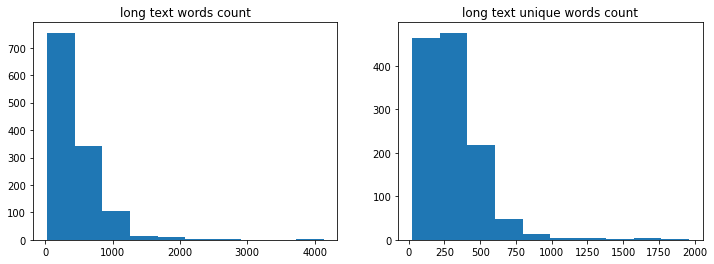

In [ ]:
print_stat(words_dict_tanp_total, df_tanp_cut)

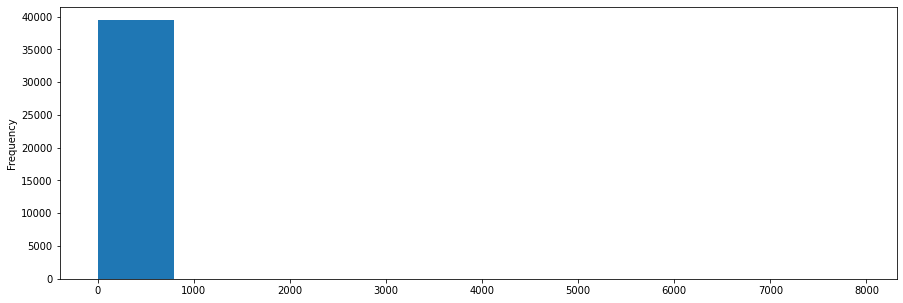

In [ ]:
pd.Series([v for v in words_dict_tanp_total.values()]).plot(kind = 'hist') # {word: its frequency}

In [ ]:
most_common_list = [k for k, v in words_dict_tanp_total.items() if v >= df_tanp_cut['long_text_tok_new'].count()] # Total count of documents
less_common_list = [k for k, v in words_dict_tanp_total.items() if v < 2] # Median of unique word frequency

print('most common words count', len(most_common_list))
print('less common words count', len(less_common_list))

most common words count 29
less common words count 16873


In [ ]:
most_common_list

['свой',
 'первый',
 'век',
 'самый',
 'который',
 'мочь',
 'проект',
 'год',
 'всё',
 'это',
 'новый',
 'время',
 'ещё',
 'работа',
 'художник',
 'искусство',
 'стать',
 'весь',
 'современный',
 'музей',
 'выставка',
 'галерея',
 'произведение',
 'история',
 'русский',
 'коллекция',
 'картина',
 'также',
 'человек']

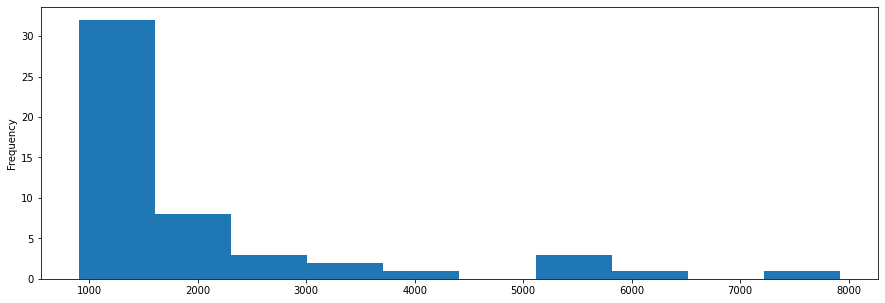

In [ ]:
pd.Series([v for v in words_dict_tanp_total.values() if v >= 900]).plot(kind = 'hist') # {word: its frequency}
# 900 times is a frequency for more than 30 words

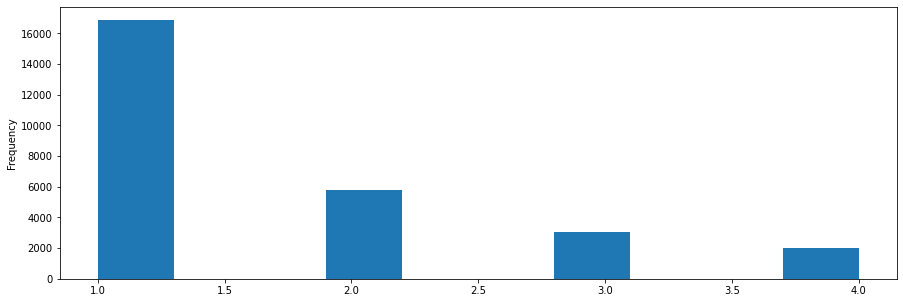

In [ ]:
pd.Series([v for v in words_dict_tanp_total.values() if v < 5]).plot(kind = 'hist') # {word: its frequency}
# 1 time is a frequency for more than 16000 words
# 4 times is a frequency for less than 2000 words

In [ ]:
print('documents count', df_tanp_cut['long_text_tok_new'].count())
print('average of long text words count', int(round(df_tanp_cut['long_text_tok_len'].mean(), 0)))
print('unique words count', len(words_dict_tanp_total))

documents count 1234
average of long text words count 471
unique words count 39556


In [ ]:
uniques_in_line = []
for line in df_tanp_cut['long_text_tok_new'].tolist():
  uniques_in_line.append(len(set(line)))

print('documents count', len(uniques_in_line))
print('average of long text unique words count', int(round(s.mean(uniques_in_line), 0)))

documents count 1234
average of long text unique words count 312


In [ ]:
most_common_list = [k for k, v in words_dict_tanp_total.items() if v >= 900] # end of vizual body
less_common_list = [k for k, v in words_dict_tanp_total.items() if v < 2] # Median of unique word frequency

print('most common words count', len(most_common_list))
print('less common words count', len(less_common_list))

most common words count 51
less common words count 16873


In [ ]:
df_tanp_cut['long_text_tok_cut'] = df_tanp_cut['long_text_tok_new'].dropna().apply(reduced_text)

print('documents count', df_tanp_cut['long_text_tok_cut'].count())

uniques_in_line = []
for line in df_tanp_cut['long_text_tok_cut'].tolist():
  uniques_in_line.append(len(set(line)))

print('average of long text unique words count', int(round(s.mean(uniques_in_line), 0)))

documents count 1234
average of long text unique words count 285


In [ ]:
# Let's combine long_text_tok_new 
df_tanp_cut['long_text_tok_cut'] = df_tanp_cut['long_text_tok_cut'].dropna().apply(lambda x: ' '.join(x))

df_grouped = pd.DataFrame(df_tanp_cut.groupby(['new_page_title'])['long_text_tok_cut'].apply(combine_text)) # .dropna()
df_grouped

,long_text_tok_cut
new_page_title,
COVID-19,умереть ричард фейген великий продавец старый ...
NFT,взять будущее ярмарка обсудить потенциал техно...
Арт-рынок,триптих фрэнсис бэкон соединять политика личны...
Выставки,тамара вехов кочейшвили вне мода тренд доме-му...
Интервью,борис орлов пограничный ситуация переживать ка...
Книги,апокалипсис дюрер впервые воспроизвести полнос...
Мнения,переломный момент превращаться автор текст але...
Музей,подземный грот английский поэт александр поупа...
Новости,церемония вручение премия пройти московский ма...


In [ ]:
# Let's make some word clouds
wc = WordCloud(background_color="white", colormap="Dark2",
               max_font_size=150, random_state=42)

categories = df_grouped.index

plt.rcParams['figure.figsize'] = [15, 5]

# Create subplots for each genre
for index, category in enumerate(categories):
    wc.generate(df_grouped.long_text_tok_cut[category])
    
    plt.imshow(wc, interpolation="bilinear")
    plt.axis("off")
    plt.title(categories[index], fontsize = 15)
    plt.show()

In [ ]:
df_tanp['new_page_title'].unique()

array(['Музей', 'Интервью', 'Выставки', 'Новости', 'Роскошь', 'Арт-рынок',
       'События и выставки', 'Промо', 'Статьи', 'Персоналии', 'COVID-19',
       'Путешествие', 'Мнения', 'Книги', 'NFT', 'Премии и награды'],
      dtype=object)

In [ ]:
words_dict_tanp_page = {}

for page in df_tanp['new_page_title'].unique():
  words_dict = collections.Counter() # {word: its frequency}
  for line in df_tanp[df_tanp['new_page_title']==page]['long_text_tok_new'].tolist():
    for word in line:
      words_dict[word] += 1
  words_dict_tanp_page.update({page: words_dict})

len(words_dict_tanp_page)

16

In [ ]:
for page in df_tanp['new_page_title'].unique():
  print(page, end='\n')
  print_stat(words_dict_tanp_page[page])
  print('', end='\n\n')

Музей
Count of unique words: 10772
Minimum of unique words count: 1
Maximum of unique words count: 1142
Average of unique words count: 5
Median of unique words count: 2
Mode of unique words count: 1
Quantiles of unique words count: [1, 2, 4]


Интервью
Count of unique words: 8393
Minimum of unique words count: 1
Maximum of unique words count: 806
Average of unique words count: 5
Median of unique words count: 1
Mode of unique words count: 1
Quantiles of unique words count: [1, 1, 3]


Выставки
Count of unique words: 15799
Minimum of unique words count: 1
Maximum of unique words count: 1454
Average of unique words count: 6
Median of unique words count: 2
Mode of unique words count: 1
Quantiles of unique words count: [1, 2, 4]


Новости
Count of unique words: 22266
Minimum of unique words count: 1
Maximum of unique words count: 3208
Average of unique words count: 9
Median of unique words count: 2
Mode of unique words count: 1
Quantiles of unique words count: [1, 2, 5]


Роскошь
Count of u

In [ ]:
tanp_top_dict = {}

In [ ]:
for page in df_tanp['new_page_title'].unique():
  page_dict = {k: v for k, v in words_dict_tanp_page[page].items() if v >= 100}
  tanp_top_dict.update({page: [k for k in page_dict.keys()]})

print(len(tanp_top_dict))

for k, v in tanp_top_dict.items():
  print(k, '->', len(v))

16
Музей -> 53
Интервью -> 31
Выставки -> 86
Новости -> 308
Роскошь -> 19
Арт-рынок -> 42
События и выставки -> 7
Промо -> 2
Статьи -> 1
Персоналии -> 0
COVID-19 -> 1
Путешествие -> 4
Мнения -> 3
Книги -> 7
NFT -> 0
Премии и награды -> 0


In [ ]:
tanp_top_dict['Книги']

['автор', 'книга', 'год', 'который', 'это', 'художник', 'искусство']

In [ ]:
page_dict = {k: v for k, v in words_dict_tanp_page['События и выставки'].items() if v >= 15}
tanp_top_dict.update({'События и выставки': [k for k in page_dict.keys()]})

page_dict = {k: v for k, v in words_dict_tanp_page['Промо'].items() if v >= 10}
tanp_top_dict.update({'Промо': [k for k in page_dict.keys()]})

page_dict = {k: v for k, v in words_dict_tanp_page['Статьи'].items() if v >= 15}
tanp_top_dict.update({'Статьи': [k for k in page_dict.keys()]})

page_dict = {k: v for k, v in words_dict_tanp_page['Персоналии'].items() if v >= 10}
tanp_top_dict.update({'Персоналии': [k for k in page_dict.keys()]})

page_dict = {k: v for k, v in words_dict_tanp_page['COVID-19'].items() if v >= 10}
tanp_top_dict.update({'COVID-19': [k for k in page_dict.keys()]})

page_dict = {k: v for k, v in words_dict_tanp_page['Путешествие'].items() if v >= 20}
tanp_top_dict.update({'Путешествие': [k for k in page_dict.keys()]})

page_dict = {k: v for k, v in words_dict_tanp_page['Мнения'].items() if v >= 15}
tanp_top_dict.update({'Мнения': [k for k in page_dict.keys()]})

page_dict = {k: v for k, v in words_dict_tanp_page['Книги'].items() if v >= 25}
tanp_top_dict.update({'Книги': [k for k in page_dict.keys()]})

page_dict = {k: v for k, v in words_dict_tanp_page['NFT'].items() if v >= 10}
tanp_top_dict.update({'NFT': [k for k in page_dict.keys()]})

page_dict = {k: v for k, v in words_dict_tanp_page['Премии и награды'].items() if v >= 10}
tanp_top_dict.update({'Премии и награды': [k for k in page_dict.keys()]})

print(len(tanp_top_dict))
for k, v in tanp_top_dict.items():
  print(k, '->', len(v))

16
Музей -> 53
Интервью -> 31
Выставки -> 86
Новости -> 308
Роскошь -> 19
Арт-рынок -> 42
События и выставки -> 128
Промо -> 125
Статьи -> 77
Персоналии -> 32
COVID-19 -> 81
Путешествие -> 83
Мнения -> 97
Книги -> 84
NFT -> 39
Премии и награды -> 34


Новости

Count of unique words: 22266
Minimum of unique words count: 1
Maximum of unique words count: 3208
Average of unique words count: 9
Median of unique words count: 2
Mode of unique words count: 1
Quantiles of unique words count: [1, 2, 5]




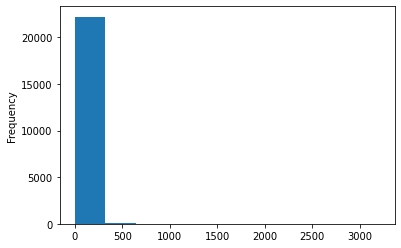

In [ ]:
page = df_tanp['new_page_title'].unique()[3]

print(page, end='\n\n')
print_stat(words_dict_tanp_page[page])
print('', end='\n\n')
pd.Series([v for v in words_dict_tanp_page[page].values()]).plot(kind = 'hist') # {word: its frequency}

Новости



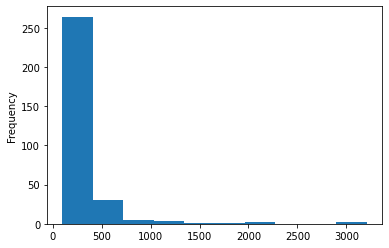

In [ ]:
print(page, end='\n\n')
pd.Series([v for v in words_dict_tanp_page[page].values() if v >= 100]).plot(kind = 'hist') # {word: its frequency}

Новости



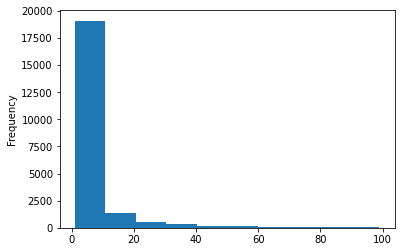

In [ ]:
print(page, end='\n\n')
pd.Series([v for v in words_dict_tanp_page[page].values() if v < 100]).plot(kind = 'hist') # {word: its frequency}

Новости



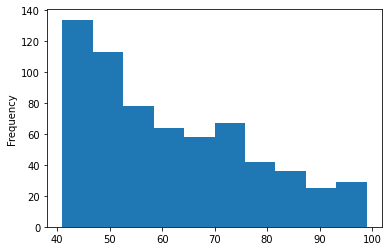

In [ ]:
print(page, end='\n\n')
pd.Series([v for v in words_dict_tanp_page[page].values() if v > 40 and v < 100]).plot(kind = 'hist') # {word: its frequency}

In [ ]:
print(page, end='\n\n')
page_dict = {k: v for k, v in words_dict_tanp_page[page].items() if v >= 100}
print(len(page_dict), end='\n\n')
sorted(page_dict.items(), key=by_value, reverse=True)

Музей

53



[('музей', 1142),
 ('год', 901),
 ('это', 575),
 ('который', 574),
 ('работа', 340),
 ('проект', 298),
 ('выставка', 295),
 ('искусство', 290),
 ('новый', 286),
 ('реставрация', 264),
 ('здание', 250),
 ('весь', 241),
 ('свой', 226),
 ('всё', 220),
 ('время', 218),
 ('стать', 217),
 ('мочь', 185),
 ('человек', 175),
 ('первый', 171),
 ('галерея', 171),
 ('век', 166),
 ('самый', 162),
 ('музейный', 162),
 ('наш', 155),
 ('художник', 153),
 ('ещё', 150),
 ('посетитель', 145),
 ('говорить', 143),
 ('современный', 141),
 ('центр', 137),
 ('коллекция', 135),
 ('дом', 128),
 ('число', 127),
 ('большой', 127),
 ('государственный', 125),
 ('день', 121),
 ('экспозиция', 121),
 ('фонд', 119),
 ('место', 119),
 ('млн', 117),
 ('также', 116),
 ('история', 116),
 ('часть', 114),
 ('сделать', 114),
 ('культура', 109),
 ('произведение', 109),
 ('директор', 107),
 ('объект', 105),
 ('создать', 103),
 ('работать', 103),
 ('пространство', 103),
 ('скульптура', 103),
 ('мир', 101)]

In [ ]:
print(len(tanp_top_dict))
for k, v in tanp_top_dict.items():
  print(k, '->', len(v))

16
Музей -> 53
Интервью -> 31
Выставки -> 86
Новости -> 308
Роскошь -> 19
Арт-рынок -> 42
События и выставки -> 128
Промо -> 125
Статьи -> 77
Персоналии -> 32
COVID-19 -> 81
Путешествие -> 83
Мнения -> 97
Книги -> 84
NFT -> 39
Премии и награды -> 34


In [ ]:
compare_dict = {}

for key, value in tanp_top_dict.items():

  all_top_words_list = []
  for k, v in tanp_top_dict.items():
    if k != key:
      all_top_words_list.extend(v)

  compare_dict.update({key: {'common': list(set(value) & set(all_top_words_list)), 'unique': list(set(value) - set(all_top_words_list))}})

len(compare_dict)

16

In [ ]:
for k, v in compare_dict.items():
  print(k, '-> common:', len(v['common']), '-> unique:', len(v['unique']))

Музей -> common: 53 -> unique: 0
Интервью -> common: 31 -> unique: 0
Выставки -> common: 86 -> unique: 0
Новости -> common: 204 -> unique: 104
Роскошь -> common: 17 -> unique: 2
Арт-рынок -> common: 40 -> unique: 2
События и выставки -> common: 117 -> unique: 11
Промо -> common: 99 -> unique: 26
Статьи -> common: 64 -> unique: 13
Персоналии -> common: 26 -> unique: 6
COVID-19 -> common: 59 -> unique: 22
Путешествие -> common: 68 -> unique: 15
Мнения -> common: 87 -> unique: 10
Книги -> common: 77 -> unique: 7
NFT -> common: 35 -> unique: 4
Премии и награды -> common: 29 -> unique: 5


In [ ]:
for key, value in compare_dict.items():
  print(key, '->', value['unique'])

Музей -> []
Интервью -> []
Выставки -> []
Новости -> ['начаться', 'конкурс', 'сторона', 'решение', 'рф', 'регион', 'найти', 'пандемия', 'франция', 'кроме', 'около', 'анна', 'шедевр', 'общий', 'вернуться', 'проблема', 'стена', 'вещь', 'выставочный', 'бюро', 'качество', 'заниматься', 'павильон', 'принять', 'из-за', 'решить', 'совет', 'использовать', 'считать', 'средство', 'лондон', 'михаил', 'третьяковский', 'назвать', 'март', 'будущее', 'участник', 'процесс', 'министерство', 'деятельность', 'французский', 'посещаемость', 'помощь', 'ноябрь', 'церемония', 'представитель', 'передать', 'авангард', 'остаться', 'открыться', 'результат', 'рейтинг', 'появиться', 'школа', 'провести', 'реконструкция', '-летие', 'американский', 'национальный', 'назад', 'впервые', 'британский', 'поздний', 'венеция', 'музей-заповедник', 'публика', 'жить', 'алексей', 'санкт-петербург', 'объявить', 'участие', 'группа', 'изобразительный', 'частный', 'война', 'начать', 'личный', 'состояться', 'апрель', 'генеральный', 'и

# ...

In [ ]:
#import nltk
#from nltk.corpus import stopwords
#from string import punctuation

#russian_stopwords = stopwords.words("russian")

#text = "Ты не забывай, что у меня в голове опилки. Длинные слова меня только огорчают!"
#tokens = nltk.word_tokenize(text.lower())
#tokens = [token for token in tokens if token not in russian_stopwords and token not in punctuation]


# BUT !!!!!!!!

#from nltk.tokenize import TreebankWordTokenizer

#s = '''Good muffins cost $3.88\nin New York.  Please buy me\ntwo of them.\nThanks.'''
#TreebankWordTokenizer().tokenize(s)
#['Good', 'muffins', 'cost', '$', '3.88', 'in', 'New', 'York.', 'Please', 'buy', 'me', 'two', 'of', 'them.', 'Thanks', '.']

#s = "They'll save and invest more."
#TreebankWordTokenizer().tokenize(s)
#['They', "'ll", 'save', 'and', 'invest', 'more', '.']

#s = "hi, my name can't hello,"
#TreebankWordTokenizer().tokenize(s)
#['hi', ',', 'my', 'name', 'ca', "n't", 'hello', ',']


#from nltk.tokenize import WordPunctTokenizer # by re.expr.: \w+|[^\w\s]+
#s = "Good muffins cost $3.88\nin New York.  Please buy me\ntwo of them.\n\nThanks."
#WordPunctTokenizer().tokenize(s)
#['Good', 'muffins', 'cost', '$', '3', '.', '88', 'in', 'New', 'York',
#'.', 'Please', 'buy', 'me', 'two', 'of', 'them', '.', 'Thanks', '.']


#all_words = nltk.FreqDist(all_words)
#print(all_words.most_common(15))
#print(all_words["stupid"])
#word_features = list(all_words.keys())[:3000]

Прочие классы: https://nlpub.ru/NLTK
- nltk.tokenize.PunktSentenceTokenizer - Класс, разбивающий текст на предложения, к которому под капотом обращается функция nltk.sent_tokenize. Использует алгоритм без учителя для построения модели сокращённых слов, словосочетаний и слов, начинающих предложения, а затем использует эту модель для поиска границ предложений.
- nltk.tokenize.TreebankWordTokenizer - Класс используется для разделения предложений на слова и вызывается под капотом в функции nltk.word_tokenize. Он предполагает, что текст уже был разделён на предложения и выполняет следующие шаги:
  - Разделяет стандартные сокращения, например don't -> do n't and they'll -> they 'll
  - Рассматривает большинство знаков препинания как отдельные токены
  - Отделяет запятые и одинарные кавычки, если за ними следует пробел
  - Отделяет точки в конце предложений
- nltk.tokenize.TweetTokenizer - Токенизатор для твитов (не удаляет хэштеги и знаки пунктуации).
- nltk.tokenize.MWETokenizer - Принимает текст, который уже был разбит на токены и объединяет выражения из нескольких слов в один токен, используя словарь.
- nltk.tokenize.TextTilingTokenizer - Используется для разделения текста на абзацы.
- nltk.tokenize.StanfordTokenizer - Интерфейс для Stanford Tokenizer (работает только с английским языком).
- nltk.tokenize.WordPunctTokenizer - Разделяет текст на последовательности алфавитных и неалфавитных символов с помощью регулярного выражения \w+|[^\w\s]+.
- nltk.tokenize.RegexpTokenizer — разделяет текст с помощью регулярного выражения, которое необходимо самостоятельно задать.
- nltk.tokenize.SExprTokenizer — разделяет текст, состоящий из S-выражений.
- nltk.tokenize.SpaceTokenizer — разделяет токены по пробелам аналогично s.split(' ').
- nltk.tokenize.TabTokenizer — разделяет токены по символам табуляции аналогично s.split('\t').
- nltk.tokenize.LineTokenizer — разделяет токены по символам переноса строки аналогично s.split('\n').
- nltk.tokenize.WhitespaceTokenizer — разделяет токены по символам пробела, табуляции или переноса строки аналогично s.split().
- nltk.tokenize.BlanklineTokenizer — разделяет токены используя в качестве разделителя любые последовательности пробелов и табуляций.

https://nlpub.ru/SpaCy

# ...

In [ ]:
save_df_file(theartnewspaper_w_text, theartnewspaper_w.replace('.csv', '') + '_' + str(datetime.now().date()) + '.csv', 'backup')
save_df_file(artuzel_news_articles_w_text, artuzel_w.replace('.csv', '') + '_' + str(datetime.now().date()) + '.csv', 'backup')
save_df_file(artchive_news_articles_w_text, artchive_w.replace('.csv', '') + '_' + str(datetime.now().date()) + '.csv', 'backup')
save_df_file(artinvest_news_articles_w_text, artinvest_w.replace('.csv', '') + '_' + str(datetime.now().date()) + '.csv', 'backup')

# What to try
1. Word2Vec (https://python-school.ru/blog/word2vec-with-examples-in-gensim/ https://habr.com/ru/post/446530/)
2. t-sne is a model (https://habr.com/ru/post/267041/ https://distill.pub/2016/misread-tsne/)
2. try CountVectorizer
3. try TfidfVectorizer (TF-IDF) + метод «локтя»
4. PCA
5. visualization of words
6. GloVe or CoVe vs Word2Vec
7. CNNs for Sentence Classification (https://habr.com/ru/company/antiplagiat/blog/418173/)


**Оценка (скоринг) слов**

Когда создан словарь, следует оценить наличие слов. Мы уже рассматривали простой, бинарный подход (1 – есть слово, 0 – нет слова).

Есть и другие методы:
1. Количество. Подсчитывается, сколько раз каждое слово встречается в документе.
2. Частотность. Подсчитывается, как часто каждое слово встречается в тексте (по отношению к общему количеству слов). **TF-IDF**

**Models for russian lang.**
- https://rusvectores.org/ru/models/
- https://fasttext.cc/docs/en/crawl-vectors.html (https://www.kaggle.com/code/ibecks/very-fast-train-infer-without-transformers)
- https://jalammar.github.io/illustrated-bert/ (https://www.kaggle.com/code/itslek/fine-tuning-bert-ludwig-sf-nlp-movie-genre)
- https://www.kaggle.com/code/itslek/simple-lstm-sf-nlp-movie-genre-v1-5

**Pretrained embeddings**
- http://docs.deeppavlov.ai/en/master/features/pretrained_vectors.html

In [ ]:
'''
With titles - Multi-Genre NLI (MNLI) - https://huggingface.co/tasks/text-classification

Example 1:
Premise: A man inspects the uniform of a figure in some East Asian country.
Hypothesis: The man is sleeping.
Label: Contradiction

Example 2:
Premise: Soccer game with multiple males playing.
Hypothesis: Some men are playing a sport.
Label: Entailment


from transformers import pipeline

classifier = pipeline("text-classification", model = "roberta-large-mnli")
classifier("A soccer game with multiple males playing. Some men are playing a sport.")
## [{'label': 'ENTAILMENT', 'score': 0.98}]
'''

'\nWith titles - Multi-Genre NLI (MNLI) - https://huggingface.co/tasks/text-classification\n\nExample 1:\nPremise: A man inspects the uniform of a figure in some East Asian country.\nHypothesis: The man is sleeping.\nLabel: Contradiction\n\nExample 2:\nPremise: Soccer game with multiple males playing.\nHypothesis: Some men are playing a sport.\nLabel: Entailment\n\n\nfrom transformers import pipeline\n\nclassifier = pipeline("text-classification", model = "roberta-large-mnli")\nclassifier("A soccer game with multiple males playing. Some men are playing a sport.")\n## [{\'label\': \'ENTAILMENT\', \'score\': 0.98}]\n'